In [64]:
# %%time
## Just an easy way to load utility functions
dataset_name = "W19_only"
df_list = []

%matplotlib inline 
%run f2f_header.py {dataset_name} {df_list}

global BES_label_list, BES_df_list

# %run f2f_utility.py

BES_df_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_df_list.pickle", "rb" ) )
# f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised.zip", compression='zip')
BES_label_list = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\BES_label_list.pickle", "rb" ) )
demo_var_dict = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "rb" ) )
var_type_dict_nonans = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\var_type_dict_nonans.pickle", "rb" ) )

f2f_harmonised = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised_temp.zip", compression='zip')


generic_cols = f2f_harmonised.columns
list_of_scale_harm_vars = ["Age","year_past_min_sch_leave_age","in_school_past_min_age"]



## BUGS

BES_label_list["1959"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1964"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1966"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'
BES_label_list["1970"]["v1236"] = 'LOCAL ELECTION VOTE 1963(2nd)'

BES_label_list["2015"]['edlevel'] = 'Education level (summary)'

Toggle code

<Figure size 640x480 with 0 Axes>

In [65]:
weights = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\weights.zip", compression='zip')
f2f_harmonised["wt"] = weights["wt_vote"]

In [66]:
values = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\f2f_harmonised_values.zip", compression='zip')
f2f_harmonised[values.columns]=values

,inc_det,inc_norm,inc_norm_wt
inc_det,1.000000,0.928029,0.860604
inc_norm,0.928029,1.000000,0.945883
inc_norm_wt,0.860604,0.945883,1.000000


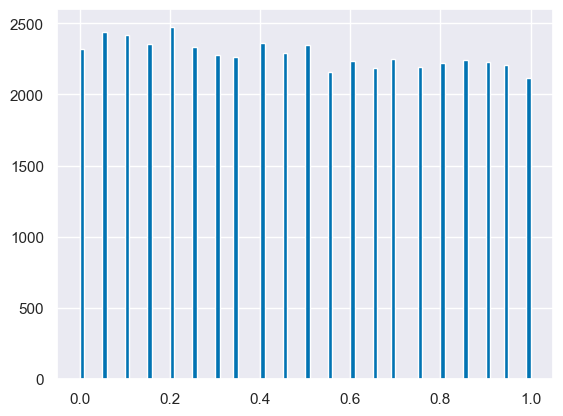

In [67]:
wt_means = f2f_harmonised.groupby("dataset")["wt"].mean().to_dict()
f2f_harmonised["wt_norm"] = f2f_harmonised.apply(lambda x: x["wt"]/wt_means[x["dataset"]] , axis=1 )

f2f_harmonised["AuthRight"] = f2f_harmonised["bloc_complete"]=="Right-Auth"
f2f_harmonised["LibLeft"] = f2f_harmonised["bloc_complete"]=="Left-Lib"

f2f_harmonised["CON"] = f2f_harmonised["vote_complete_simple"]=="CON"
f2f_harmonised["LAB"] = f2f_harmonised["vote_complete_simple"]=="LAB"
f2f_harmonised["DNV"] = f2f_harmonised["vote_complete_simple"]=="DNV"
f2f_harmonised["LD"]  = f2f_harmonised["vote_complete_simple"]=="LD"
f2f_harmonised["REFUK"]  = f2f_harmonised["vote_complete_simple"]=="REFUK"
f2f_harmonised["SNP"]  = f2f_harmonised["vote_complete_simple"]=="SNP"
f2f_harmonised["GP"]  = f2f_harmonised["vote_complete_simple"]=="GP"
f2f_harmonised["DK"]  = f2f_harmonised["vote_complete_simple"]=="DK"
f2f_harmonised["PC"]  = f2f_harmonised["vote_complete_simple"]=="PC"
f2f_harmonised["decade"] = f2f_harmonised["age"]/10
f2f_harmonised["generation"] = f2f_harmonised["age"]/20
inc_maxes = f2f_harmonised.groupby("dataset")["inc_det"].max().to_dict()
f2f_harmonised["inc_norm"] = f2f_harmonised.apply(lambda x: x["inc_det"]/inc_maxes[x["dataset"]] , axis=1 )#.groupby(f2f_harmonised["dataset"]).hist()
## do a proper version with weighting/quantiles

f2f_harmonised["inc_norm_wt"]=np.nan
temp = (f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: weighted_qcut(x["inc_det"],x["wt"],21)).cat.codes/20)
reverse_dict = {v:k for k,v in f2f_harmonised[f2f_harmonised["wt"].notnull()].groupby("dataset").apply(lambda x: x["uid"]).to_dict().items()}
f2f_harmonised.loc[f2f_harmonised["wt"].notnull(),"inc_norm_wt"]=temp.loc[f2f_harmonised["uid"][f2f_harmonised["wt"].notnull()].apply(lambda x: reverse_dict[x])].values
# weighted_qcut

f2f_harmonised["inc(quartile)"] = f2f_harmonised["inc_norm_wt"]*4
f2f_harmonised["inc_norm_wt"].hist(bins=100)
f2f_harmonised[["inc_det","inc_norm","inc_norm_wt"]].corr()

In [68]:
ge_to_date_dict = {'1959':"8/10/1959", '1964':"15/10/1964", '1966':"31/3/1966", '1970':"18/6/1970", '1974_feb':"28/2/1974",
 '1974_oct':"10/10/1974", '1979':"5/3/1979", '1983':"9/6/1983",'1987':"11/6/1987", '1992':"9/4/1992",
 '1997':"1/5/1997", '2001':"7/6/2001", '2005':"5/5/2005", '2010':"6/5/2010", '2015':"7/5/2015",
 '2017':"8/6/2017", '2019':"12/12/2019"}

def errplot(x, y, yerr, **kwargs):
    ax = plt.gca()
    data = kwargs.pop("data")
#     raise Exception
    data.plot(x=x, y=y, yerr=yerr,xerr=None, kind="line", ax=ax, **kwargs)

def OLS_party_housing(variance_scaled = False, regularised=False, regression_type="OLS",const=True,
                     cols = ['age', 'inc_det', 'gender_complete', 'housing'],drop_first=True,dummy_na=False,
                     dummied_cols = None,
                     mask = f2f_harmonised["bloc_complete"].isin(["Left-Lib","Right-Auth"]),
                     target = "auth_right_vote",
                     error_bars=False, hide_const=False,add_actual=False,
                     ax=None,single_legend=False,eyeline=True,alpha_const_actual=True,
                     ge_range = f2f_harmonised["dataset"].unique()):

    import statsmodels.api as sm
    from sklearn.preprocessing import StandardScaler
    from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
    wt_var = "wt_norm"
    
    
#     mask = 
    if regression_type=="Weighted_OLS":
        mask = mask & f2f_harmonised[wt_var].notnull()
    if dummied_cols == None:
        dummied_cols = list(pd.get_dummies(f2f_harmonised[cols][mask],drop_first=drop_first,dummy_na=dummy_na).columns)

    if const:
        dummied_cols = ["const"]+dummied_cols
    if add_actual:
        dummied_cols = ["actual"]+dummied_cols
    results_df = pd.DataFrame(columns = dummied_cols)        
    # add error_bar columns
    if error_bars:
        dummied_errs = [x+'_err' for x in dummied_cols]
        results_df[dummied_errs]=np.nan
        
    scaler = StandardScaler()

    for ge in ge_range:
    # ge = "1979"
        df = f2f_harmonised[mask][f2f_harmonised["dataset"][mask]==ge][cols+[target]]
        if regression_type == "Weighted_OLS":
            sample_weight = f2f_harmonised[mask][f2f_harmonised["dataset"][mask]==ge][wt_var]
#             raise Exception
        X = pd.get_dummies(df.drop([target],axis=1),drop_first=drop_first,dummy_na=dummy_na)
        X = X[intersection(X.columns, dummied_cols)]
        
        if variance_scaled:
            X = pd.DataFrame(scaler.fit_transform(X,sample_weight=sample_weight),columns=X.columns,index=X.index)
        if const:
            X = sm.add_constant(X)

        Y = df[target]
        if regression_type == "OLS":
            model = sm.OLS(Y,X)
        elif regression_type == "Logit":
            model = sm.Logit(Y,X)
        elif regression_type == "Probit":
            model = sm.Probit(Y,X)
        elif regression_type == "Weighted_OLS":
            if regularised:
                model = ElasticNet(fit_intercept=False,alpha=0.0)
#                 LinearRegression()
            else:
                model = LinearRegression(fit_intercept=False)
                
            model.fit(X, Y, sample_weight=sample_weight)
            

        # results.params
        if regression_type == "Weighted_OLS":
            results_df.loc[ge,X.columns] = model.coef_
        else:
            if regularised:        
                results = model.fit_regularized()
            else:
                results = model.fit()            
            results_df.loc[ge,X.columns] = results.params.values
            
        # error bars
        # dodgy, grabbing only
        if error_bars:
            if regression_type == "Weighted_OLS":
                model = sm.OLS(Y,X)
            # otherwise use sm model used prior
            results = model.fit()
            errors = results.conf_int()
            results_df.loc[ge,[x+"_err" for x in X.columns]] = (results_df.loc[ge,X.columns]-errors[0]).values
#             raise Exception
        
        if add_actual:
            if regression_type == "Weighted_OLS":
                results_df.loc[ge,"actual"] = sum(Y.loc[X.dropna().index]*sample_weight.loc[X.dropna().index])/sum(sample_weight.loc[X.dropna().index])
#                 (Y.loc[X.dropna().index]*sample_weight.loc[X.dropna().index]).mean()
#                 results_df.loc[ge,"actual"] = Y.mean()
#                 raise Exception
            else:
                results_df.loc[ge,"actual"] = Y.loc[X.dropna().index].mean()

    results_df = results_df.sort_index()

#     else:
#         title = title+"_unscaled"        
#     results_df.plot(kind='line',title=title)  

    if ax is None:
        plt.figure(figsize=(12,6));
        ax=plt.gca()
        
#     if single_legend:
#         legend=False
#     else:
#         legend='auto'
    x_label = "UK GE Date"
    y_label = "Impact on Probability"
    hue_label = "Factor"
    title = 'Probability of Voting: '+target
#     if variance_scaled:
#         title = title+"_scaled"
# #     else:
# #         title = title+"_unscaled"
#     if regularised:
#         title = title+"_regularised"    
    hue_name_replace_dict = {"inc_norm_wt":"income(decile)",
                         "generation":"age(generation)",
                         "gender_complete":"gender(female)",
                         "housing_OWN":"tenure(OWN&MORT)","housing_RENT":"tenure(RENT)",
                         "housing_det_OWN":"tenure(OWN)","housing_det_MORT":"tenure(MORT)","housing_det_OWN-MORT":"tenure(OWN&MORT)",
                         "housing_det_RENT-LA":"tenure(RENT-LA)","housing_det_RENT-PR":"tenure(RENT-PR)","housing_det_RENT-HA":"tenure(RENT-HA)","housing_det_RENT-ALL":"tenure(RENT)",
                         "age_left_education_3_15 or younger":"left_edu(15-)","age_left_education_3_16":"left_edu(16)",
                         "age_left_education_3_18":"left_edu(17-18)","age_left_education_3_19 or older":"left_edu(19+)",
                        }
#     sns.set(font_scale = 2)
    if error_bars:
        res_df = results_df[dummied_cols].reset_index().melt(id_vars='index')
        res_df["index"] = res_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        res_df.columns = [x_label,hue_label,y_label]
        res_df[y_label] = res_df[y_label.astype('float')]

        err_df = results_df[dummied_errs].reset_index().melt(id_vars='index')
        err_df["index"] = err_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        err_df.columns = [x_label,hue_label,y_label]
        err_df[y_label] = err_df[y_label].astype('float')
        res_df["yerr"] = err_df[y_label]
        if hide_const:
            res_df = res_df.replace("const",np.nan).dropna()
#         res_df
        res_df=res_df.replace(hue_name_replace_dict)
        g = sns.FacetGrid(res_df, hue=hue_label,height=6,aspect=1.5)
        g.map_dataframe(errplot, x_label, y_label, "yerr",ax=ax)# test ax!
        g.add_legend()    
    
    else:
        

        res_df = results_df.reset_index().melt(id_vars='index')
        res_df["index"] = res_df["index"].replace(ge_to_date_dict).apply(lambda x: pd.to_datetime(x))
        res_df.columns = [x_label,hue_label,y_label]
        res_df[y_label] = res_df[y_label].astype('float')
        if hide_const:
            res_df = res_df.replace("const",np.nan).dropna()
        res_df=res_df.replace(hue_name_replace_dict)
        sns.lineplot(data = res_df,x=x_label,y=y_label,hue=hue_label,style=hue_label,markers=True,ax=ax);
        ax.set_xlabel(x_label,fontsize=16);
        ax.set_ylabel(y_label,fontsize=22);
        ax.set_title(title,fontsize=22);
#         plt.xticks(rotation=90);   
#         plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    if eyeline:
        ax.axhline(0, color ='grey', lw = 2, alpha=.2);
    if alpha_const_actual:
        if const or add_actual:
            ax.get_lines()[0].set_alpha(.5);   
        if const and add_actual:
            ax.get_lines()[1].set_alpha(.5);   

    if single_legend:
        handles, labels = ax.get_legend_handles_labels()
        ax.get_legend().remove()
        legend_data = (handles, labels)
    else:
        legend_data = None
    
    
    return res_df,legend_data

In [69]:
# def plot_OLS_set(target_list, X_list, figsize=(16.5, 6),  sharey=True, regression_type="Weighted_OLS",regularised=False,
#                  variance_scaled=False,drop_first=False,hide_const=False,add_actual=True,dummied_cols=None, single_legend=True):
#     fig, axs = plt.subplots(ncols=len(target_list),figsize=figsize, sharey=sharey);
#     ax_pos = 0
#     for target in target_list:
#         df,(handles, labels)=OLS_party_housing(variance_scaled=variance_scaled,drop_first=drop_first,cols = X_list,
#                     target=target,mask = f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull(),
#                     regression_type=regression_type, regularised=regularised, hide_const=hide_const,add_actual=add_actual,
#                     dummied_cols=dummied_cols,single_legend=single_legend,
#                     ax=axs[ax_pos])
#         ax_pos=ax_pos+1
#     if single_legend:
# #         handles, labels = axs[0].get_legend_handles_labels()
#         fig.legend(handles, labels, 
#                    loc='upper center',
#                    bbox_to_anchor=(0.5, 0.05), bbox_transform = plt.gcf().transFigure,
#                    fancybox=False, shadow=False, ncol=5);
# #         raise Exception
# #     return (handles, labels)

In [70]:
def plot_OLS_set(target_list, X_list, figsize=(16.5, 6),  sharey=True, regression_type="Weighted_OLS",regularised=False,
                 variance_scaled=False,drop_first=False,hide_const=False,add_actual=True,dummied_cols=None, single_legend=True,
                 mask=f2f_harmonised["vote_complete_simple"].notnull()&f2f_harmonised["wt"].notnull(),
                 ge_range = f2f_harmonised["dataset"].unique()):
    
    fig, axs = plt.subplots(ncols=len(target_list),figsize=figsize, sharey=sharey);
    ax_pos = 0
    for target in target_list:
        df,(handles, labels)=OLS_party_housing(variance_scaled=variance_scaled,drop_first=drop_first,cols = X_list,
                    target=target,mask = mask,
                    regression_type=regression_type, regularised=regularised, hide_const=hide_const,add_actual=add_actual,
                    dummied_cols=dummied_cols,single_legend=single_legend,
                    ax=axs[ax_pos],ge_range=ge_range)
        ax_pos=ax_pos+1
    if single_legend:
#         handles, labels = axs[0].get_legend_handles_labels()
        fig.legend(handles, labels, 
                   loc='upper center',
                   bbox_to_anchor=(0.5, 0.05), bbox_transform = plt.gcf().transFigure,
                   fancybox=False, shadow=False, ncol=5);
#         raise Exception
#     return (handles, labels)

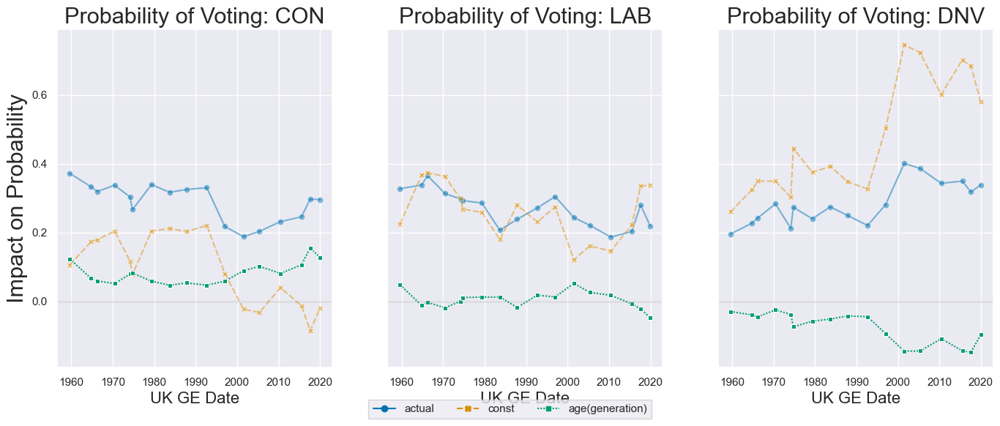

In [71]:
plot_OLS_set(["CON","LAB","DNV"], ["generation"], figsize=(16.5, 6),  sharey=True)

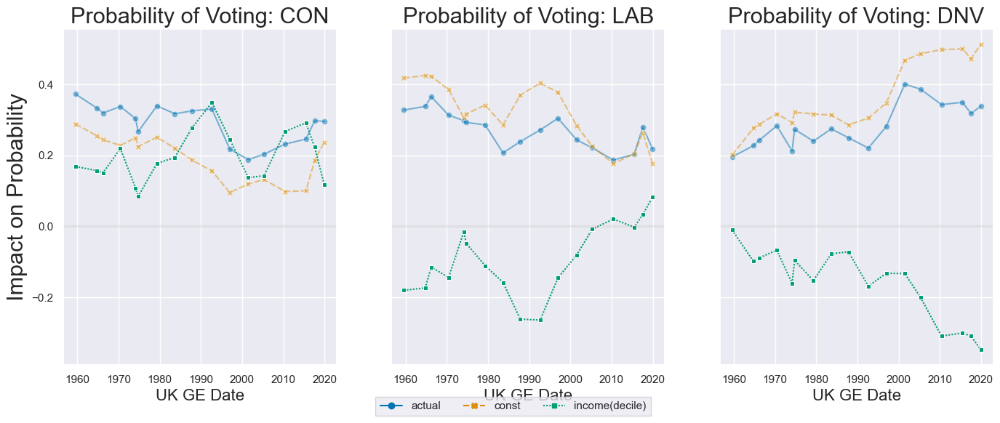

In [72]:
plot_OLS_set(["CON","LAB","DNV"], ["inc_norm_wt"], figsize=(16.5, 6),  sharey=True)

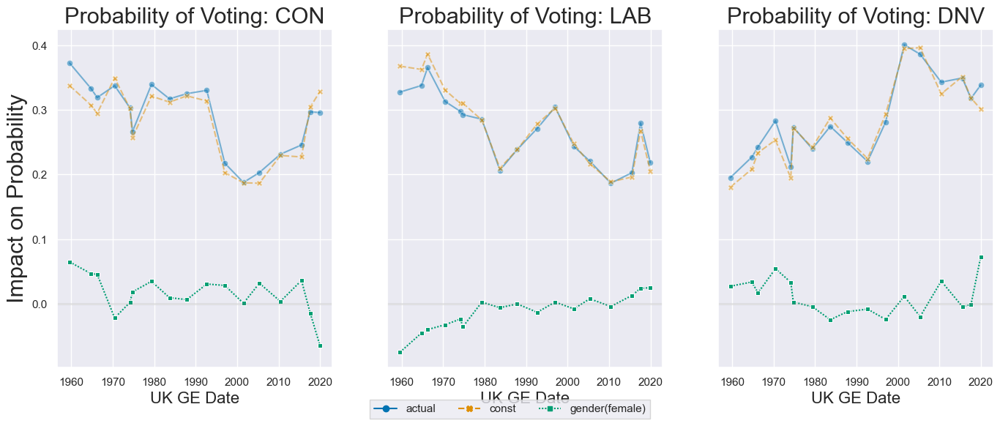

In [73]:
plot_OLS_set(["CON","LAB","DNV"], ["gender_complete"], figsize=(16.5, 6),  sharey=True)

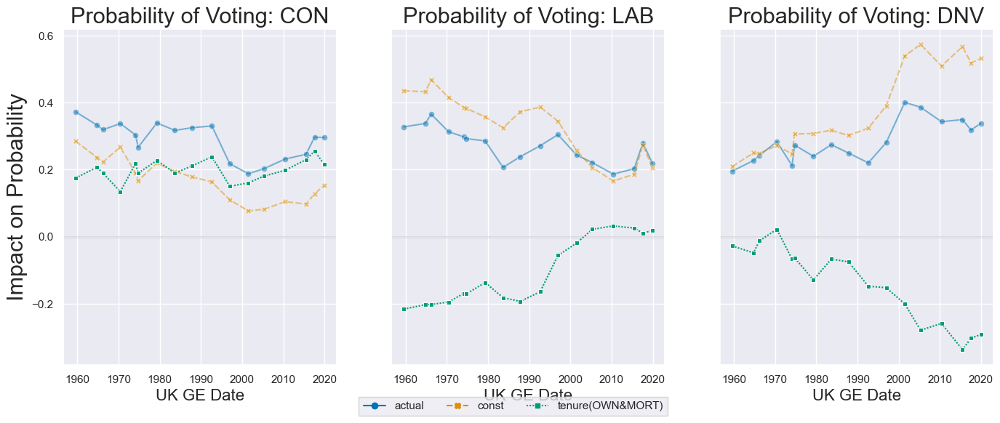

In [74]:
plot_OLS_set(["CON","LAB","DNV"], ["housing"], figsize=(16.5, 6),  sharey=True,drop_first=False,dummied_cols=["housing_OWN"])

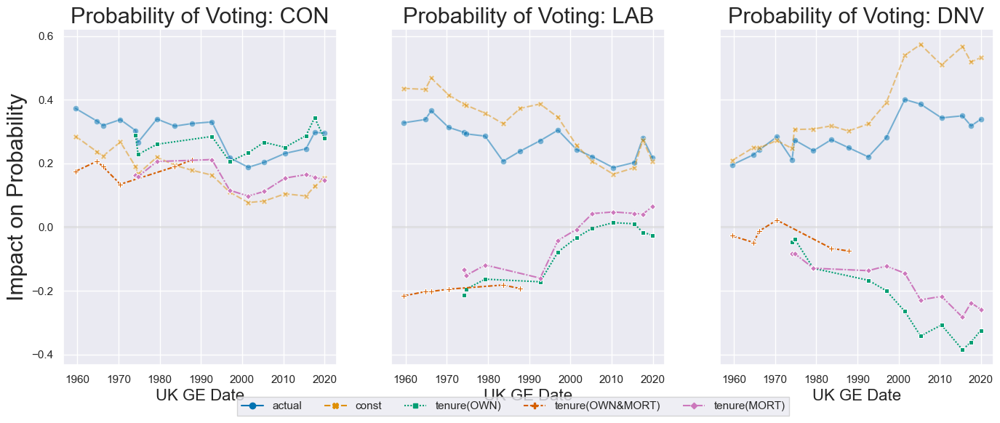

In [75]:
plot_OLS_set(["CON","LAB","DNV"], ["housing_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["housing_det_OWN","housing_det_OWN-MORT","housing_det_MORT"])

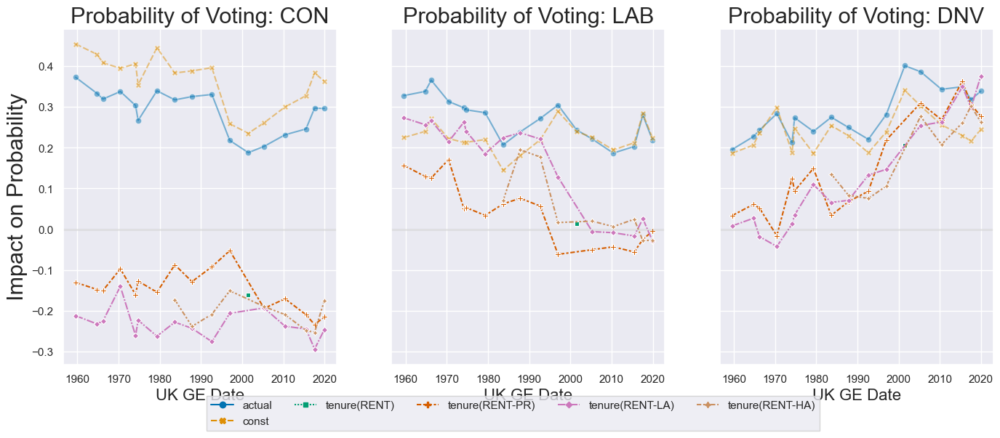

In [76]:
plot_OLS_set(["CON","LAB","DNV"], ["housing_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["housing_det_RENT-ALL","housing_det_RENT-PR","housing_det_RENT-LA","housing_det_RENT-HA"])

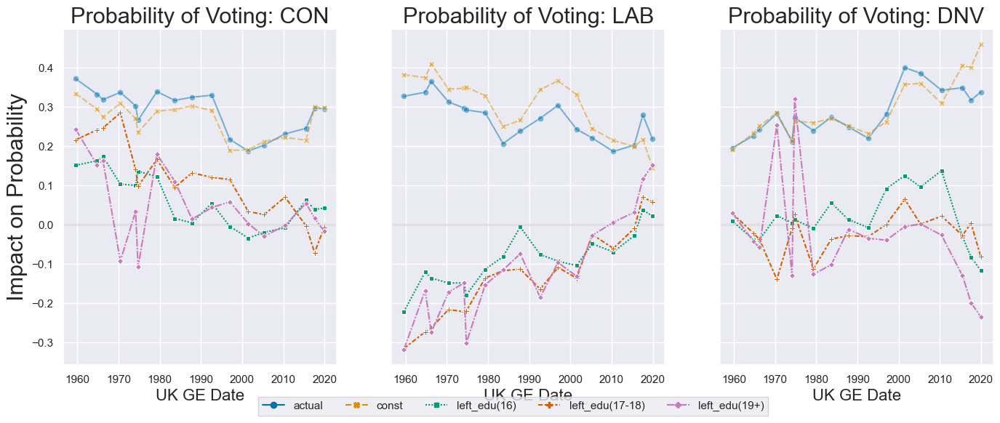

In [77]:
plot_OLS_set(["CON","LAB","DNV"], ["age_left_education_3"], figsize=(16.5, 6),  sharey=True, drop_first=True)

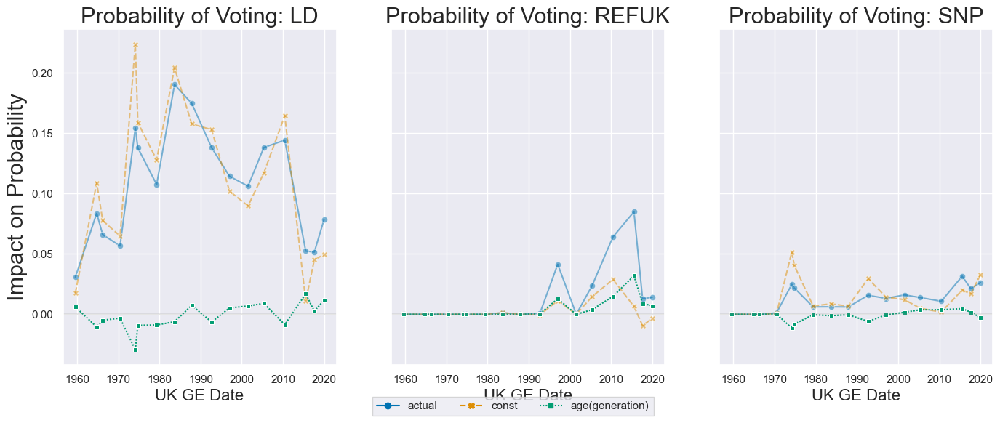

In [78]:
plot_OLS_set(["LD","REFUK","SNP"], ["generation"], figsize=(16.5, 6),  sharey=True, drop_first=True)

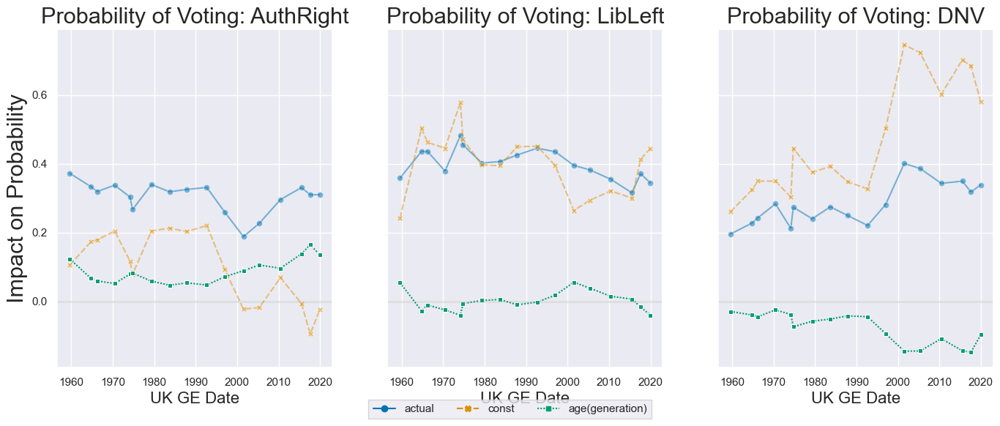

In [79]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["generation"], figsize=(16.5, 6),  sharey=True, drop_first=True)

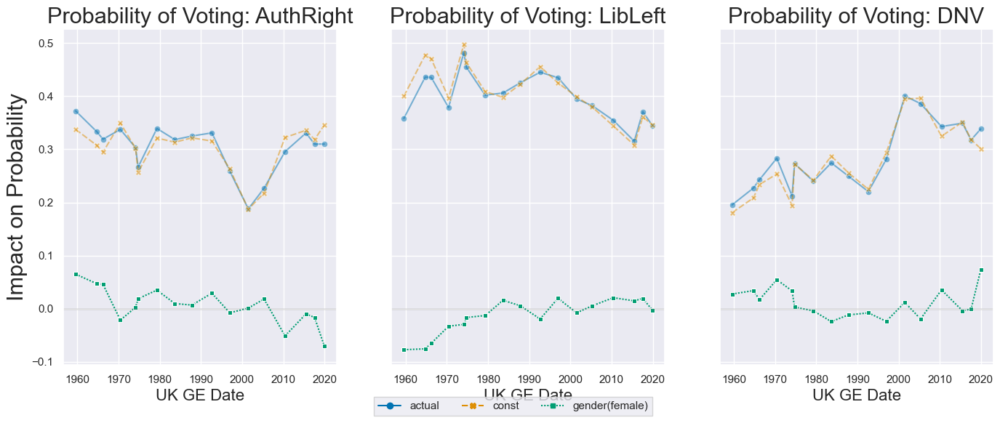

In [80]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["gender_complete"], figsize=(16.5, 6),  sharey=True, drop_first=True)

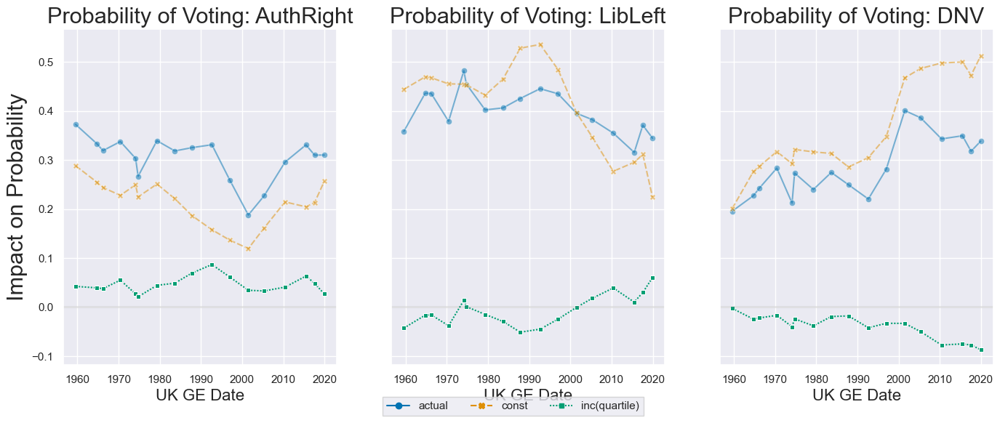

In [81]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["inc(quartile)"], figsize=(16.5, 6),  sharey=True, drop_first=True)

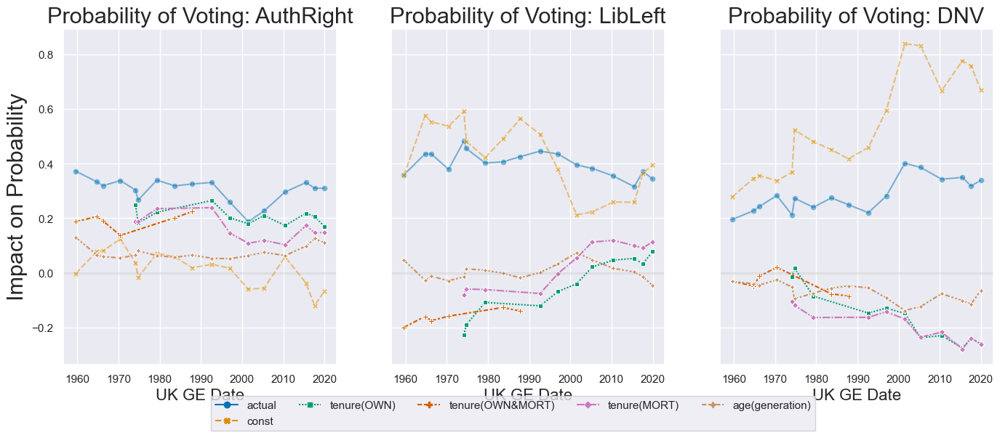

In [82]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["housing_det","generation"],dummied_cols=["housing_det_OWN","housing_det_OWN-MORT","housing_det_MORT","generation"], figsize=(16.5, 6),  sharey=True, drop_first=False)

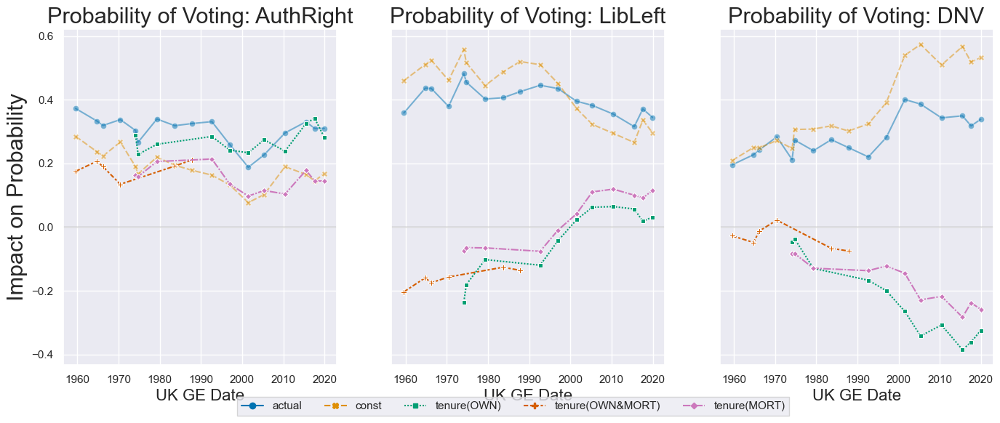

In [83]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["housing_det"],dummied_cols=["housing_det_OWN","housing_det_OWN-MORT","housing_det_MORT"], figsize=(16.5, 6),  sharey=True, drop_first=False)

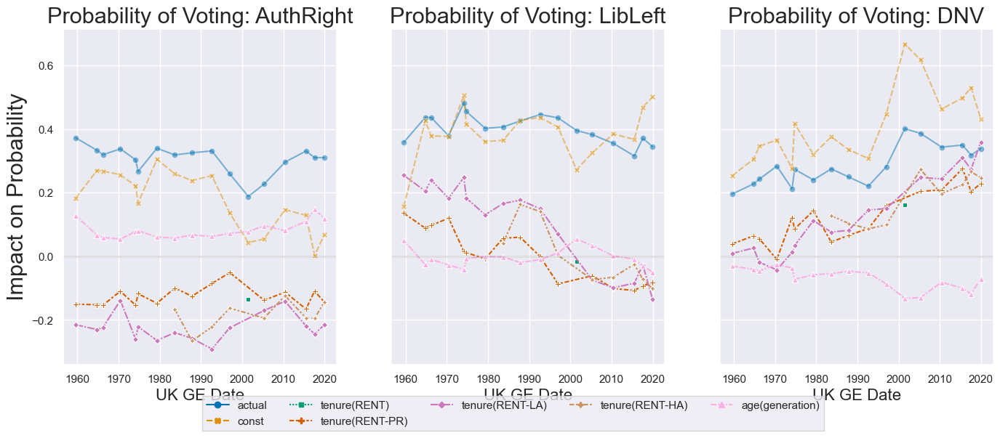

In [84]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["housing_det","generation"],
             dummied_cols=["housing_det_RENT-ALL","housing_det_RENT-PR","housing_det_RENT-LA","housing_det_RENT-HA","generation"], figsize=(16.5, 6),  sharey=True, drop_first=False)

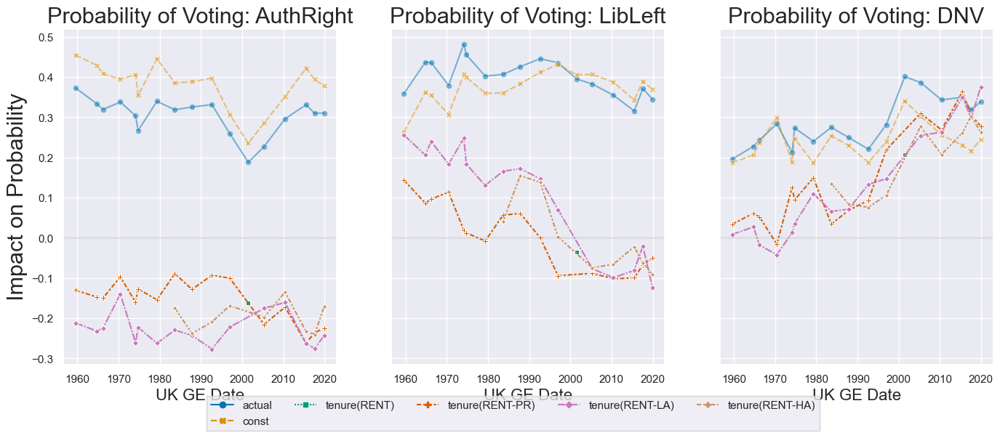

In [85]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["housing_det"],dummied_cols=["housing_det_RENT-ALL","housing_det_RENT-PR","housing_det_RENT-LA","housing_det_RENT-HA"], figsize=(16.5, 6),  sharey=True, drop_first=False)

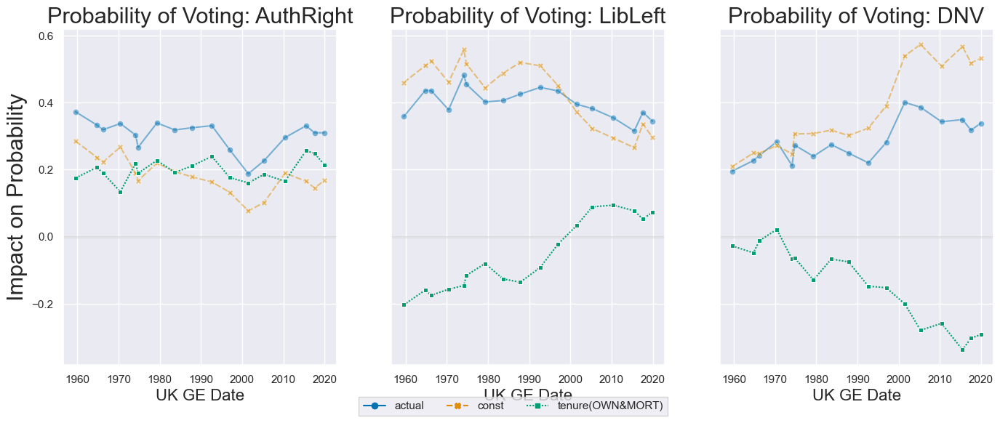

In [86]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["housing"],
             dummied_cols=["housing_OWN"],drop_first=False, figsize=(16.5, 6),  sharey=True, )

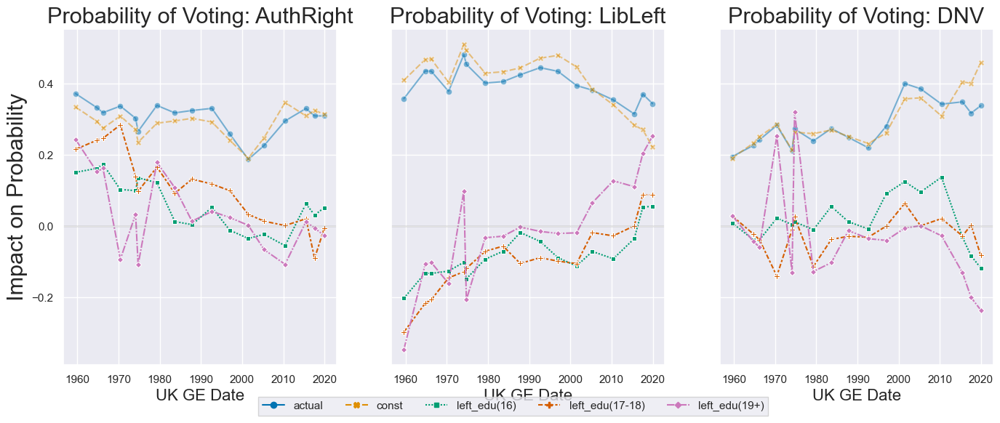

In [87]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["age_left_education_3"],drop_first=True, figsize=(16.5, 6),  sharey=True, )

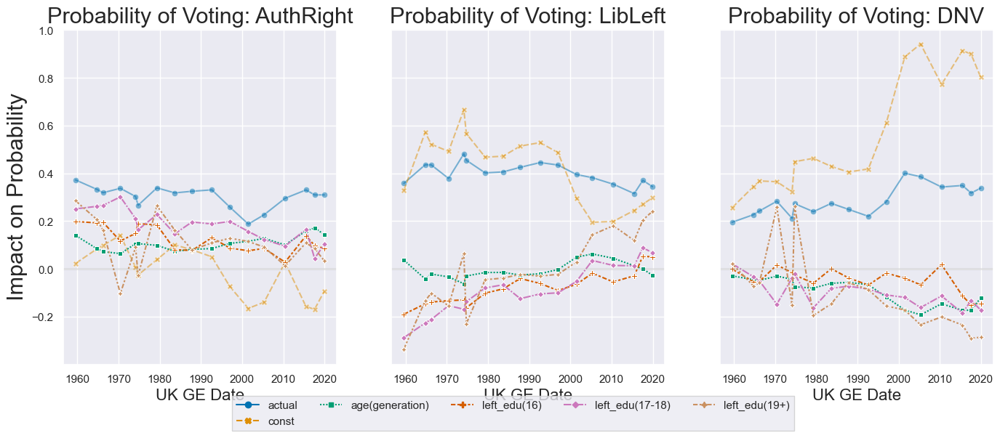

In [88]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["age_left_education_3","generation"],drop_first=True, figsize=(16.5, 6),  sharey=True, )

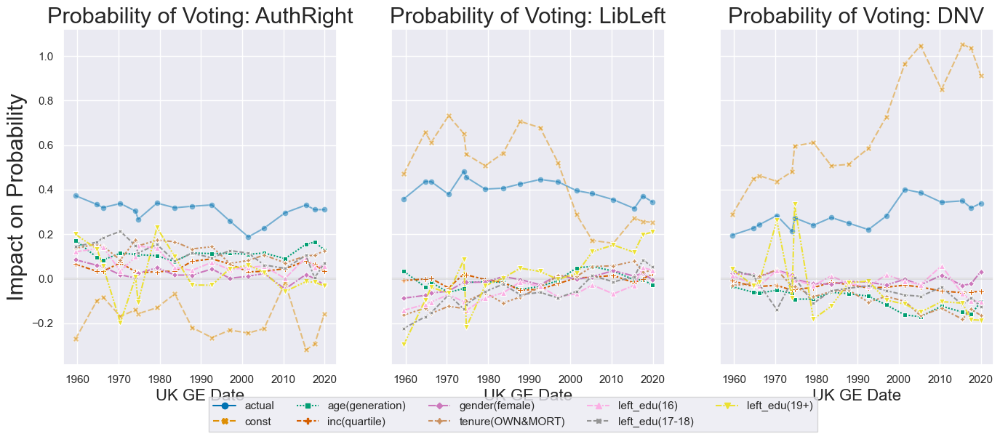

In [89]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["generation","inc(quartile)","gender_complete","housing","age_left_education_3"],
             dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_16","age_left_education_3_18",
                          "age_left_education_3_19 or older"],
             drop_first=False, figsize=(16.5, 6),  sharey=True, )

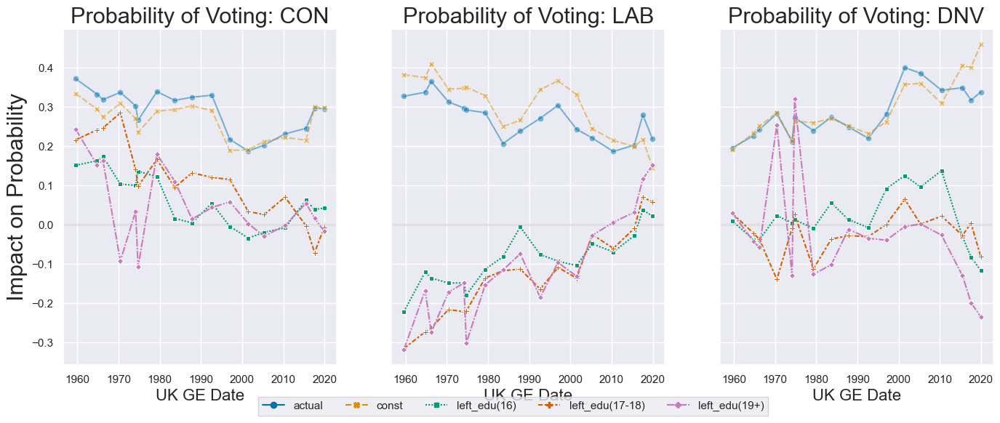

In [90]:
plot_OLS_set(["CON","LAB","DNV"], ["age_left_education_3"], figsize=(16.5, 6),  sharey=True,regularised=False,drop_first=True)

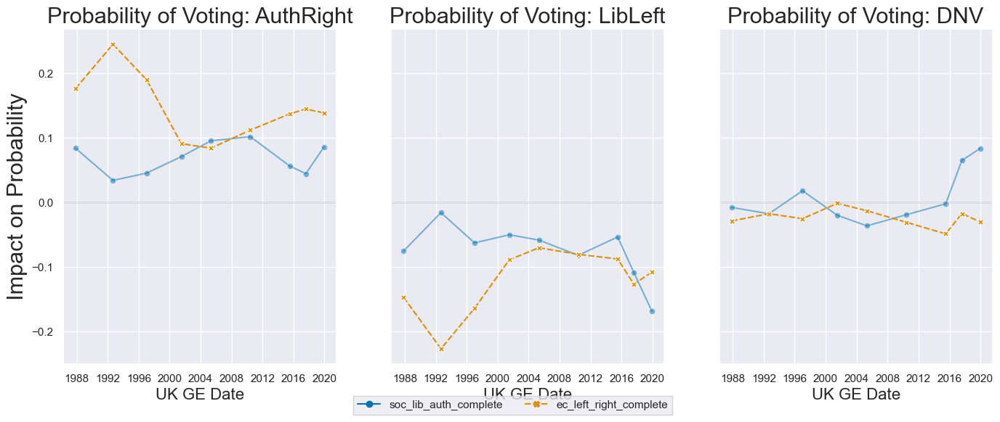

In [91]:
val_list = ['soc_lib_auth_complete','ec_left_right_complete']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"],
#              ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
              ['soc_lib_auth_complete','ec_left_right_complete'],
#              dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
#                           "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992','1987'])

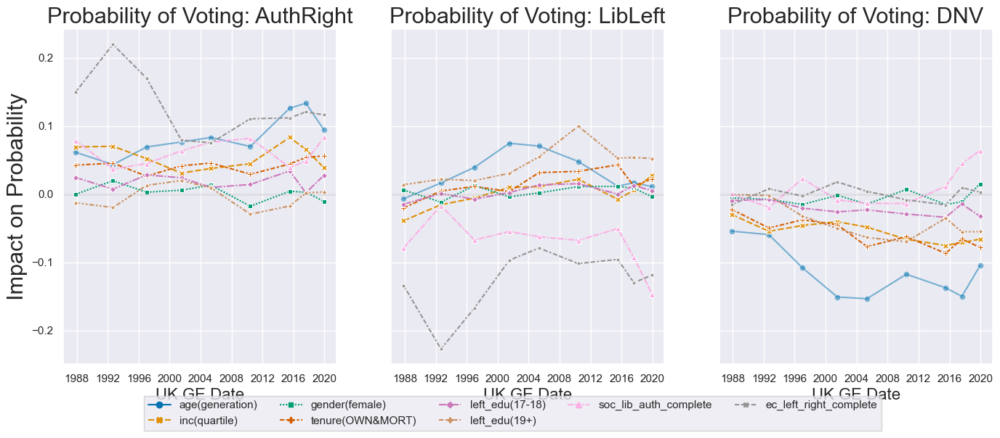

In [92]:
val_list = ['soc_lib_auth_complete','ec_left_right_complete']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"],
             ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
              'soc_lib_auth_complete','ec_left_right_complete'],
             dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
                          "age_left_education_3_19 or older",'soc_lib_auth_complete','ec_left_right_complete'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=True,hide_const=True,add_actual=False,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992','1987'])

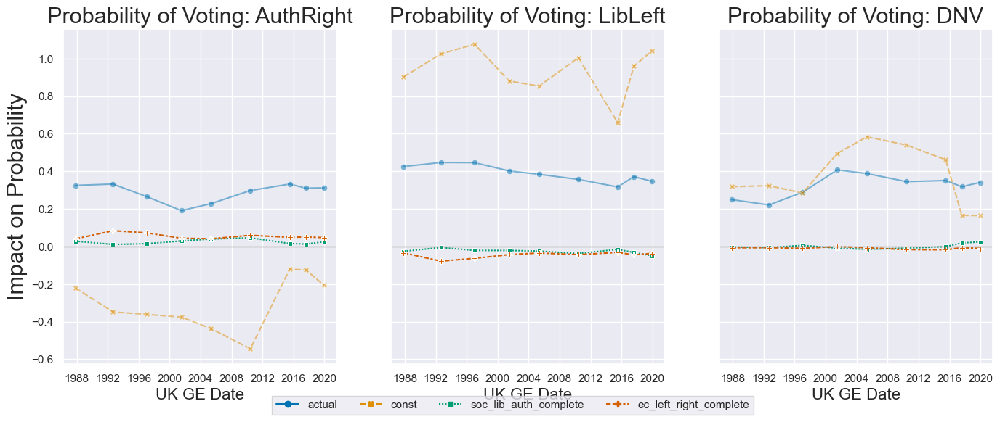

In [93]:
val_list = ['soc_lib_auth_complete','ec_left_right_complete']
mask = f2f_harmonised["bloc_complete"].notnull()&f2f_harmonised["wt"].notnull()&f2f_harmonised[val_list].notnull().all(axis=1)

plot_OLS_set(["AuthRight","LibLeft","DNV"],
#              ["generation","inc(quartile)","gender_complete","housing","age_left_education_3",
              ['soc_lib_auth_complete','ec_left_right_complete'],
#              dummied_cols=["generation","inc(quartile)","gender_complete","housing_OWN","age_left_education_3_18",
#                           "age_left_education_3_19 or older",'soc_lib_auth','ec_left_right'],
             drop_first=False, figsize=(16.5, 6),  sharey=True, variance_scaled=False,hide_const=False,add_actual=True,
            mask = mask,
            ge_range=['2019', '2017', '2015', '2010', '2005', '2001', '1997', '1992','1987'])

In [94]:
f2f_harmonised['soc_lib_auth_complete'] = f2f_harmonised['soc_lib_auth_complete']*2
f2f_harmonised['ec_left_right_complete'] = f2f_harmonised['ec_left_right_complete']*2

In [95]:
# married_cols = f2f_harmonised[["marital","marital_det"]].copy()
married_cols = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\married_cols.zip", compression='zip')

In [96]:
married_cols.groupby(f2f_harmonised["dataset"]).apply(lambda x: x.isnull().sum())

,marital,marital_det
dataset,,
1959,0,841
1964,0,841
1966,0,841
1970,0,841
1974_feb,0,0
1974_oct,2,2
1979,33,33
1983,2,2
1987,2,2


In [97]:
subjClass = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\subjClass.zip", compression='zip')

In [98]:
subjClass.groupby(f2f_harmonised["dataset"]).apply(lambda x: x.notnull().sum())

,subjClass
dataset,
1959,0
1964,2037
1966,0
1970,0
1974_feb,961
1974_oct,970
1979,844
1983,2063
1987,1755


In [99]:
tumember = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\tumember.zip", compression='zip')

In [100]:
tumember.groupby(f2f_harmonised["dataset"]).apply(lambda x: x.notnull().sum())

,tumember,tumember_det
dataset,,
1959,1930,1930
1964,1930,1930
1966,1930,1930
1970,1930,1930
1974_feb,2462,2462
1974_oct,2365,2365
1979,1857,1857
1983,3767,3767
1987,3664,3664


In [101]:
# ethnic_cols = f2f_harmonised[["ethnic_det"]].copy()
ethnic_cols = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\ethnic_cols.zip", compression='zip')

In [102]:
ethnic_cols.groupby(f2f_harmonised["dataset"]).apply(lambda x: x.isnull().sum())

,ethnic_det
dataset,
1959,913
1964,913
1966,840
1970,1567
1974_feb,2462
1974_oct,2365
1979,27
1983,6
1987,8


In [103]:
relig_cols = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\relig_cols.zip", compression='zip')

In [104]:
relig_cols.groupby(f2f_harmonised["dataset"]).apply(lambda x: x.isnull().mean())

,relig_det
dataset,
1959,0.015400
1964,0.015400
1966,0.015400
1970,0.015400
1974_feb,1.000000
1974_oct,0.006765
1979,0.020602
1983,0.002781
1987,0.003398


In [105]:
# weights.drop("temp_wts",axis=1,inplace=True)
# weights.to_pickle("E:\\BES_analysis_data\\Face_to_face\\weights.zip", compression='zip')

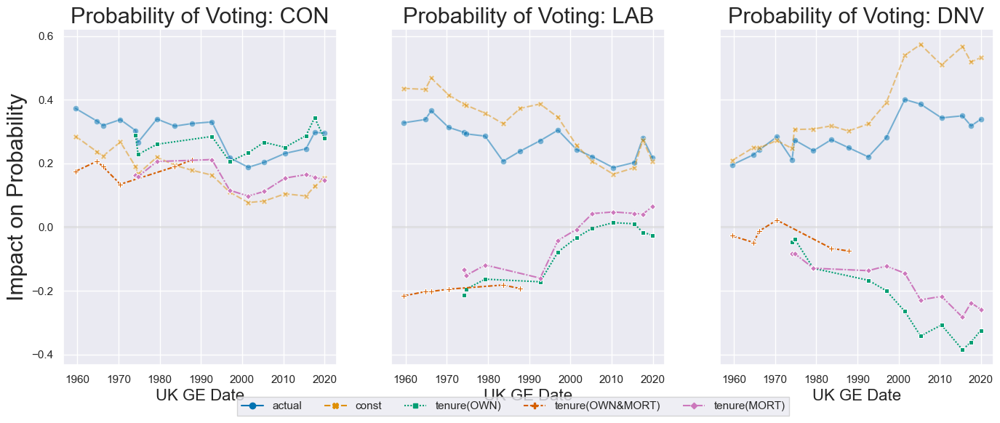

In [106]:
plot_OLS_set(["CON","LAB","DNV"], ["housing_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["housing_det_OWN","housing_det_OWN-MORT","housing_det_MORT"])

In [109]:
# plot_OLS_set(["AuthRight","LibLeft","DNV"], ["relig_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
#              dummied_cols=["relig_det_Anglican",
#                            "relig_det_NoReligion",
#                            "relig_det_Catholic",
#                            "relig_det_Presbyterian",
# #                           "relig_det_Christian","relig_det_Baptist",
#                            "relig_det_Methodist",
#                            "relig_det_Islam",
#                            "relig_det_Christian",
# #                            "relig_det_OtherNonconformist",
#                           ])

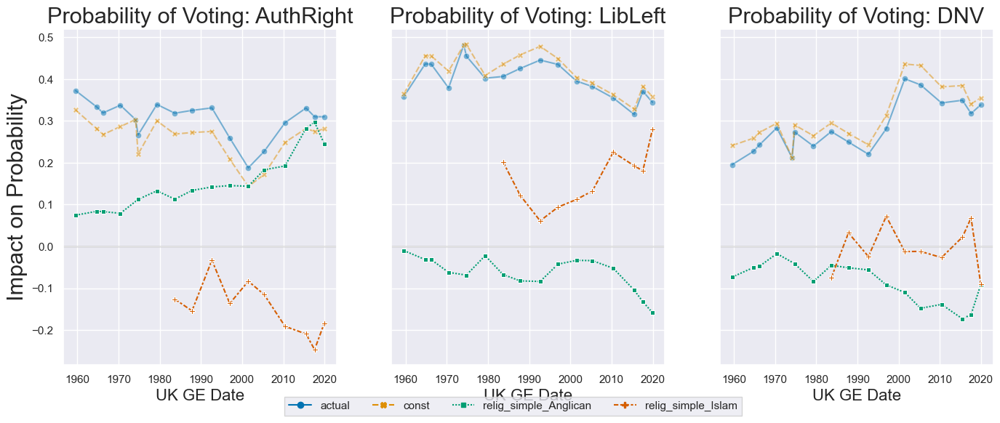

In [108]:
replace_dict = {'Anglican':"Anglican",
                'NoReligion':"NoReligion",'Humanist':"NoReligion",
                'Catholic':"ChristianOther", 'Presbyterian':"ChristianOther", 'Methodist':"ChristianOther",
                   'Christian':"ChristianOther", 'Baptist':"ChristianOther", 'ChristianOther':"ChristianOther",
                   'Congregational':"ChristianOther",'ProtestOther':"ChristianOther",'JehovahsWitness':"ChristianOther",
                   'Pentecostal':"ChristianOther", 'Brethren':"ChristianOther", 'FreePresbyterian':"ChristianOther",
                   'Evangelical':"ChristianOther",'Protestant':"ChristianOther",'Quaker':"ChristianOther",'Orthodox':"ChristianOther",
                'Other':"Other",  'OtherNonconformist':"Other",'NonChristianOther':"Other", 'Pagan':"Other",
                'Islam':"Islam",'IslamShia':"Islam", 'IslamSunni':"Islam", 'IslamOther':"Islam",
                'Hindu':"SmallerFaiths",'Jewish':"SmallerFaiths",'Sikh':"SmallerFaiths",'Buddhist':"SmallerFaiths", 'Jainism':"SmallerFaiths",
               }
relig_cols["relig_simple"] = relig_cols["relig_det"].replace(replace_dict)
f2f_harmonised[relig_cols.columns]=relig_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["relig_simple"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["relig_simple_Anglican",
#                            "relig_simple_NoReligion",
#                            "relig_simple_ChristianOther",
#                            "relig_simple_Presbyterian",
#                           "relig_det_Christian","relig_det_Baptist",
#                            "relig_simple_Other",
                           "relig_simple_Islam",
#                            "relig_simple_SmallerFaiths",
#                            "relig_det_OtherNonconformist",
                          ]
            )

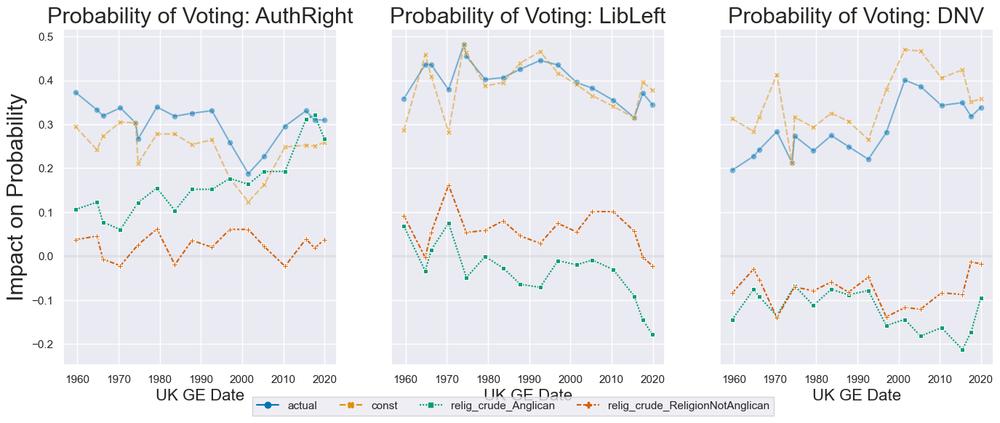

In [110]:
replace_dict = {'Anglican':"Anglican",
                'NoReligion':"NoReligion",'Humanist':"NoReligion",
                'Catholic':"ReligionNotAnglican", 'Presbyterian':"ReligionNotAnglican", 'Methodist':"ReligionNotAnglican",
                   'Christian':"ReligionNotAnglican", 'Baptist':"ReligionNotAnglican", 'ChristianOther':"ReligionNotAnglican",
                   'Congregational':"ReligionNotAnglican",'ProtestOther':"ReligionNotAnglican",'JehovahsWitness':"ReligionNotAnglican",
                   'Pentecostal':"ReligionNotAnglican", 'Brethren':"ReligionNotAnglican", 'FreePresbyterian':"ReligionNotAnglican",
                   'Evangelical':"ReligionNotAnglican",'Protestant':"ReligionNotAnglican",'Quaker':"ReligionNotAnglican",
                'Orthodox':"ReligionNotAnglican",
                'Other':np.nan,  'OtherNonconformist':"ReligionNotAnglican",'NonChristianOther':"ReligionNotAnglican", 'Pagan':"ReligionNotAnglican",
                'Islam':"ReligionNotAnglican",'IslamShia':"ReligionNotAnglican", 'IslamSunni':"ReligionNotAnglican", 'IslamOther':"ReligionNotAnglican",
                'Hindu':"ReligionNotAnglican",'Jewish':"ReligionNotAnglican",'Sikh':"ReligionNotAnglican",'Buddhist':"ReligionNotAnglican", 'Jainism':"ReligionNotAnglican",
               }
relig_cols["relig_crude"] = relig_cols["relig_det"].replace(replace_dict)
f2f_harmonised[relig_cols.columns]=relig_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["relig_crude"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["relig_crude_Anglican",
#                            "relig_simple_NoReligion",
#                            "relig_simple_ChristianOther",
#                            "relig_simple_Presbyterian",
#                           "relig_det_Christian","relig_det_Baptist",
#                            "relig_simple_Other",
                           "relig_crude_ReligionNotAnglican",
#                            "relig_simple_SmallerFaiths",
#                            "relig_det_OtherNonconformist",
                          ]
            )

In [111]:
f2f_harmonised["relig_crude"].value_counts()

Anglican               19180
ReligionNotAnglican    15128
NoReligion             13339
Name: relig_crude, dtype: int64

In [112]:
pd.get_dummies(f2f_harmonised["relig_det"]).astype('float').corrwith(f2f_harmonised["AuthRight"]).sort_values()

NoReligion           -0.085408
Catholic             -0.057881
Islam                -0.049057
Other                -0.020222
JehovahsWitness      -0.020048
Presbyterian         -0.015881
Buddhist             -0.012380
IslamShia            -0.012160
NonChristianOther    -0.011307
Sikh                 -0.010990
Hindu                -0.010944
IslamOther           -0.008592
IslamSunni           -0.007757
ProtestOther         -0.006833
Pentecostal          -0.006833
FreePresbyterian     -0.005579
Protestant           -0.004373
ChristianOther       -0.003931
Orthodox             -0.002723
Quaker               -0.001572
Brethren             -0.000079
Pagan                -0.000042
Humanist             -0.000030
Baptist               0.000023
Methodist             0.001331
Jainism               0.002150
Evangelical           0.003724
OtherNonconformist    0.012215
Congregational        0.015366
Jewish                0.016577
Christian             0.019898
Anglican              0.153907
dtype: f

In [113]:
pd.get_dummies(f2f_harmonised["relig_det"]).astype('float').corrwith(f2f_harmonised["LibLeft"]).sort_values()

Anglican             -0.091925
JehovahsWitness      -0.023566
Christian            -0.019651
OtherNonconformist   -0.017054
Brethren             -0.014754
Jewish               -0.012443
Orthodox             -0.008991
ProtestOther         -0.007761
Evangelical          -0.002792
Congregational       -0.002278
ChristianOther       -0.001617
Protestant            0.000446
Jainism               0.000446
Pagan                 0.000773
FreePresbyterian      0.001411
Other                 0.001713
IslamOther            0.002349
Humanist              0.003067
NonChristianOther     0.004460
Pentecostal           0.004918
Quaker                0.004998
IslamSunni            0.005629
Hindu                 0.007251
Buddhist              0.007699
Baptist               0.011832
IslamShia             0.011929
Sikh                  0.012194
Methodist             0.019490
NoReligion            0.024488
Islam                 0.034010
Presbyterian          0.035949
Catholic              0.048174
dtype: f

In [114]:
ethnic_cols["ethnic_det"].value_counts()

WhiteBritish        20541
WhiteEuropean       12811
White                7393
WhiteOther            437
AsianIndian           398
Other                 242
BlackAfrican          219
AsianPakistani        219
WhiteIrish            170
BlackCaribbean        162
AsianOther             86
Black                  84
AsianBangladeshi       76
MixedOther             65
White&Asian            65
Asian                  63
White&BlackCarib       59
Coloured               56
AsianChinese           54
BlackAfric&Carib       40
White&BlackAfric       33
AsianSouth             33
BlackOther             28
AsianArab              19
OtherIncChinese        10
WhiteGypsy              6
WhitePolish             5
AsianEast               2
PossNonCaucasian        1
Name: ethnic_det, dtype: int64

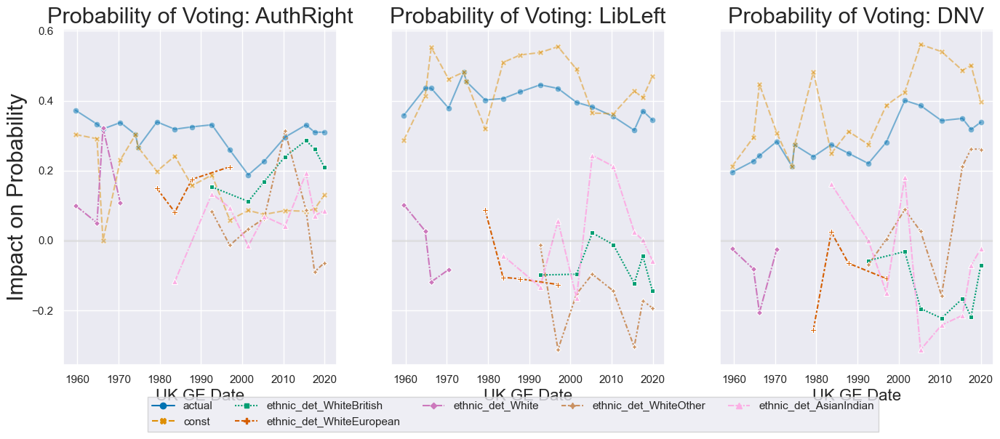

In [115]:
f2f_harmonised[ethnic_cols.columns]=ethnic_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["ethnic_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["ethnic_det_"+x for x in ethnic_cols["ethnic_det"].value_counts().index[0:5]],
#              ["relig_det_Anglican",
#                            "relig_det_NoReligion",
#                            "relig_det_Catholic",
#                            "relig_det_Presbyterian",
# #                           "relig_det_Christian","relig_det_Baptist",
#                            "relig_det_Methodist",
#                            "relig_det_Islam",
# #                            "relig_det_OtherNonconformist",
#                           ]
            )

In [116]:
ethnic_cols["ethnic_det"].value_counts().index

replace_dict = {'WhiteBritish':"White", 'WhiteEuropean':"White", 'White':"White", 'WhiteOther':"White",
                'AsianIndian':"NotWhite",
       'Other':"NotWhite", 'BlackAfrican':"NotWhite", 'AsianPakistani':"NotWhite", 'WhiteIrish':"White",
       'BlackCaribbean':"NotWhite", 'AsianOther':"NotWhite", 'Black':"NotWhite", 'AsianBangladeshi':"NotWhite",
       'White&Asian':"NotWhite", 'MixedOther':"NotWhite", 'Asian':"NotWhite", 'White&BlackCarib':"NotWhite", 'Coloured':"NotWhite",
       'AsianChinese':"NotWhite", 'BlackAfric&Carib':"NotWhite", 'AsianSouth':"NotWhite", 'White&BlackAfric':"NotWhite",
       'BlackOther':"NotWhite", 'AsianArab':"NotWhite", 'OtherIncChinese':"NotWhite", 'WhiteGypsy':"White",
       'WhitePolish':"White", 'AsianEast':"NotWhite", 'PossNonCaucasian':"NotWhite"}

ethnic_cols["ethnic_det"].replace(replace_dict).value_counts(dropna=False)

White       41363
NaN          9354
NotWhite     2014
Name: ethnic_det, dtype: int64

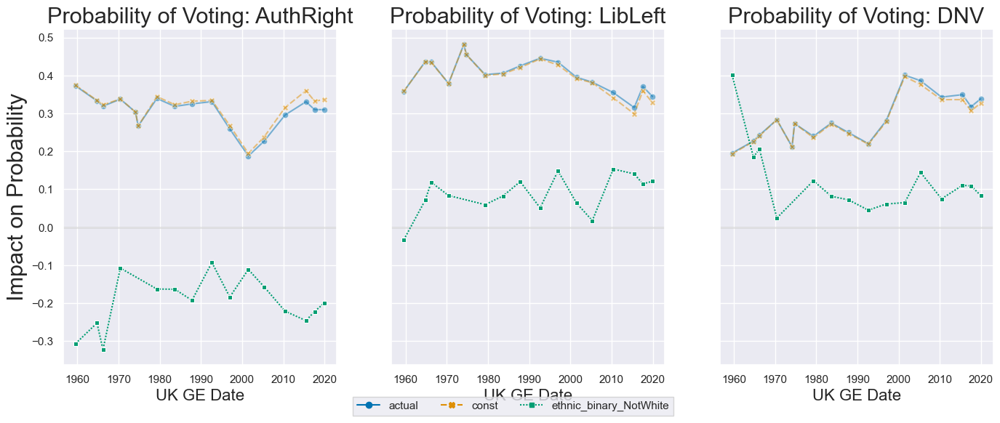

In [117]:
ethnic_cols["ethnic_binary"] = ethnic_cols["ethnic_det"].replace(replace_dict)
f2f_harmonised[ethnic_cols.columns]=ethnic_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["ethnic_binary"], figsize=(16.5, 6),  sharey=True,drop_first=False,
#              dummied_cols=["ethnic_binary_"+x for x in ethnic_cols["ethnic_binary"].value_counts().index[1:5]],
             dummied_cols=["ethnic_binary_NotWhite"],
            )

In [118]:
replace_dict = {'WhiteBritish':"White", 'WhiteEuropean':"White", 'White':"White",
                'WhiteOther':"WhiteOther&Not",
                'AsianIndian':"WhiteOther&Not",
       'Other':"WhiteOther&Not", 'BlackAfrican':"WhiteOther&Not", 'AsianPakistani':"WhiteOther&Not", 'WhiteIrish':"WhiteOther&Not",
       'BlackCaribbean':"WhiteOther&Not", 'AsianOther':"WhiteOther&Not", 'Black':"WhiteOther&Not", 'AsianBangladeshi':"WhiteOther&Not",
       'White&Asian':"WhiteOther&Not", 'MixedOther':"WhiteOther&Not", 'Asian':"WhiteOther&Not", 'White&BlackCarib':"WhiteOther&Not",
        'Coloured':"WhiteOther&Not",
       'AsianChinese':"WhiteOther&Not", 'BlackAfric&Carib':"WhiteOther&Not", 'AsianSouth':"WhiteOther&Not",
                'White&BlackAfric':"WhiteOther&Not",
       'BlackOther':"WhiteOther&Not", 'AsianArab':"WhiteOther&Not", 'OtherIncChinese':"WhiteOther&Not",
                'WhiteGypsy':"WhiteOther&Not",  'WhitePolish':"WhiteOther&Not",
                'AsianEast':"WhiteOther&Not", 'PossNonCaucasian':"WhiteOther&Not"}


# White->WhiteEuropean->WhiteBritish
# drop WhiteOther,WhiteIrish,WhiteGypsy,WhitePolish
# WhiteOther is a bit weird - 2010 spike?

ethnic_cols["ethnic_det"].replace(replace_dict).value_counts(dropna=False)

White             40745
NaN                9354
WhiteOther&Not     2632
Name: ethnic_det, dtype: int64

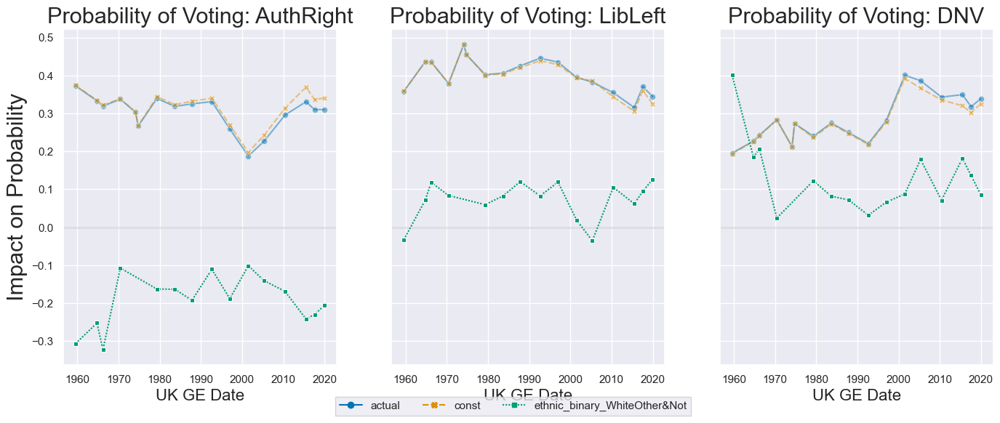

In [119]:
ethnic_cols["ethnic_binary"] = ethnic_cols["ethnic_det"].replace(replace_dict)
f2f_harmonised[ethnic_cols.columns]=ethnic_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["ethnic_binary"], figsize=(16.5, 6),  sharey=True,drop_first=False,
#              dummied_cols=["ethnic_binary_"+x for x in ethnic_cols["ethnic_binary"].value_counts().index[1:5]],
             dummied_cols=["ethnic_binary_WhiteOther&Not",],
            )

In [120]:
pd.get_dummies(f2f_harmonised["ethnic_det"]).astype('float').corrwith(f2f_harmonised["DNV"]).sort_values()

White              -0.053733
WhiteEuropean      -0.033480
OtherIncChinese    -0.003148
AsianEast          -0.002979
Asian              -0.002722
PossNonCaucasian   -0.002106
AsianBangladeshi   -0.000521
WhiteIrish          0.000658
BlackAfric&Carib    0.000732
Black               0.001304
White&BlackAfric    0.001439
AsianSouth          0.001439
White&Asian         0.005070
AsianArab           0.006113
AsianPakistani      0.007133
AsianChinese        0.007204
AsianIndian         0.008690
BlackOther          0.009853
Coloured            0.010967
WhiteGypsy          0.012984
WhitePolish         0.015165
AsianOther          0.021217
BlackAfrican        0.021426
MixedOther          0.022995
White&BlackCarib    0.024334
BlackCaribbean      0.026478
Other               0.033730
WhiteBritish        0.046505
WhiteOther          0.048645
dtype: float64

In [121]:
pd.get_dummies(f2f_harmonised["ethnic_det"]).astype('float').corrwith(f2f_harmonised["LibLeft"]).sort_values()

WhiteOther         -0.013301
WhiteBritish       -0.011559
Other              -0.006332
WhitePolish        -0.005153
AsianChinese       -0.003625
MixedOther         -0.003415
WhiteGypsy         -0.002792
AsianOther         -0.002726
White              -0.002557
OtherIncChinese    -0.001764
White&BlackCarib   -0.000419
BlackOther          0.000020
AsianEast           0.000446
PossNonCaucasian    0.004682
AsianSouth          0.005615
AsianArab           0.006385
Coloured            0.007033
White&Asian         0.007423
White&BlackAfric    0.010177
BlackAfric&Carib    0.010284
Asian               0.010762
BlackAfrican        0.013254
BlackCaribbean      0.014330
WhiteIrish          0.015525
AsianIndian         0.015986
Black               0.017198
AsianBangladeshi    0.019794
AsianPakistani      0.025080
WhiteEuropean       0.027172
dtype: float64

In [122]:
pd.get_dummies(f2f_harmonised["ethnic_det"]).astype('float').corrwith(f2f_harmonised["AuthRight"]).sort_index()

Asian              -0.008277
AsianArab          -0.011364
AsianBangladeshi   -0.019564
AsianChinese       -0.001382
AsianEast           0.002150
AsianIndian        -0.022005
AsianOther         -0.013765
AsianPakistani     -0.030863
AsianSouth         -0.006524
Black              -0.018289
BlackAfric&Carib   -0.010809
BlackAfrican       -0.030239
BlackCaribbean     -0.035788
BlackOther         -0.007647
Coloured           -0.016985
MixedOther         -0.014641
Other              -0.020278
OtherIncChinese     0.004808
PossNonCaucasian   -0.003092
White               0.036555
White&Asian        -0.011206
White&BlackAfric   -0.011343
White&BlackCarib   -0.018958
WhiteBritish       -0.016738
WhiteEuropean       0.010197
WhiteGypsy         -0.007575
WhiteIrish         -0.016287
WhiteOther         -0.026357
WhitePolish        -0.006915
dtype: float64

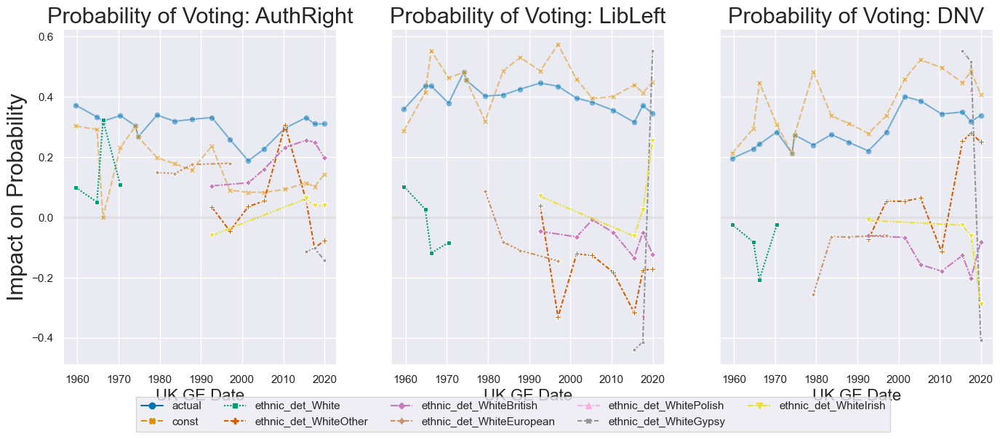

In [123]:
# ethnic_cols["ethnic_binary"] = ethnic_cols["ethnic_det"].replace(replace_dict)
f2f_harmonised[ethnic_cols.columns]=ethnic_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["ethnic_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
#              dummied_cols=["ethnic_binary_"+x for x in ethnic_cols["ethnic_binary"].value_counts().index[1:5]],
             dummied_cols=["ethnic_det_White","ethnic_det_WhiteOther","ethnic_det_WhiteBritish","ethnic_det_WhiteEuropean",
                          "ethnic_det_WhitePolish","ethnic_det_WhiteGypsy","ethnic_det_WhiteIrish",],
            )

In [124]:
# White->WhiteEuropean->WhiteBritish
# drop WhiteOther,WhiteIrish,WhiteGypsy,WhitePolish
# WhiteOther is a bit weird - 2010 spike?

In [125]:
tumember["tumember"].value_counts()

NO       37144
YES      11014
STAFF      119
Name: tumember, dtype: int64

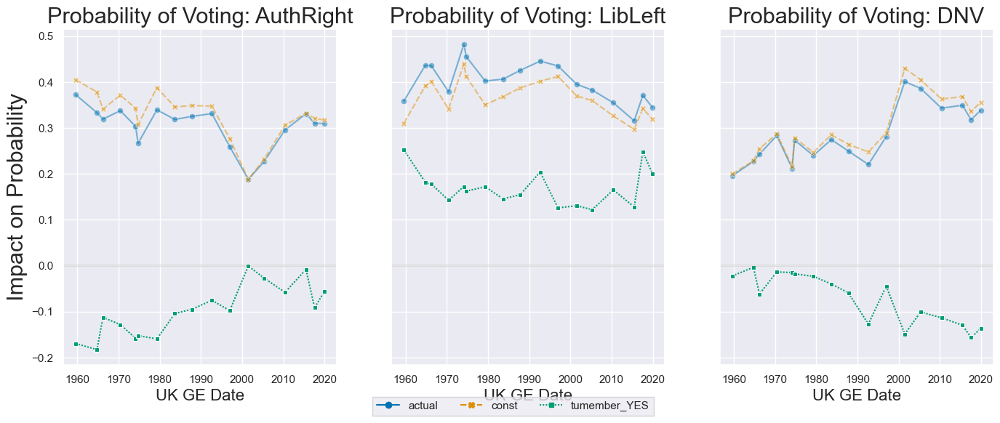

In [126]:
f2f_harmonised[tumember.columns]=tumember
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["tumember"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["tumember_"+x for x in tumember["tumember"].value_counts().index[1:2]],
            )

In [127]:
replace_dict = {"STAFF":"YES"}
tumember["tumember_simple"] = tumember["tumember"].replace(replace_dict)
tumember["tumember_simple"].value_counts(dropna=False)

NO     37144
YES    11133
NaN     4454
Name: tumember_simple, dtype: int64

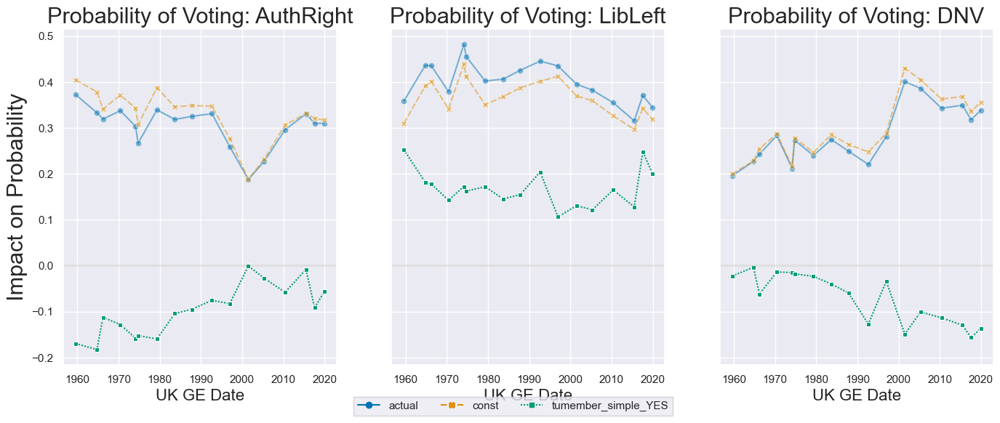

In [128]:
f2f_harmonised[tumember.columns]=tumember
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["tumember_simple"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["tumember_simple_"+x for x in tumember["tumember_simple"].value_counts().index[1:2]],
            )

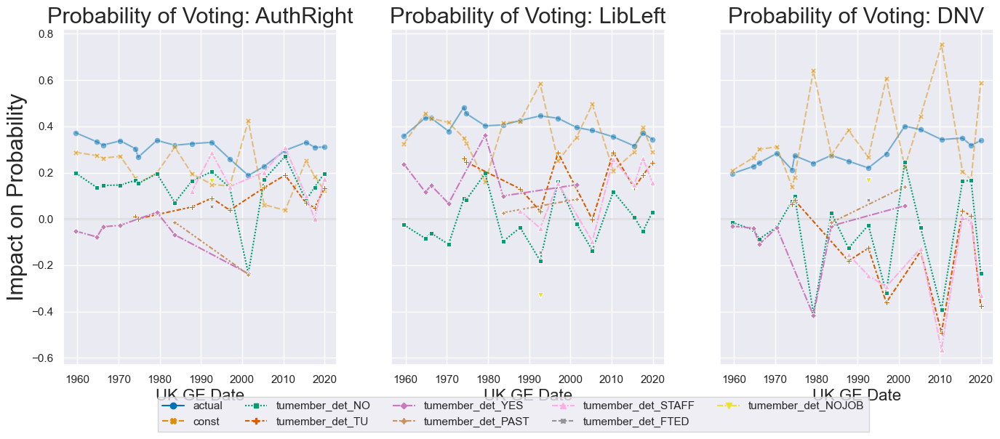

In [129]:
f2f_harmonised[tumember.columns]=tumember
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["tumember_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["tumember_det_"+x for x in tumember["tumember_det"].value_counts().index],
            )

In [130]:
married_cols["marital"].value_counts()

MARRIED      34338
SINGLE        9277
DIVWIDSEP     8975
Name: marital, dtype: int64

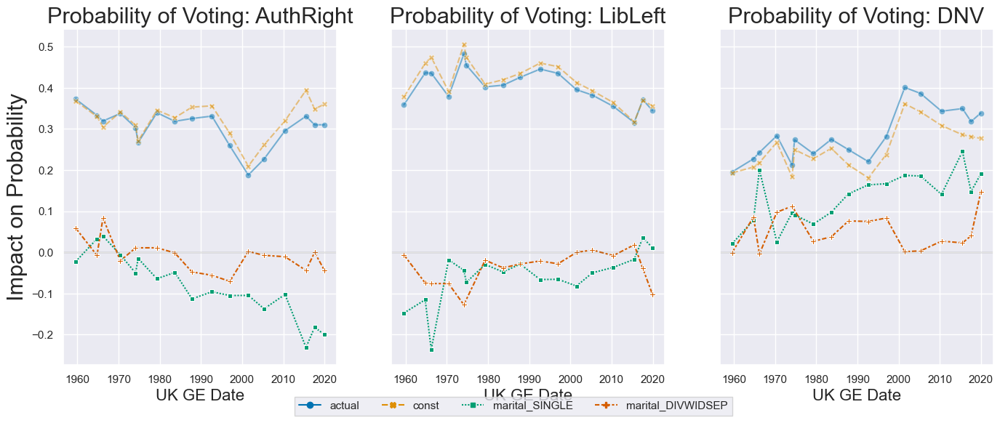

In [131]:
f2f_harmonised[married_cols.columns]=married_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["marital"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["marital_"+x for x in married_cols["marital"].value_counts().index[1:]],
            )

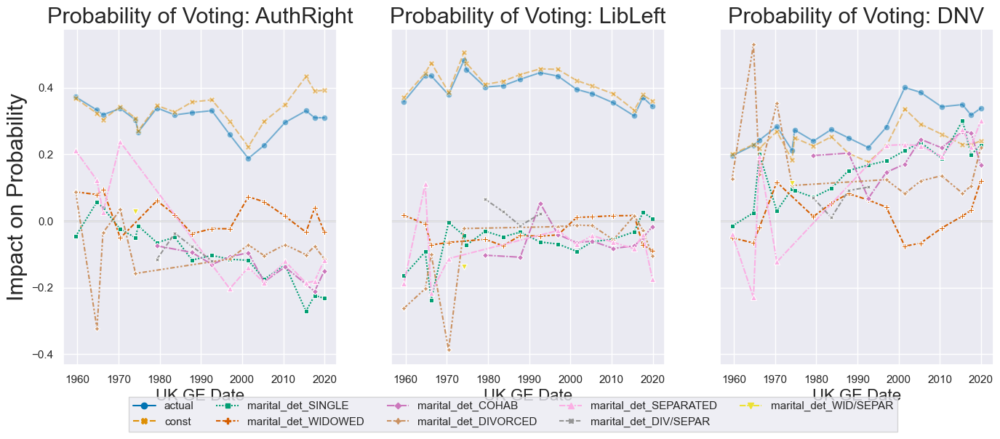

In [132]:
f2f_harmonised[married_cols.columns]=married_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["marital_det"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["marital_det_"+x for x in married_cols["marital_det"].value_counts().index[1:]],
            )

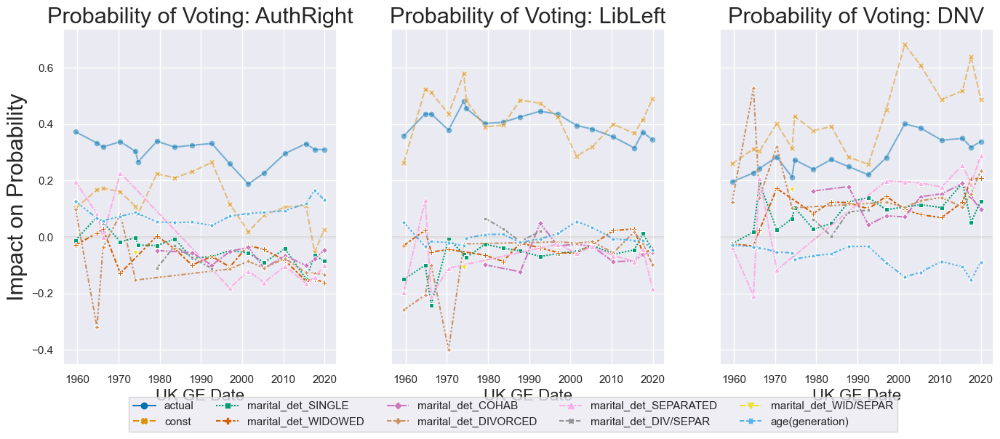

In [133]:
f2f_harmonised[married_cols.columns]=married_cols
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["marital_det","generation"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=["marital_det_"+x for x in married_cols["marital_det"].value_counts().index[1:]]+["generation"],
            )

In [134]:
subjClass["subjClass"].value_counts()

0.0    14656
1.0     8053
Name: subjClass, dtype: int64

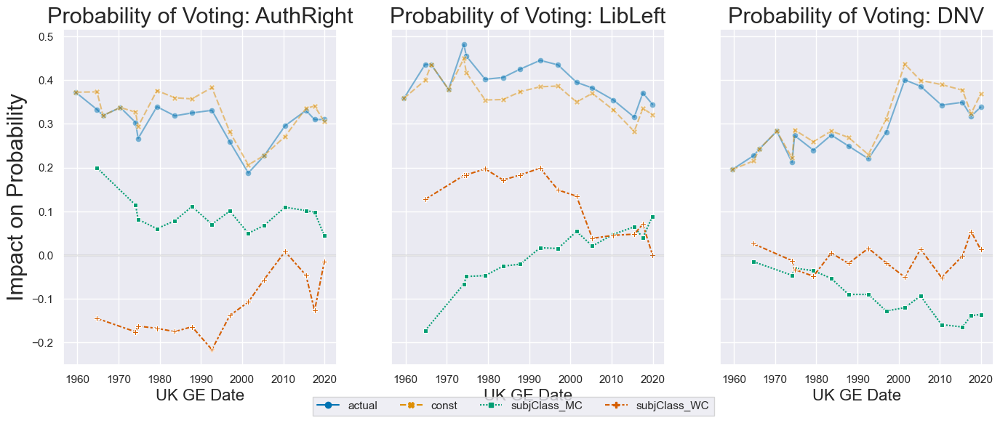

In [135]:
f2f_harmonised[subjClass.columns]=subjClass.replace({0:"WC",1.0:"MC"})
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["subjClass"], figsize=(16.5, 6),  sharey=True,drop_first=False,
#              dummied_cols=["marital_det_"+x for x in married_cols["marital_det"].value_counts().index[1:]],
            )

In [136]:
region = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\region.zip", compression='zip')
# region.index = f2f_harmonised["uid"]
region["region"].value_counts()

Scotland         6432
South East       6295
North West       4360
London           3728
West Midlands    3524
Yorks/Humbs      3447
Wales            3120
South West       3110
East Midlands    2642
Eastern          2260
North East       2125
Name: region, dtype: int64

In [137]:
["region_"+x for x in region["region"].value_counts().index]

['region_Scotland',
 'region_South East',
 'region_North West',
 'region_London',
 'region_West Midlands',
 'region_Yorks/Humbs',
 'region_Wales',
 'region_South West',
 'region_East Midlands',
 'region_Eastern',
 'region_North East']

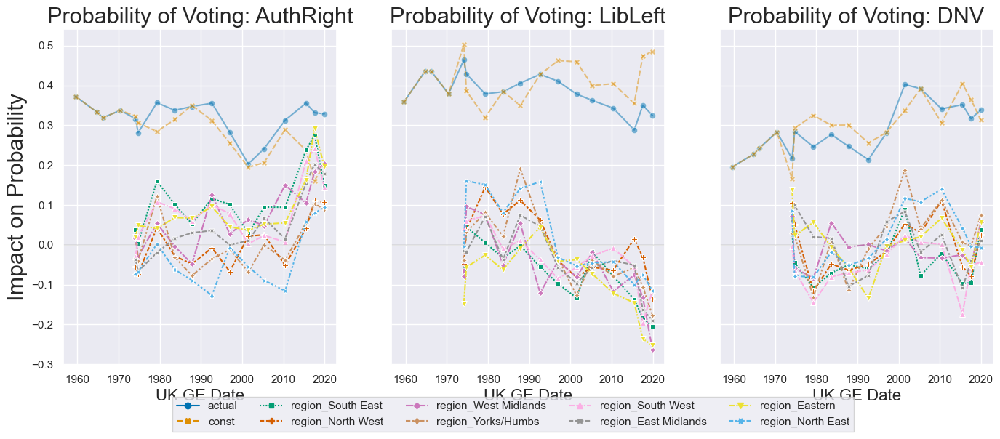

In [138]:
f2f_harmonised[region.columns]=region
mask = ~f2f_harmonised["region"].isin(["Scotland","Wales"])
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["region"], figsize=(16.5, 6),  sharey=True,drop_first=False,
             dummied_cols=[
#                  'region_Scotland',
 'region_South East',
 'region_North West',
#  'region_London',
 'region_West Midlands',
 'region_Yorks/Humbs',
#  'region_Wales',
 'region_South West',
 'region_East Midlands',
 'region_Eastern',
 'region_North East'],
             mask=mask
            )

In [139]:
replace_dict = {1:"Scotland",2:"Wales",3:"Northern England",4:"Mid&E England",5:"South West",6:"London&SE England",0:np.nan}

mask = f2f_harmonised["dataset"]=="1970"
f2f_harmonised.loc[mask,"region"] = BES_df_list["1970"]["v38"].replace( replace_dict ).values
mask = f2f_harmonised["dataset"]=="1966"
f2f_harmonised.loc[mask,"region"] = BES_df_list["1966"]["v37"].replace( replace_dict ).values
mask = f2f_harmonised["dataset"]=="1964"
f2f_harmonised.loc[mask,"region"] = BES_df_list["1964"]["v36"].replace( replace_dict ).values
mask = f2f_harmonised["dataset"]=="1959"
f2f_harmonised.loc[mask,"region"] = BES_df_list["1959"]["v35"].replace( replace_dict ).values

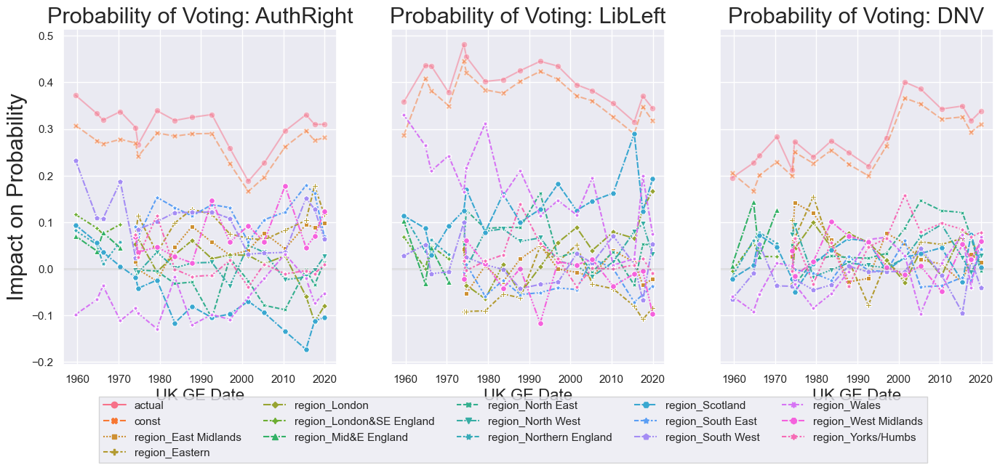

In [140]:
# f2f_harmonised[region.columns]=region
# mask = ~f2f_harmonised["region"].isin(["Scotland","Wales"])
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["region"], figsize=(16.5, 6),  sharey=True,drop_first=False,)

In [141]:
replace_dict = {'East Midlands':"England", 'Eastern':"England", 'London':"England", 'North East':"England",
                'North West':"England",
       'Scotland':"Scotland", 'South East':"England", 'South West':"England", 'Wales':"Wales", 'West Midlands':"England",
       'Yorks/Humbs':"England", 'London&SE England':"England", 'Northern England':"England",
       'Mid&E England':"England"}
f2f_harmonised["country"] = f2f_harmonised["region"].replace( replace_dict )

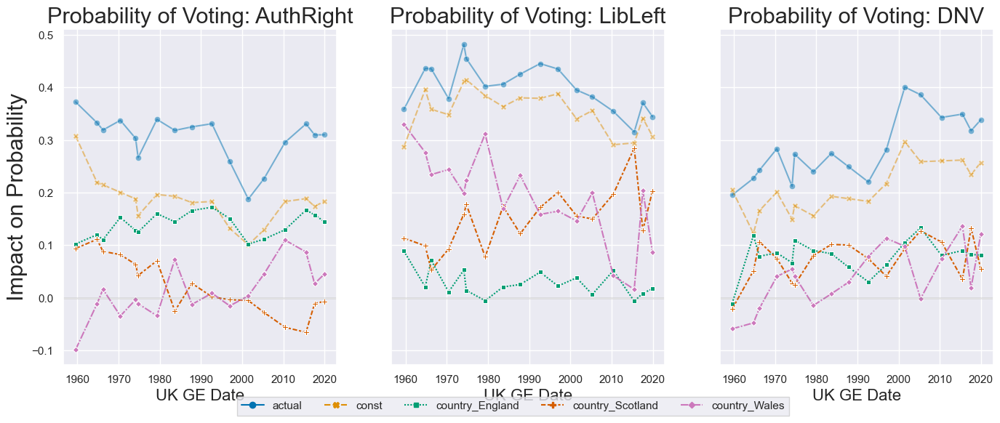

In [142]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["country"], figsize=(16.5, 6),  sharey=True,drop_first=False,)

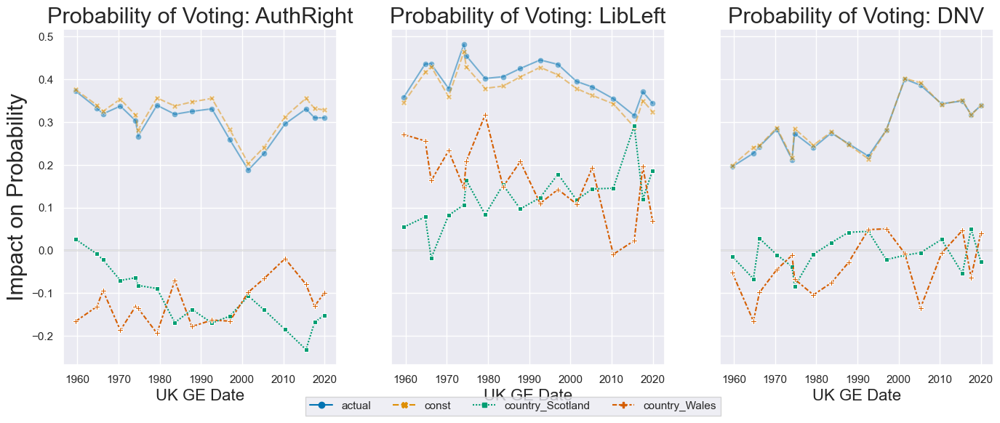

In [143]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["country"], figsize=(16.5, 6),  sharey=True,drop_first=True,)

In [144]:
replace_dict = {'East Midlands':"England", 'Eastern':"England", 'London':"London", 'North East':"England",
                'North West':"England",
       'Scotland':"Scotland", 'South East':"England", 'South West':"England", 'Wales':"Wales", 'West Midlands':"England",
       'Yorks/Humbs':"England", 'London&SE England':"England", 'Northern England':"England",
       'Mid&E England':"England"}
f2f_harmonised["country&London"] = f2f_harmonised["region"].replace( replace_dict )

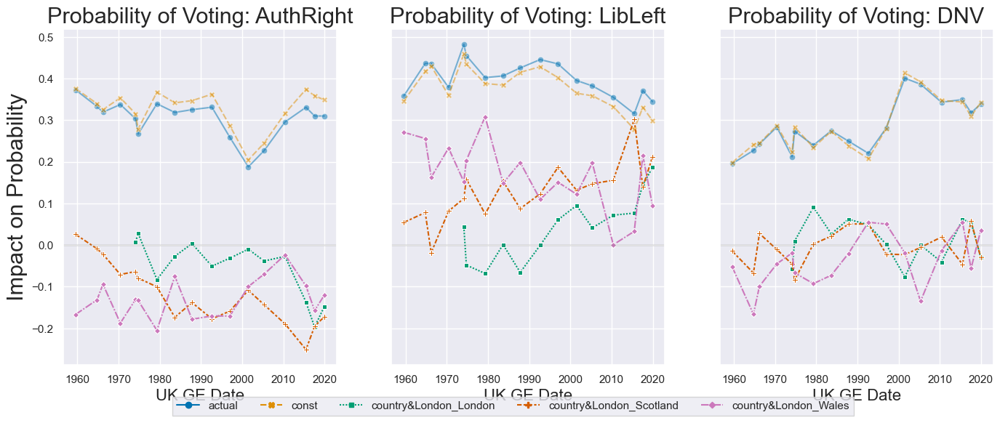

In [145]:
plot_OLS_set(["AuthRight","LibLeft","DNV"], ["country&London"], figsize=(16.5, 6),  sharey=True,drop_first=True,)

In [169]:
residence_type = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\residence_type.zip", compression='zip')
f2f_harmonised[residence_type.columns] = residence_type

In [170]:
hholdsize = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\hholdsize.zip", compression='zip')
f2f_harmonised[hholdsize.columns] = hholdsize

In [171]:
list_of_scale_harm_vars = list_of_scale_harm_vars + ['hhold_size','hhold_size_under18']

In [172]:
scale_cols = f2f_harmonised.columns[f2f_harmonised.describe(include='all').loc['unique']<=2]
f2f_harmonised[[x+"_scl" for x in scale_cols]]= f2f_harmonised[scale_cols].apply(lambda x: x.astype('category').cat.codes).replace(-1,np.nan)

In [173]:
demo_var_dict = pickle.load( open( "E:\\BES_analysis_data\\Face_to_face\\demo_var_dict.pickle", "rb" ) )
# demo_var_dict

In [174]:
generic_cols = f2f_harmonised.columns
drop_vars = [
             "dataset","uid",'vote','year','wt','vote_simple','bloc','vote_complete_simple',
            'wt_norm',
             "turnout_complete",
             'bloc_complete','AuthRight', 'LibLeft', 'DNV', 
             'CON', 'LAB', 'LD', 'REFUK', 'SNP', 'GP', 'DK', 'PC',
            ]
harm_vars = f2f_harmonised.drop(drop_vars,axis=1).columns


# harm_vars = ["wt","age","housing_det",
# #                                   "inc_det","inc",
#                  #,"bloc_complete"
# #                  'gender', 
#                                   'gender_complete', 'age_left_education',
# #            'age_left_education_2', 
#                                   'age_left_education_3', 'anyQuals',
#            'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
#            'other_academic_vocational', 'other_tech_business',
#            'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
#            'trade_appenticeship', 'nursing', 'teachers_training',
#            'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
#            'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
#            'rsa_other_commercial', 'school_cert_or_matric',
#            'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
#            'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
#            'professional_qualification', 'spec_qual_gained_at_work',
#            'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
#            'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5', 
#            'att_university', 'att_commercial_training',
#            'att_polytech_or_techcollege', 'att_night_school',
#            'att_non_voc_training', 'att_other', 'att_art_school',
#            'att_college_of_commerce', 'att_teacher_training',
#            'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
#            'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
#            'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
#            'school_fees', 'school_fees_when', 'school_where', 'school_type_2','inc_norm_wt',
#            'region_harm',  'tumember',
#            'tumember_det', 'marital', 'marital_det','ethnic_det','relig_det',
# #               'ec_left_right_complete','soc_lib_auth_complete','subjClass'
#             ]

ed_vars = ['anyQuals', 'rsa_or_city_and_guilds', 'overseas_other_postschl',
       'overseas_degree', 'other_academic_vocational', 'other_tech_business',
       'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
       'trade_appenticeship', 'nursing', 'teachers_training',
       'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
       'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
       'rsa_other_commercial', 'school_cert_or_matric',
       'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
       'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
       'professional_qualification', 'spec_qual_gained_at_work',
       'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
       'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5',
       'att_university', 'att_commercial_training',
       'att_polytech_or_techcollege', 'att_night_school',
       'att_non_voc_training', 'att_other', 'att_art_school',
       'att_college_of_commerce', 'att_teacher_training',
       'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
       'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
       'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
       'school_fees', 'school_fees_when', 'school_where', 'school_type_2']
f2f_harmonised[ ed_vars ] = f2f_harmonised[ ed_vars ].astype('category')

In [175]:
f2f_harmonised[f2f_harmonised.select_dtypes('bool').columns] = f2f_harmonised[f2f_harmonised.select_dtypes('bool').columns].astype('float')
#= f2f_harmonised.select_dtypes('bool').astype('float')

In [176]:
generic_cols = f2f_harmonised.columns
list_of_scale_harm_vars = ["Age","year_past_min_sch_leave_age","in_school_past_min_age",'soc_lib_auth_complete', 'ec_left_right_complete',]
list_of_scale_harm_vars = list_of_scale_harm_vars+[x+"_scl" for x in scale_cols]

# def run_ge_regression(ge,target_var,demo_var_only=True,min_features=10,
#                       harmonised_only=False,drop_vars = [],get_predictions=False,dependence_plots=False,
#                      harm_vars = ["wt","age","housing_det",
# #                                   "inc_det","inc",
#                  #,"bloc_complete"
# #                  'gender', 
#                                   'gender_complete', 'age_left_education',
# #            'age_left_education_2', 
#                                   'age_left_education_3', 'anyQuals',
#            'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
#            'other_academic_vocational', 'other_tech_business',
#            'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
#            'trade_appenticeship', 'nursing', 'teachers_training',
#            'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
#            'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
#            'rsa_other_commercial', 'school_cert_or_matric',
#            'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
#            'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
#            'professional_qualification', 'spec_qual_gained_at_work',
#            'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
#            'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5', 
#            'att_university', 'att_commercial_training',
#            'att_polytech_or_techcollege', 'att_night_school',
#            'att_non_voc_training', 'att_other', 'att_art_school',
#            'att_college_of_commerce', 'att_teacher_training',
#            'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
#            'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
#            'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
#            'school_fees', 'school_fees_when', 'school_where', 'school_type_2','inc_norm_wt',
#             'ec_left_right_complete','soc_lib_auth_complete'],
#                 pre_mask = None
                     
                     
#                      ):

#     target_var = target_var
#     harm_vars = harm_vars + [target_var]
#     target_var_replace_dict = {}
#     target_var_drop_list = []
#     target_var_title_pair = ["Lower Income","Higher Income"]
#     var_stub = target_var
#     min_features = min_features
#     drop_vars = drop_vars
#     drop_std_thresh = 0

#     alg = get_xgboost_alg(classification_problem=False)
#     demo_var_only=demo_var_only
#     dependence_plots=dependence_plots

#     # find variables with no coverage/variation in focal instances (mask)
#     df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
#            var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,
#                            harmonised_only=harmonised_only,
#                           )
#     if get_predictions:
#         mask = df_pred[target_var].isnull()
#     else:
#         mask = df_pred[target_var].notnull()
        
#     if pre_mask is not None:
#         mask = mask&(pre_mask[f2f_harmonised["dataset"]==ge].values)
#     stds = df_pred[mask].std()
#     drop_vars = drop_vars + list(stds[stds.isnull()].index)+list(stds[stds<=drop_std_thresh].index)
#     drop_vars = [x for x in drop_vars if x not in ["wt",var_stub]]

#     (explainer, shap_values, train_columns, train_index, alg,output_subfolder) = prep_df(ge,target_var,target_var_replace_dict,
#                                                                                          target_var_drop_list,target_var_title_pair,
#            var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,alg=alg,
#                                                                                         harmonised_only=harmonised_only)

#     if get_predictions:
#         # setup df back up
#         df_pred = prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
#                var_stub,harm_vars,min_features,dependence_plots=dependence_plots,drop_vars=drop_vars,demo_var_only=demo_var_only,
#                               harmonised_only=harmonised_only)
#         # # use fitted algorithm to predict values
#         predictions = pd.Series(alg.predict(df_pred[train_columns]),index=df_pred[target_var].index)#.round()
#         return predictions,shap_values,train_columns
#         # inc_pred = pd.Series(alg.predict(df_pred[train_columns]),index=inc.index).round()
#         # income_var_df_sm.loc[income_var_df_sm[ge].isnull(),ge] = pd.Series(inc_pred,index=income_var_df_sm[ge].index).apply(round)[income_var_df_sm[ge].isnull()]

In [177]:
replace_dict = {'15 or younger':"18-", '16':"18-", '19 or older':"19+", '18':"18-"}
# f2f_harmonised["age_left_education_3"].value_counts().index
f2f_harmonised["left_ed"] = f2f_harmonised["age_left_education_3"].replace(replace_dict)

In [178]:
f2f_harmonised = f2f_harmonised.rename(columns={'country':'reg_country'})

In [179]:
generic_cols = f2f_harmonised.columns
harm_vars = ["wt","age","housing_det",
#                                   "inc_det","inc",
                 #,"bloc_complete"
#                  'gender', 
                                  'gender_complete', 'age_left_education',
#            'age_left_education_2', 
                                  'age_left_education_3', 'anyQuals',
           'rsa_or_city_and_guilds', 'overseas_other_postschl', 'overseas_degree',
           'other_academic_vocational', 'other_tech_business',
           'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
           'trade_appenticeship', 'nursing', 'teachers_training',
           'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
           'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
           'rsa_other_commercial', 'school_cert_or_matric',
           'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
           'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
           'professional_qualification', 'spec_qual_gained_at_work',
           'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
           'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5', 
           'att_university', 'att_commercial_training',
           'att_polytech_or_techcollege', 'att_night_school',
           'att_non_voc_training', 'att_other', 'att_art_school',
           'att_college_of_commerce', 'att_teacher_training',
           'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
           'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
           'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
           'school_fees', 'school_fees_when', 'school_where', 'school_type_2','inc_norm_wt',
        'unconventional',
       'ordinary', 'rich', 'respect', 'censorship', 'strongtu', 'enterprise',
       'toughlaw', 'death', 
#              'ec_left_right', 'soc_lib_auth',
       'soc_lib_auth_complete', 'ec_left_right_complete',
#              'wt_norm',
       'relig_det', 'relig_simple', 'relig_crude', 'ethnic_det',
       'ethnic_binary', 'tumember', 'tumember_det', 'tumember_simple',
       'marital', 'marital_det', 'subjClass', 'region', 'reg_country',
       'country&London',"left_ed",
            ]+[x+"_scl" for x in scale_cols]

ed_vars = ['anyQuals', 'rsa_or_city_and_guilds', 'overseas_other_postschl',
       'overseas_degree', 'other_academic_vocational', 'other_tech_business',
       'higher_onc_ond_bec_tec', 'ordinary_gen_onc_ond_bec_tec',
       'trade_appenticeship', 'nursing', 'teachers_training',
       'city_and_guilds_cert_part1', 'city_and_guilds_full_tech',
       'city_and_guilds_advanced_final', 'city_and_guilds_craft_ordinary',
       'rsa_other_commercial', 'school_cert_or_matric',
       'uni_cnaa_degree_or_diploma', 'os_schl_leav_qual',
       'a_level_scot_higher', 'cse_grade_1_scot_lower', 'cse_grade_2_5',
       'professional_qualification', 'spec_qual_gained_at_work',
       'other_qualification', 'highest_qualification', 'nvq_sqv_l1',
       'nvq_sqv_l2', 'nvq_sqv_l3', 'nvq_sqv_l4', 'nvq_sqv_l5',
       'att_university', 'att_commercial_training',
       'att_polytech_or_techcollege', 'att_night_school',
       'att_non_voc_training', 'att_other', 'att_art_school',
       'att_college_of_commerce', 'att_teacher_training',
       'att_trade_military_apprent', 'att_tech_college_teacher_nursing',
       'att_tech_or_occ_training', 'att_summer_schl_corresp_courses',
       'att_NoFE', 'att_forces_training', 'school_type', 'school_selective',
       'school_fees', 'school_fees_when', 'school_where', 'school_type_2']
f2f_harmonised[ ed_vars ] = f2f_harmonised[ ed_vars ].astype('category')

AuthRight
***************************
1959
***************************
MSE: 0.18, MAE: 0.36, EV: 0.22, R2: 0.22


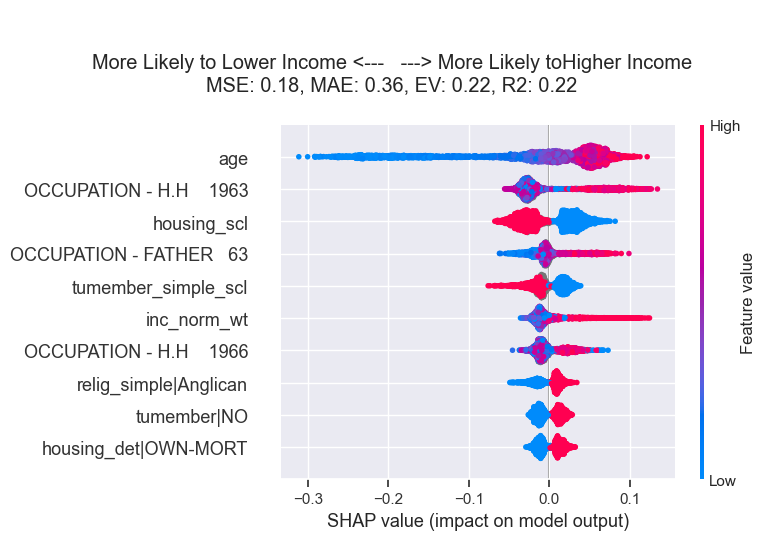

***************************
1964
***************************
MSE: 0.19, MAE: 0.38, EV: 0.19, R2: 0.19


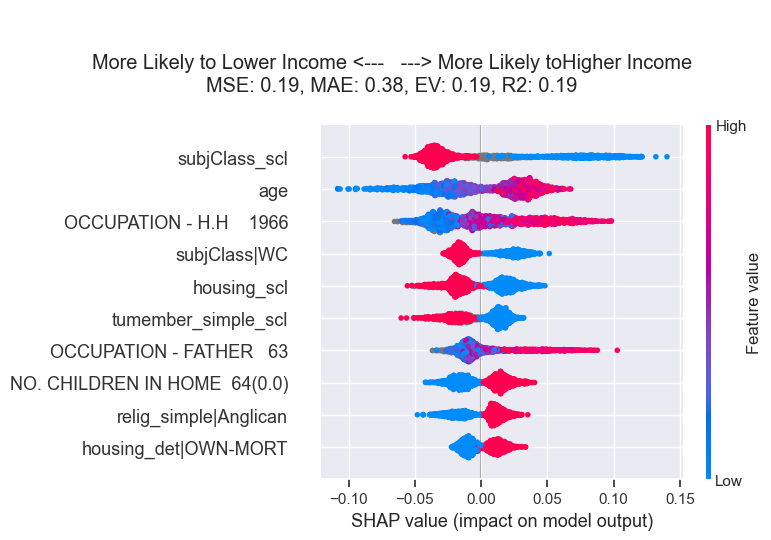

***************************
1966
***************************
MSE: 0.20, MAE: 0.38, EV: 0.14, R2: 0.14


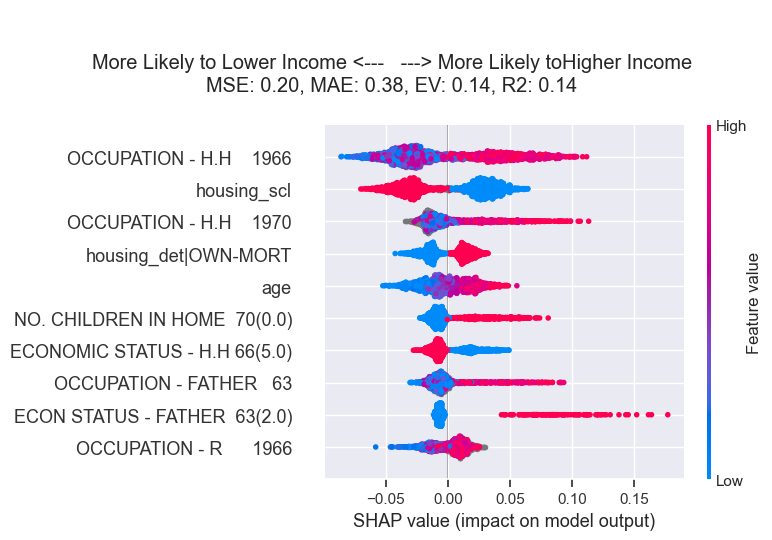

***************************
1970
***************************
MSE: 0.23, MAE: 0.45, EV: 0.06, R2: 0.06


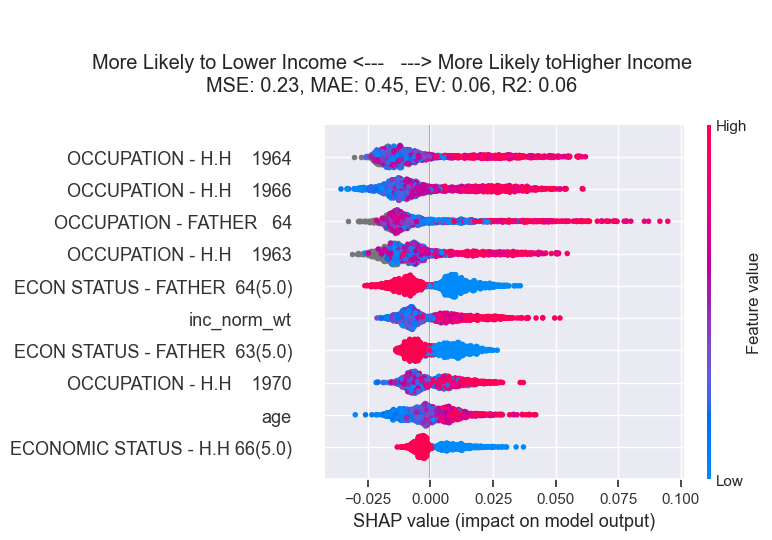

***************************
1974_oct
***************************
MSE: 0.18, MAE: 0.35, EV: 0.15, R2: 0.15


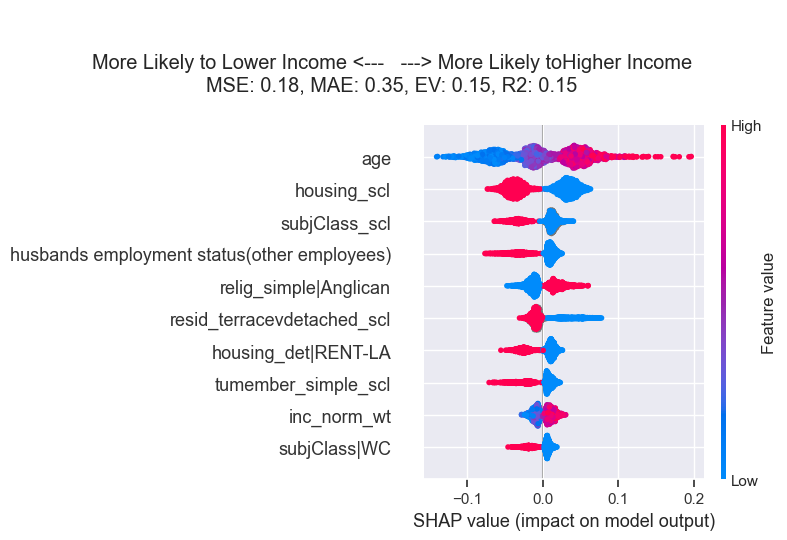

***************************
1974_feb
***************************
MSE: 0.19, MAE: 0.37, EV: 0.15, R2: 0.15


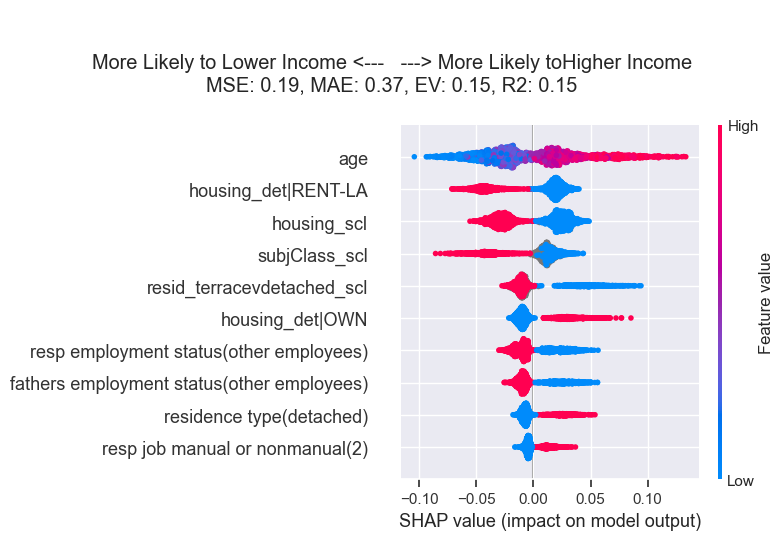

***************************
1979
***************************
MSE: 0.21, MAE: 0.41, EV: 0.14, R2: 0.14


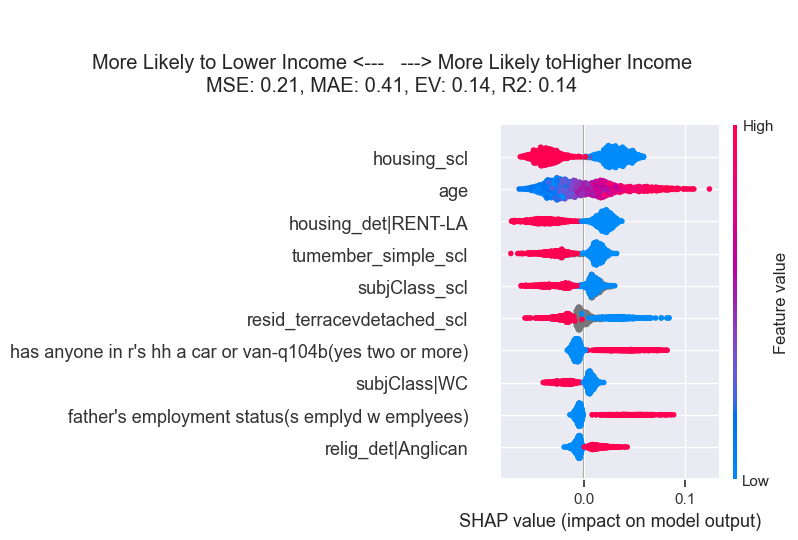

***************************
1983
***************************
MSE: 0.20, MAE: 0.39, EV: 0.14, R2: 0.14


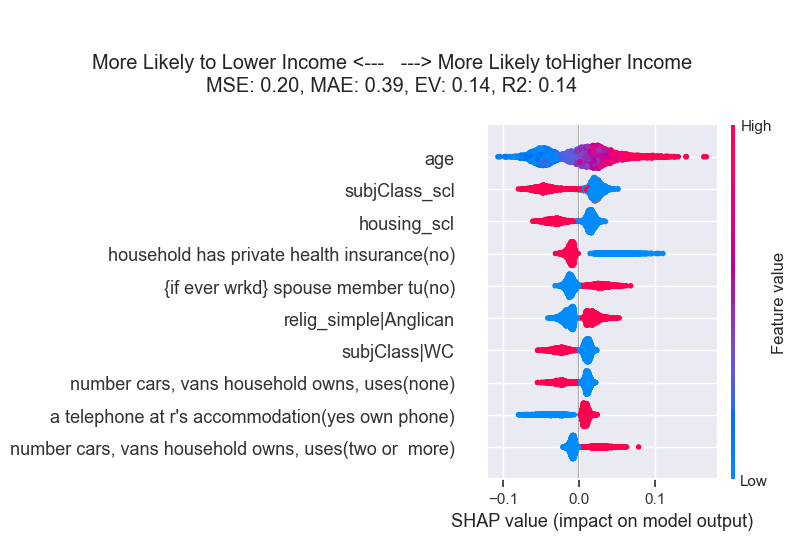

***************************
1987
***************************
MSE: 0.17, MAE: 0.33, EV: 0.29, R2: 0.29


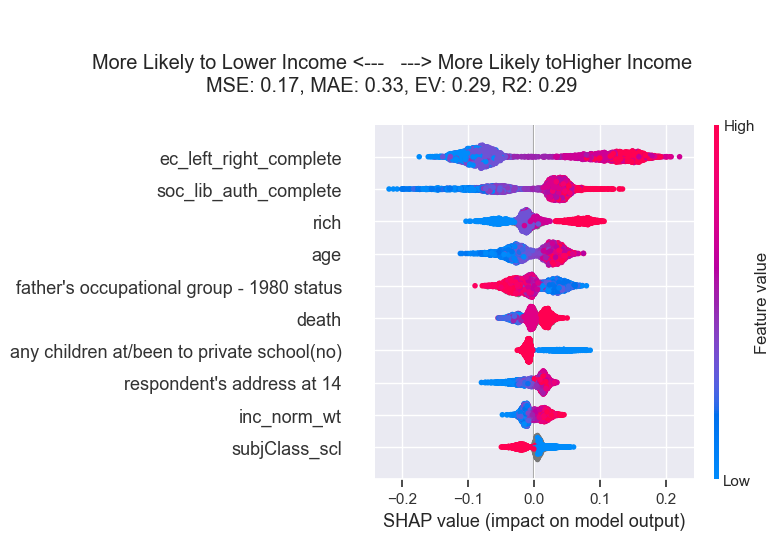

***************************
1992
***************************
MSE: 0.14, MAE: 0.28, EV: 0.39, R2: 0.39


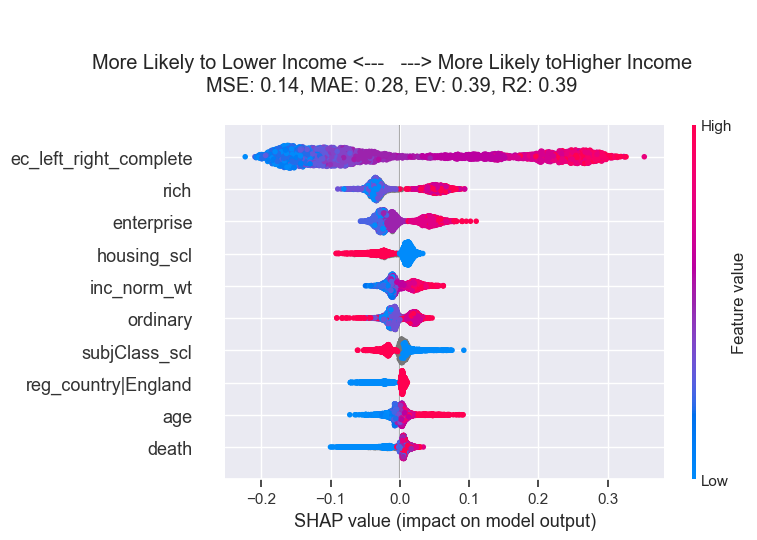

***************************
1997
***************************
MSE: 0.12, MAE: 0.25, EV: 0.34, R2: 0.34


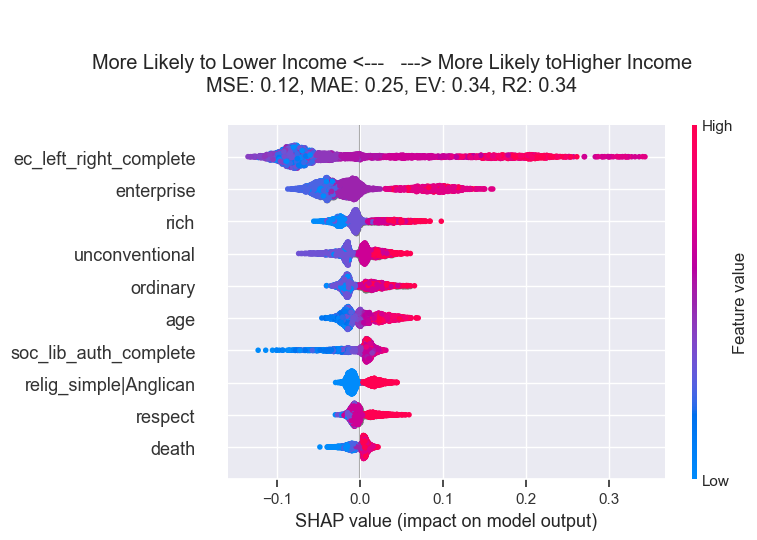

***************************
2001
***************************
MSE: 0.12, MAE: 0.24, EV: 0.21, R2: 0.21


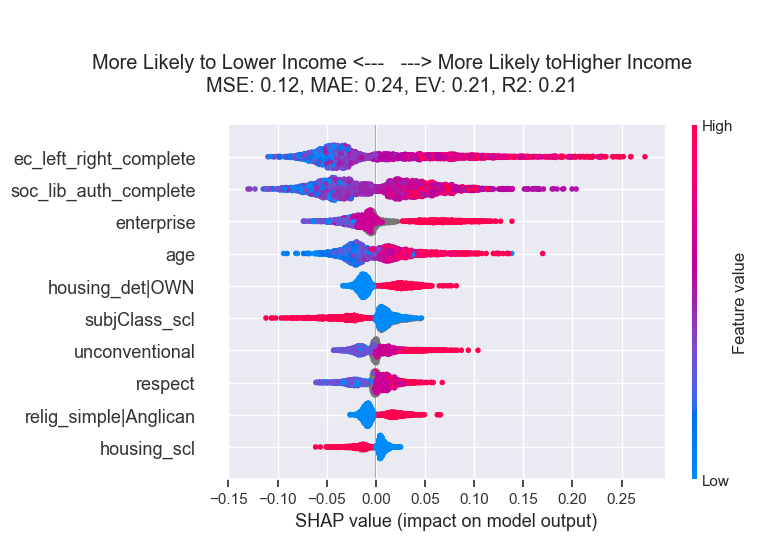

***************************
2005
***************************
MSE: 0.14, MAE: 0.28, EV: 0.21, R2: 0.21


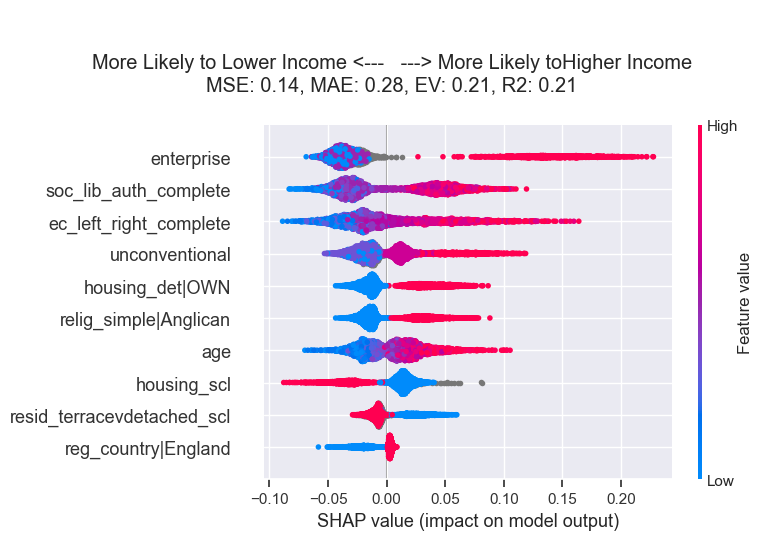

***************************
2010
***************************
MSE: 0.15, MAE: 0.31, EV: 0.27, R2: 0.27


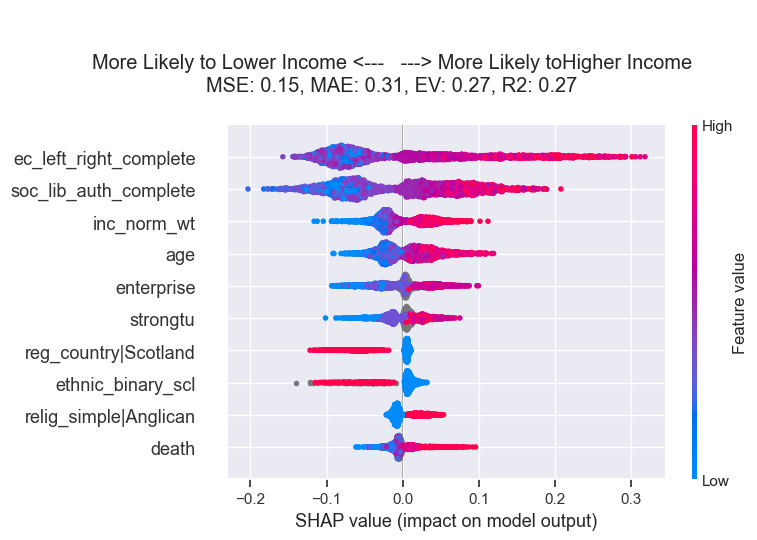

***************************
2015
***************************
MSE: 0.18, MAE: 0.34, EV: 0.25, R2: 0.24


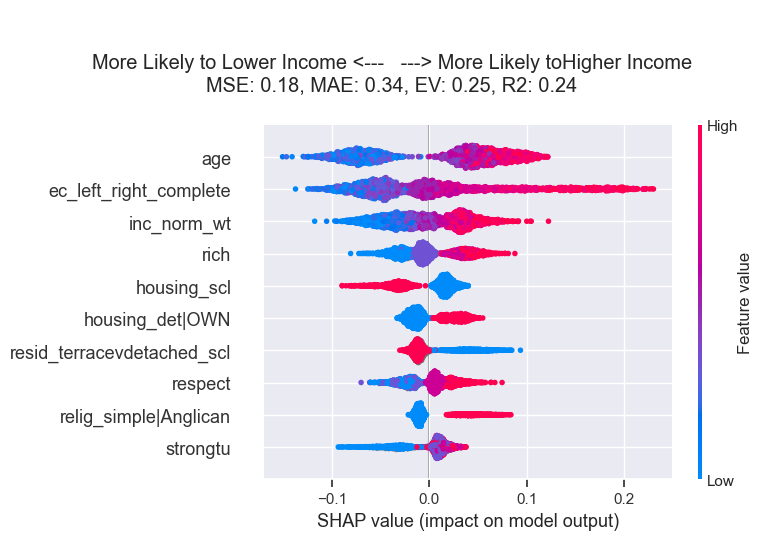

***************************
2017
***************************
MSE: 0.16, MAE: 0.32, EV: 0.30, R2: 0.30


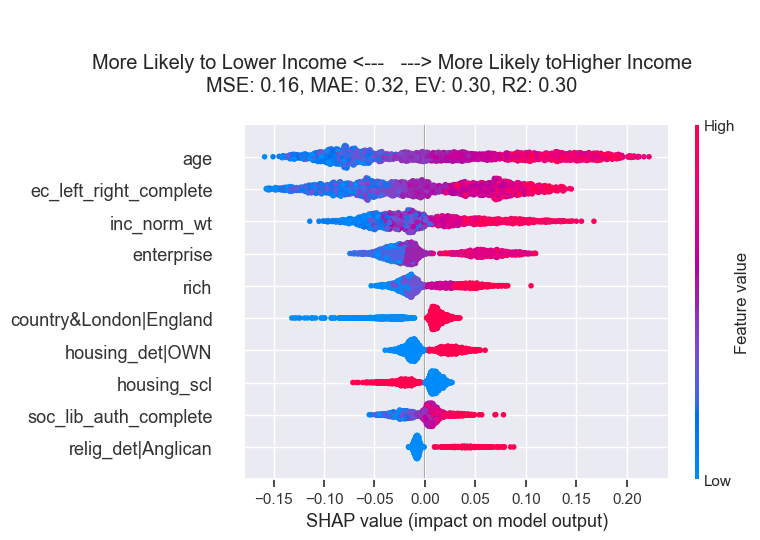

***************************
2019
***************************
MSE: 0.17, MAE: 0.33, EV: 0.28, R2: 0.28


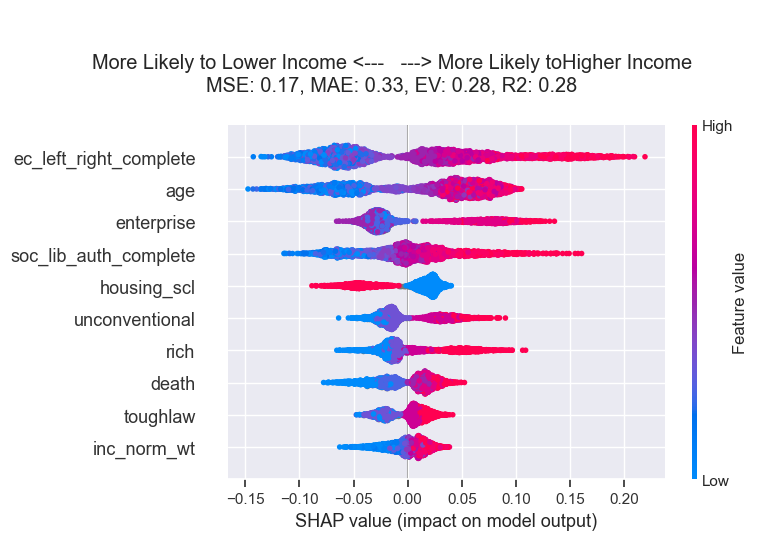

LibLeft
***************************
1959
***************************
MSE: 0.18, MAE: 0.36, EV: 0.22, R2: 0.22


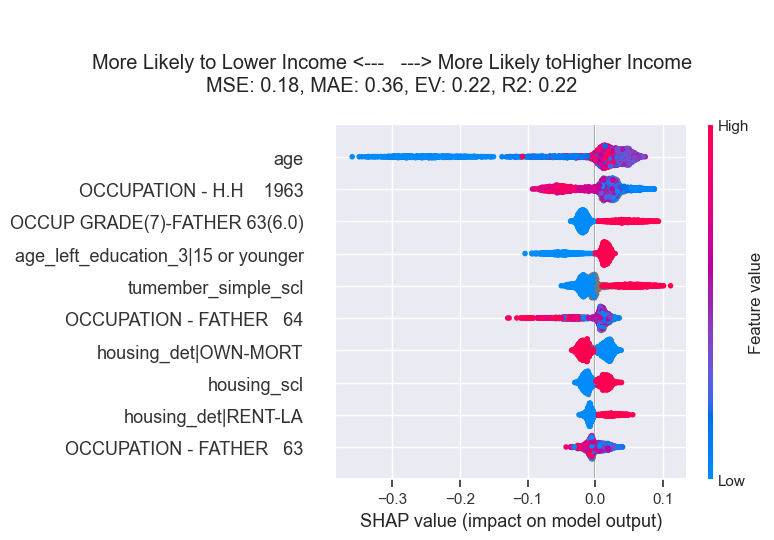

***************************
1964
***************************
MSE: 0.22, MAE: 0.43, EV: 0.14, R2: 0.12


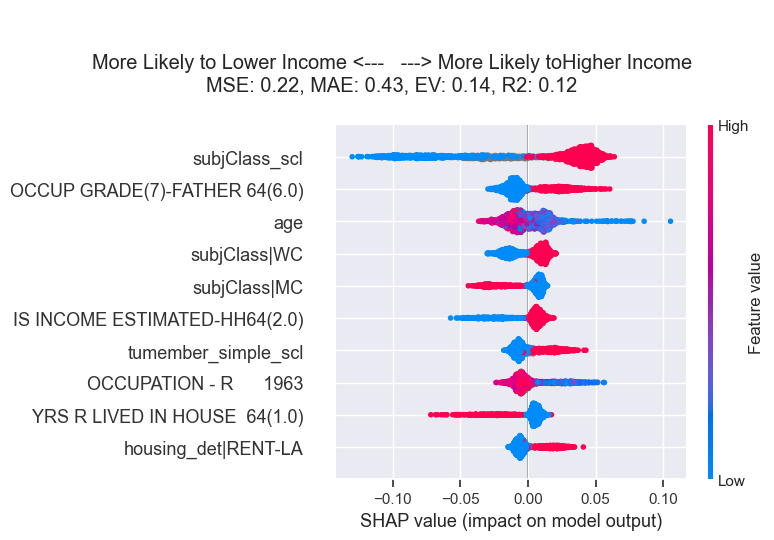

***************************
1966
***************************
MSE: 0.23, MAE: 0.45, EV: 0.08, R2: 0.08


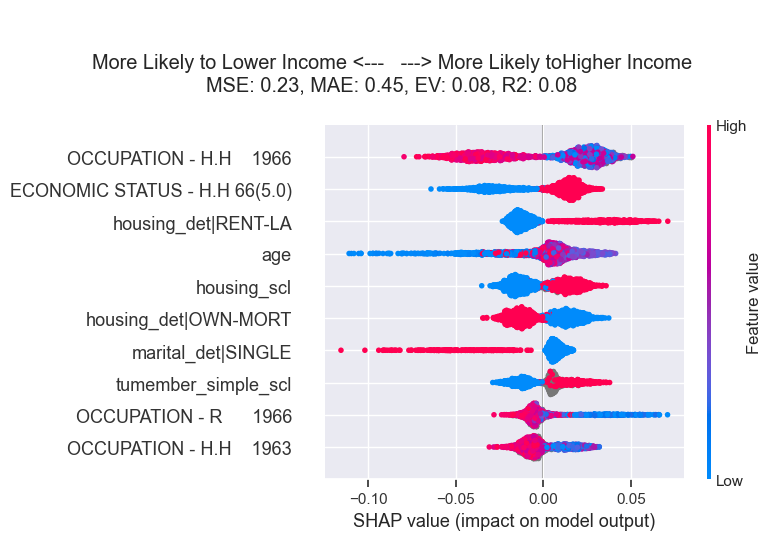

***************************
1970
***************************
MSE: 0.24, MAE: 0.47, EV: 0.04, R2: 0.04


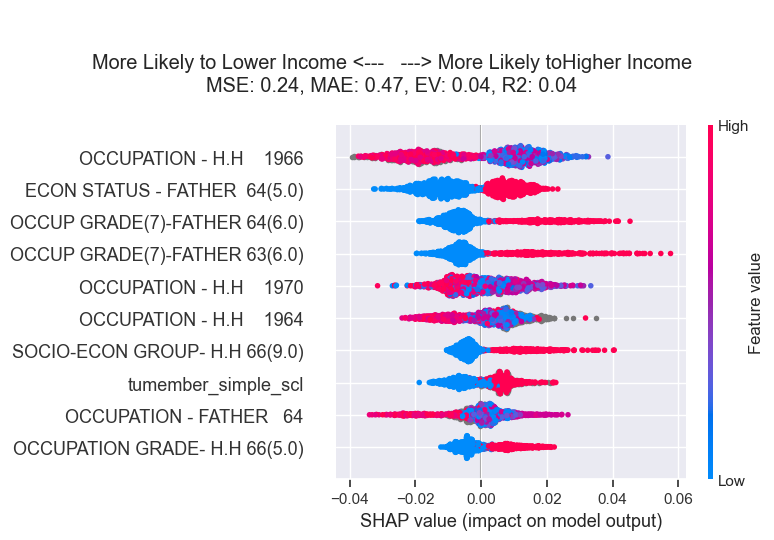

***************************
1974_oct
***************************
MSE: 0.22, MAE: 0.45, EV: 0.11, R2: 0.10


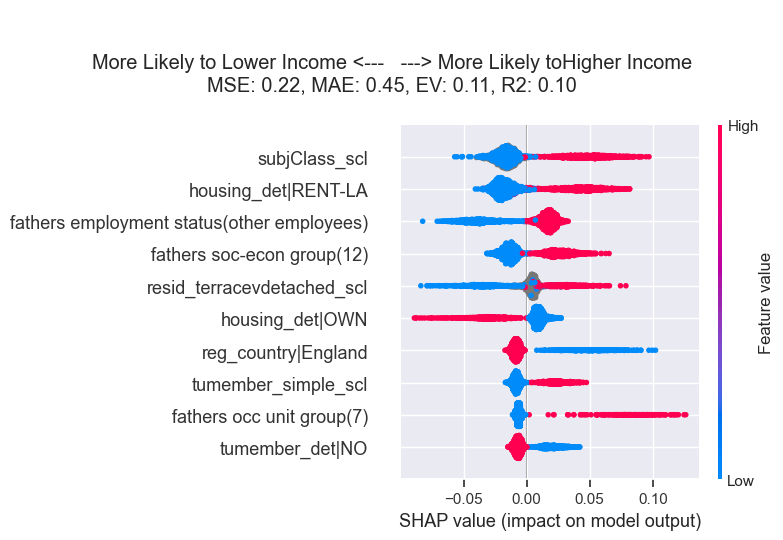

***************************
1974_feb
***************************
MSE: 0.22, MAE: 0.44, EV: 0.13, R2: 0.13


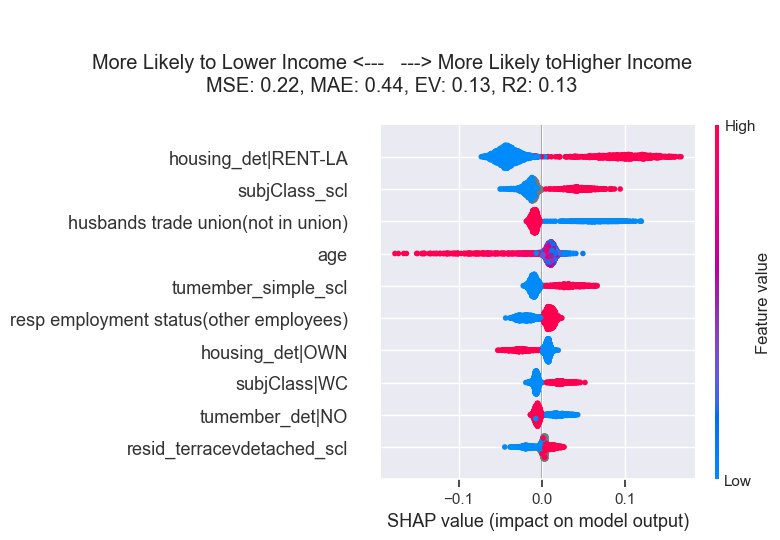

***************************
1979
***************************
MSE: 0.22, MAE: 0.45, EV: 0.09, R2: 0.09


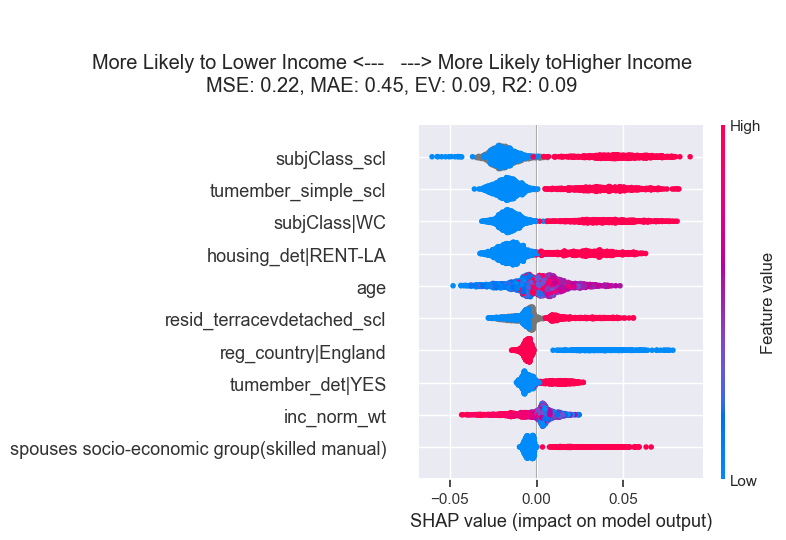

***************************
1983
***************************
MSE: 0.23, MAE: 0.44, EV: 0.10, R2: 0.09


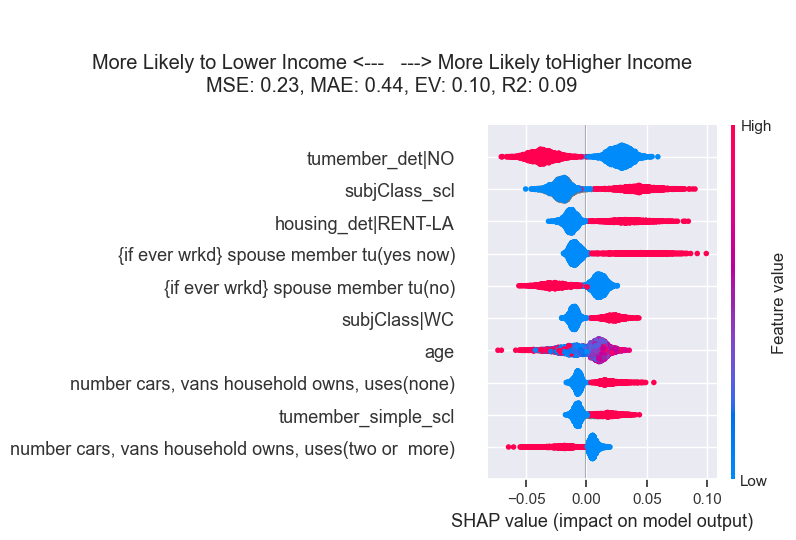

***************************
1987
***************************
MSE: 0.20, MAE: 0.39, EV: 0.21, R2: 0.21


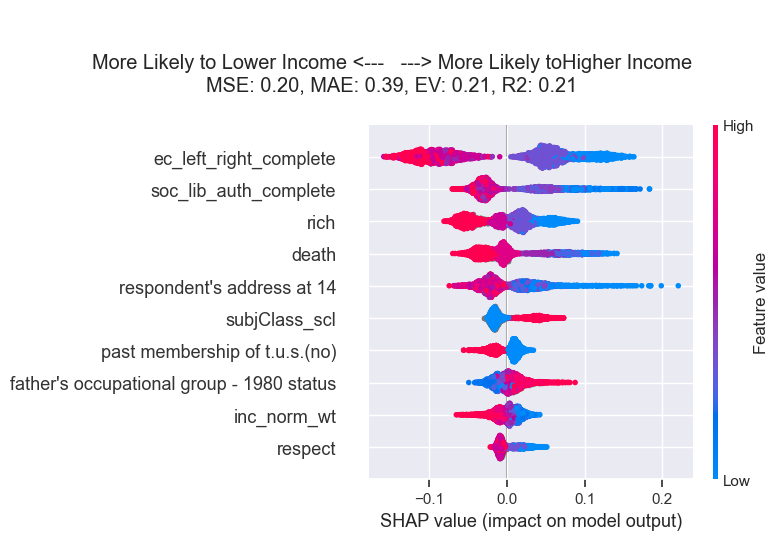

***************************
1992
***************************
MSE: 0.17, MAE: 0.35, EV: 0.31, R2: 0.30


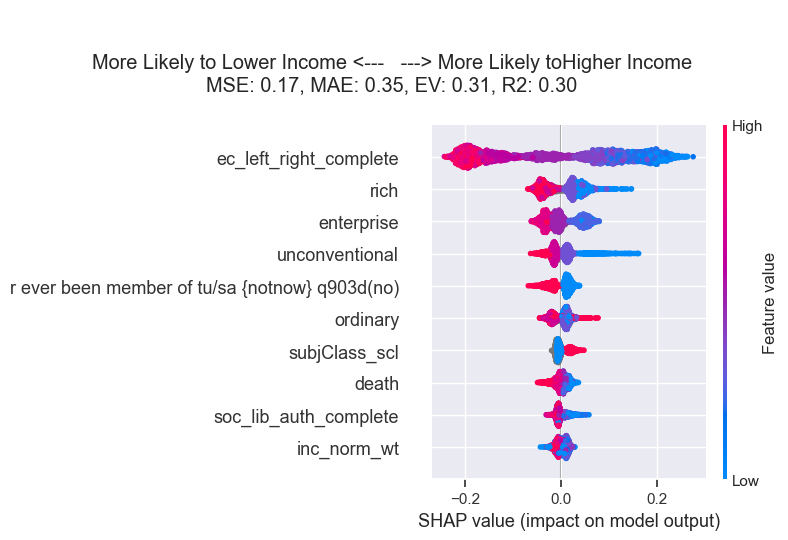

***************************
1997
***************************
MSE: 0.20, MAE: 0.40, EV: 0.20, R2: 0.18


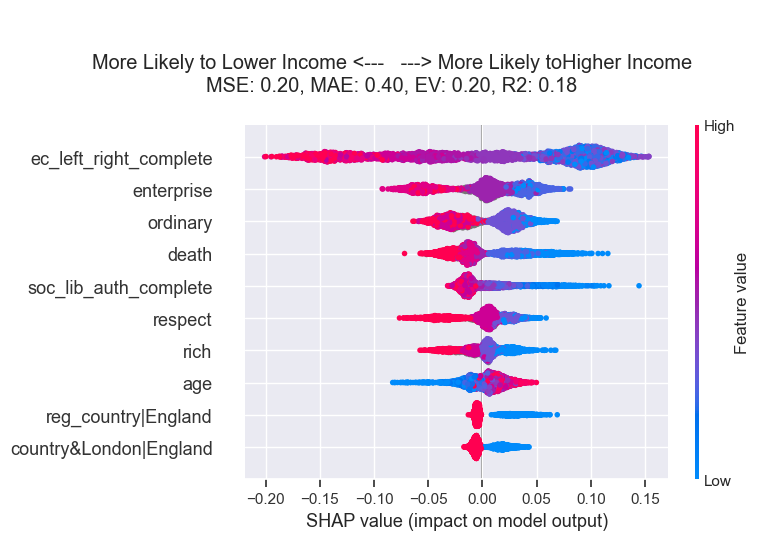

***************************
2001
***************************
MSE: 0.23, MAE: 0.45, EV: 0.12, R2: 0.09


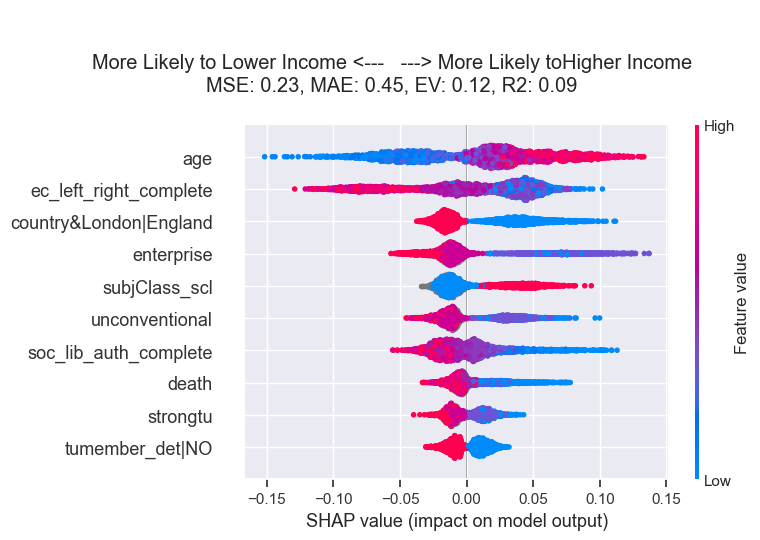

***************************
2005
***************************
MSE: 0.23, MAE: 0.44, EV: 0.11, R2: 0.10


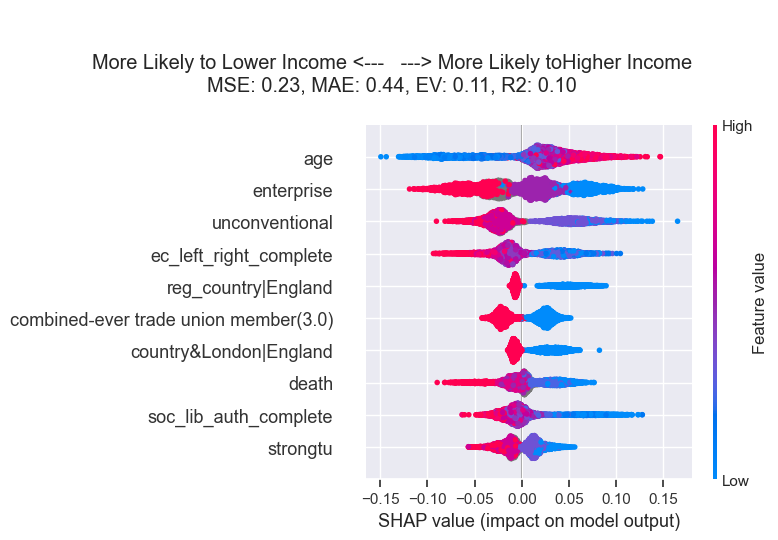

***************************
2010
***************************
MSE: 0.20, MAE: 0.39, EV: 0.19, R2: 0.18


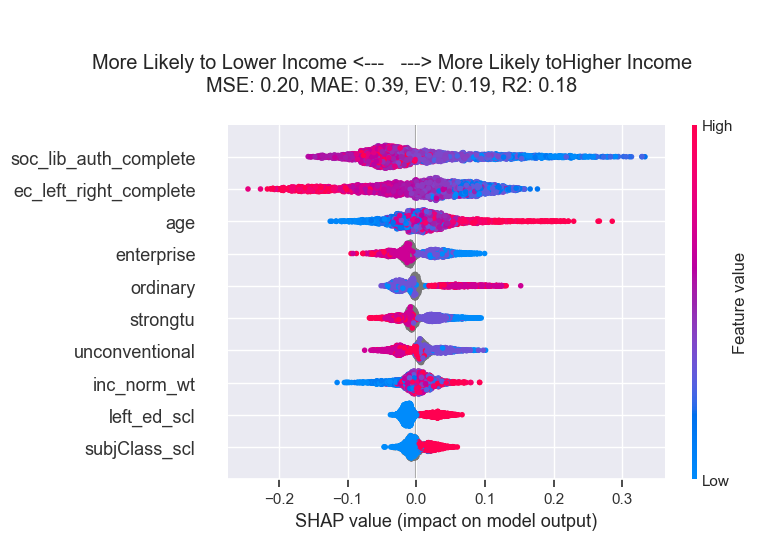

***************************
2015
***************************
MSE: 0.20, MAE: 0.40, EV: 0.12, R2: 0.12


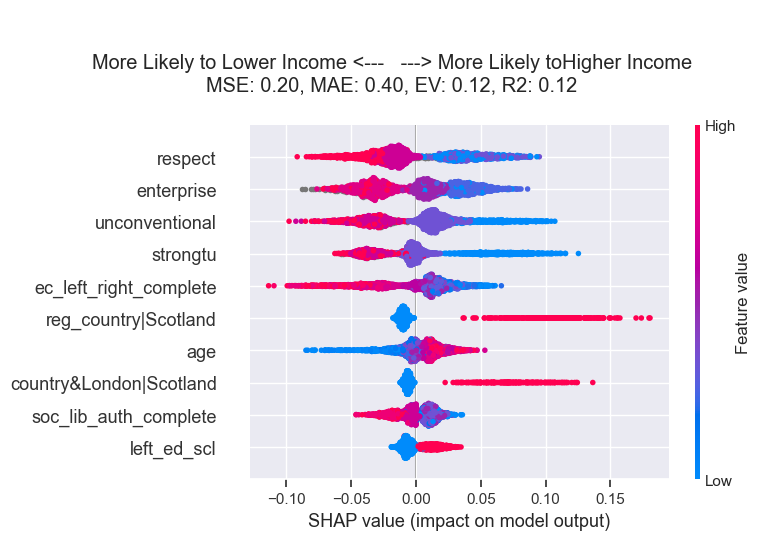

***************************
2017
***************************
MSE: 0.20, MAE: 0.39, EV: 0.19, R2: 0.19


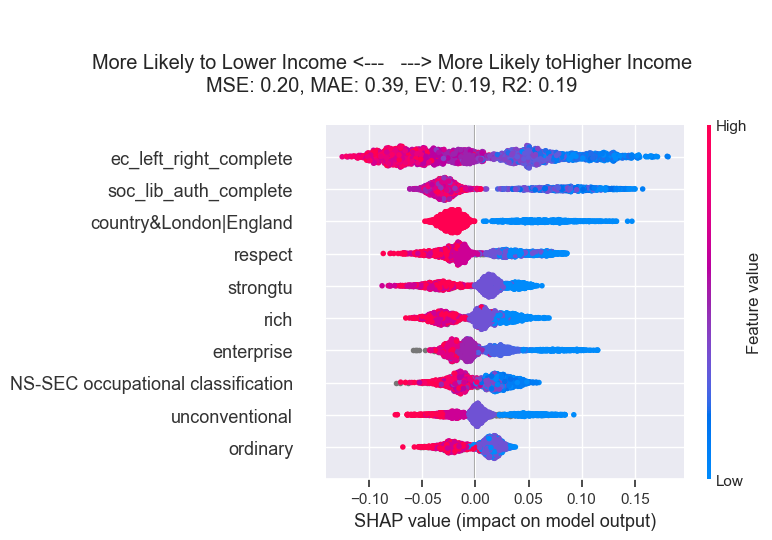

***************************
2019
***************************
MSE: 0.17, MAE: 0.32, EV: 0.31, R2: 0.31


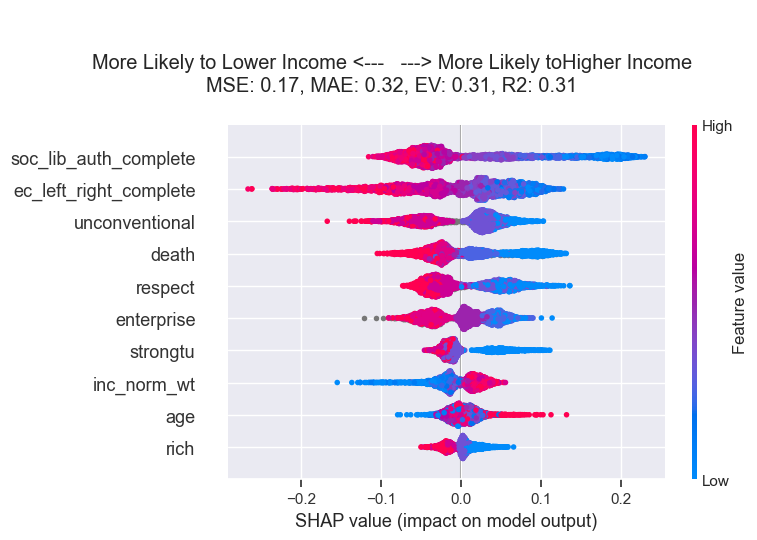

DNV
***************************
1959
***************************
MSE: 0.11, MAE: 0.25, EV: 0.11, R2: 0.09


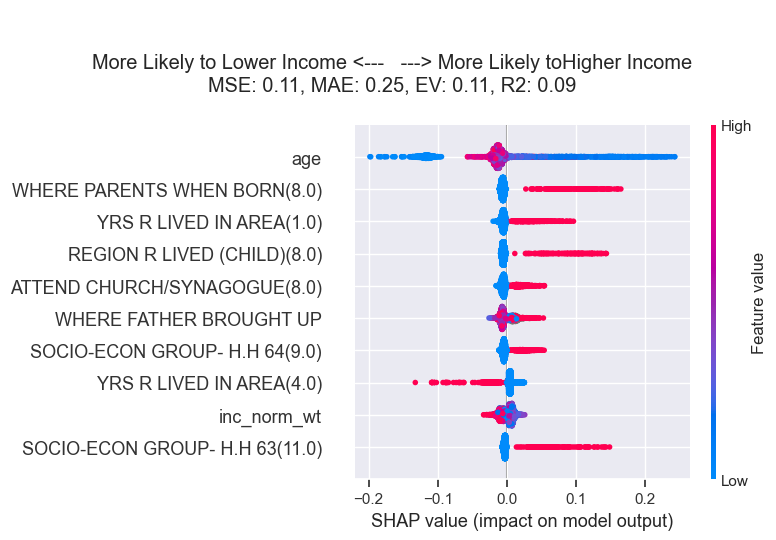

***************************
1964
***************************
MSE: 0.11, MAE: 0.23, EV: -0.07, R2: -0.10


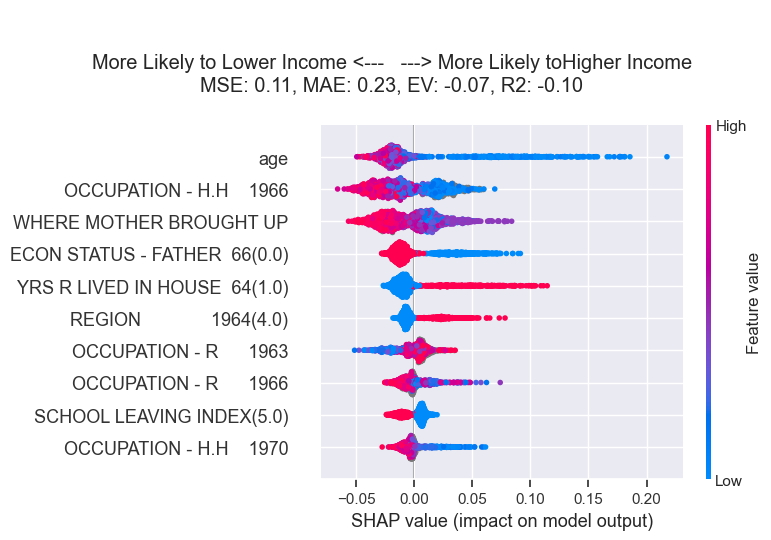

***************************
1966
***************************
MSE: 0.12, MAE: 0.26, EV: 0.01, R2: -0.02


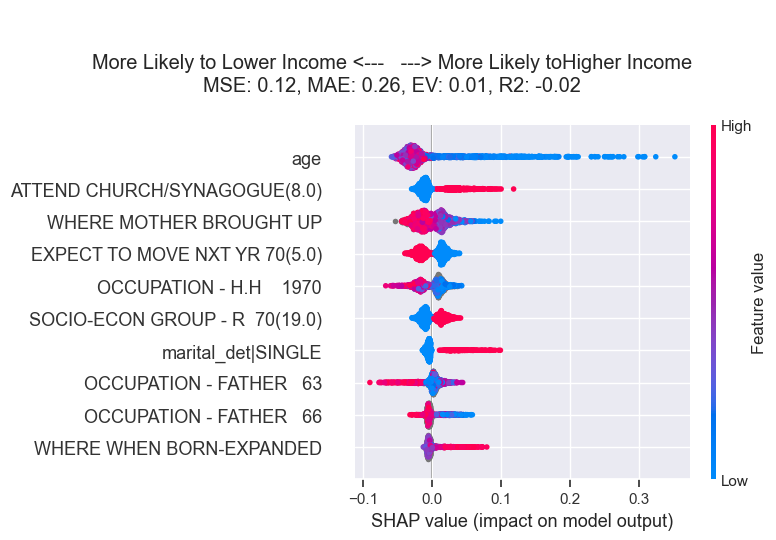

***************************
1970
***************************
MSE: 0.15, MAE: 0.31, EV: -0.06, R2: -0.09


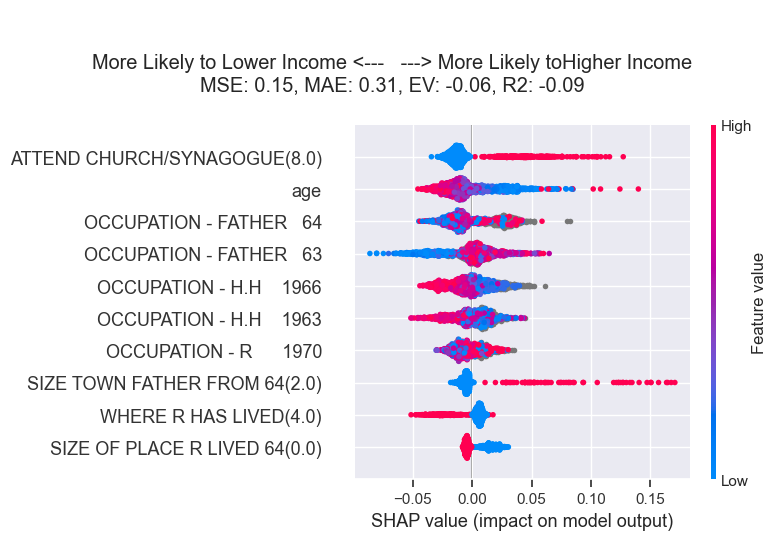

***************************
1974_oct
***************************
MSE: 0.13, MAE: 0.30, EV: 0.02, R2: -0.03


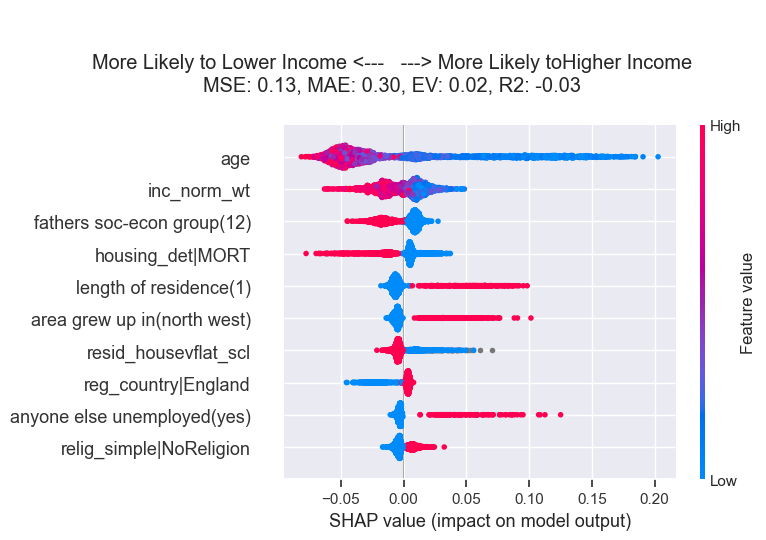

***************************
1974_feb
***************************
MSE: 0.11, MAE: 0.24, EV: -0.00, R2: -0.03


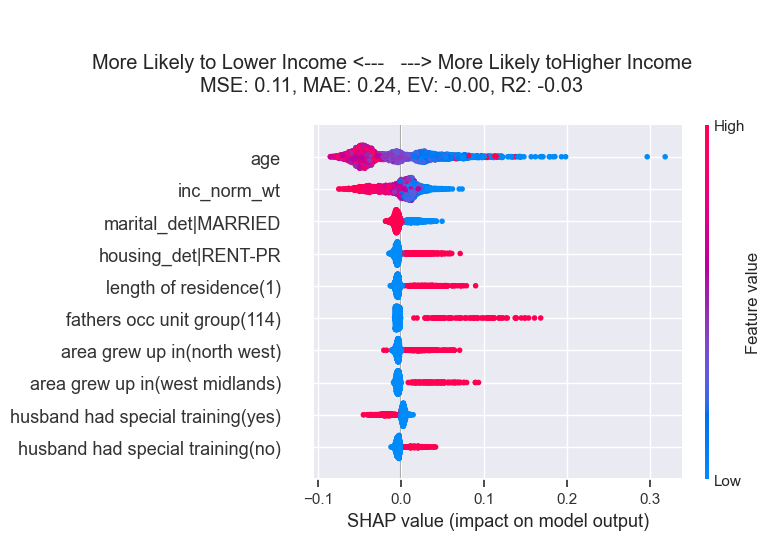

***************************
1979
***************************
MSE: 0.13, MAE: 0.28, EV: 0.04, R2: 0.01


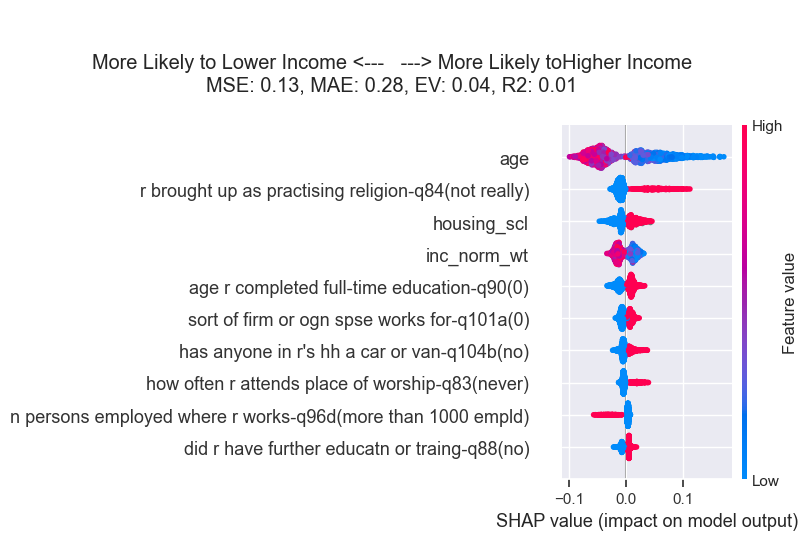

***************************
1983
***************************
MSE: 0.15, MAE: 0.32, EV: -0.00, R2: -0.04


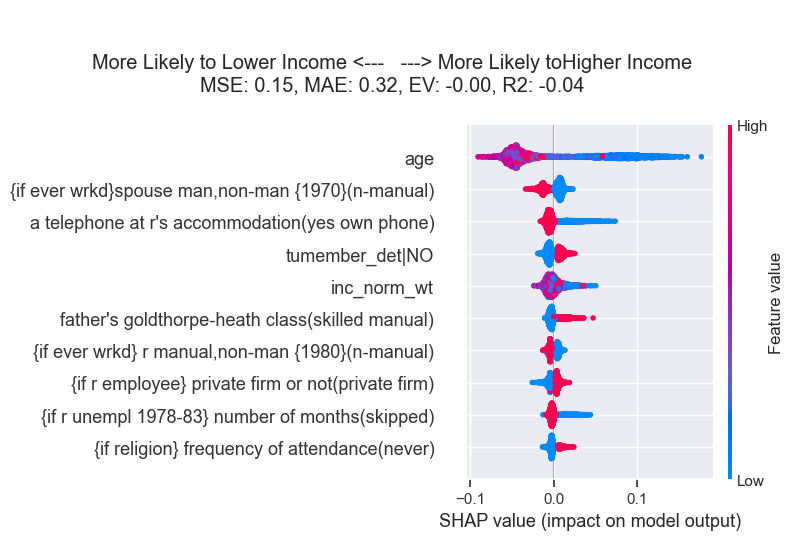

***************************
1987
***************************
MSE: 0.12, MAE: 0.27, EV: 0.01, R2: -0.02


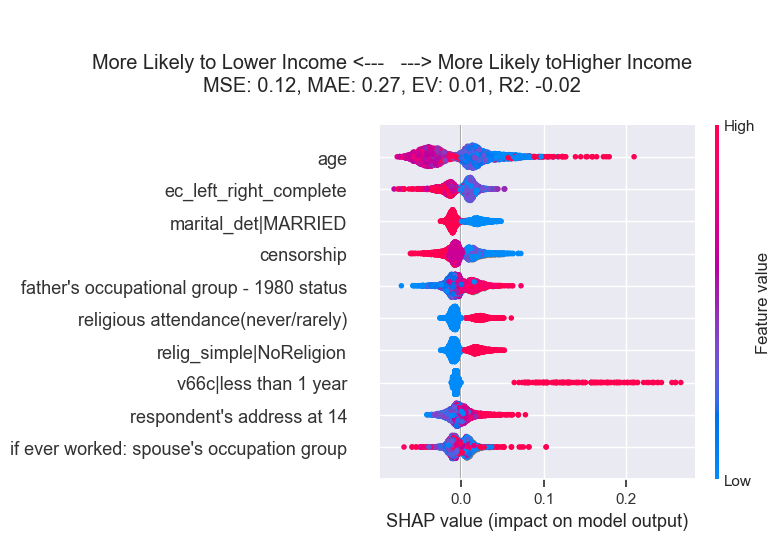

***************************
1992
***************************
MSE: 0.12, MAE: 0.26, EV: 0.03, R2: -0.01


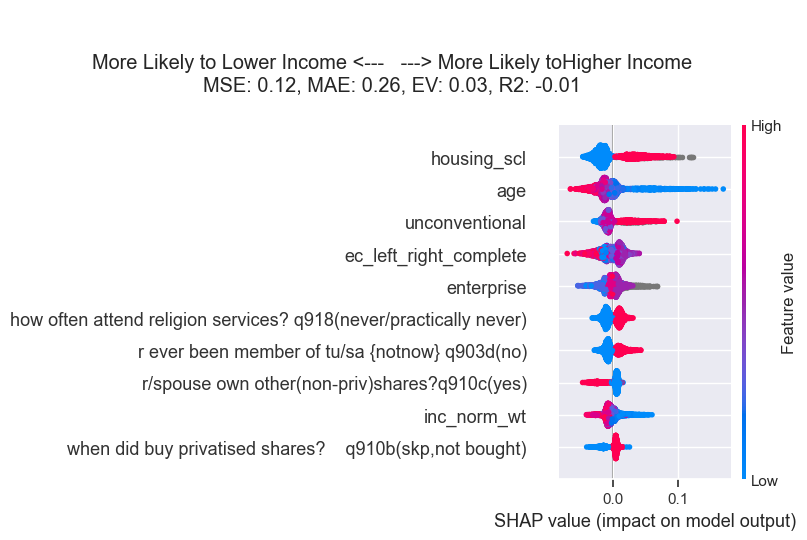

***************************
1997
***************************
MSE: 0.14, MAE: 0.31, EV: 0.06, R2: 0.03


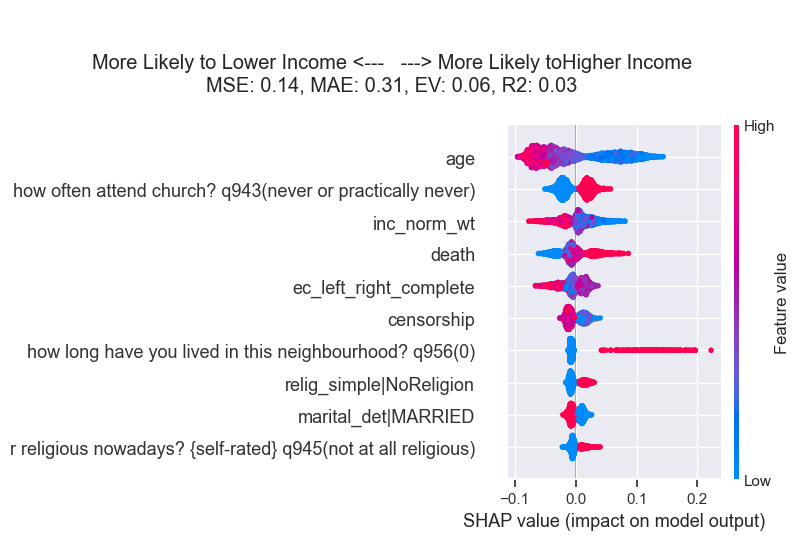

***************************
2001
***************************
MSE: 0.19, MAE: 0.38, EV: 0.09, R2: 0.06


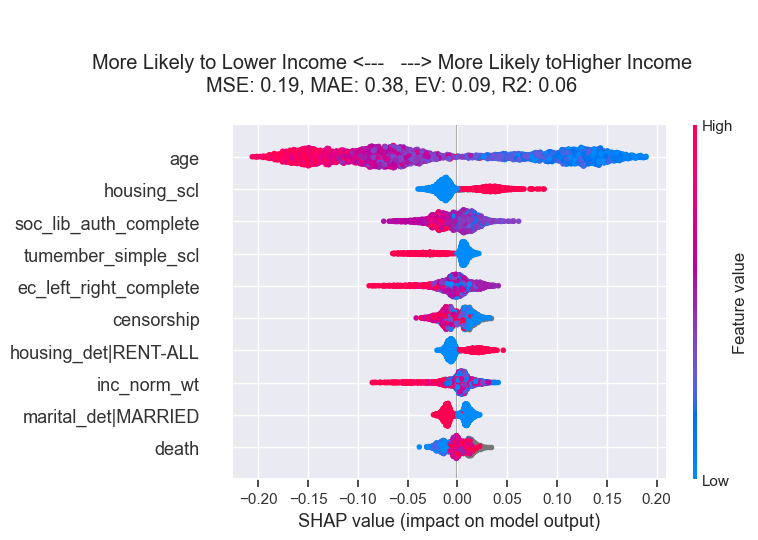

***************************
2005
***************************
MSE: 0.17, MAE: 0.34, EV: 0.15, R2: 0.13


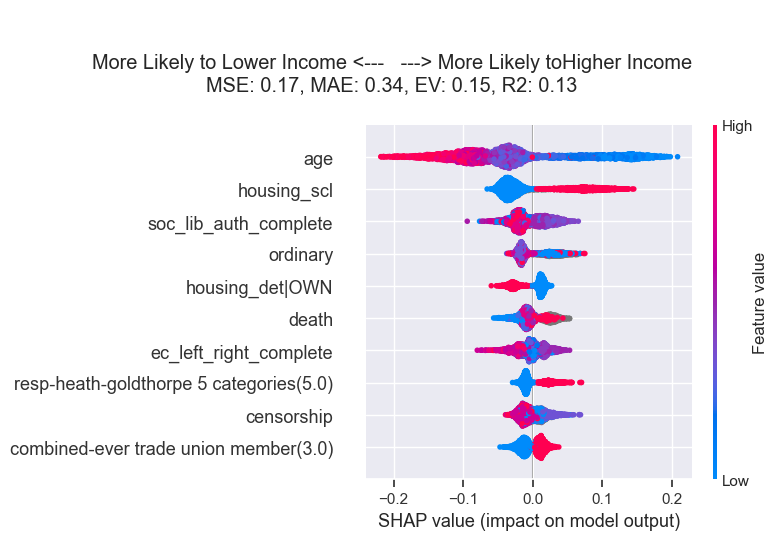

***************************
2010
***************************
MSE: 0.16, MAE: 0.32, EV: 0.13, R2: 0.10


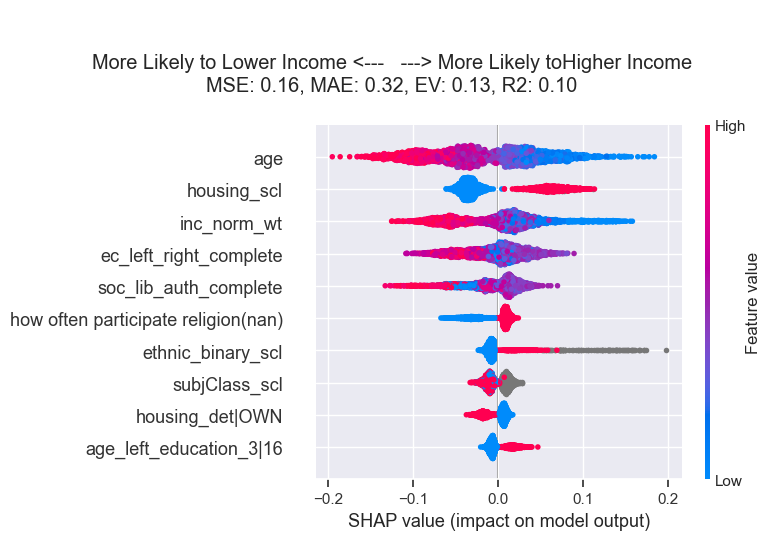

***************************
2015
***************************
MSE: 0.16, MAE: 0.33, EV: 0.19, R2: 0.18


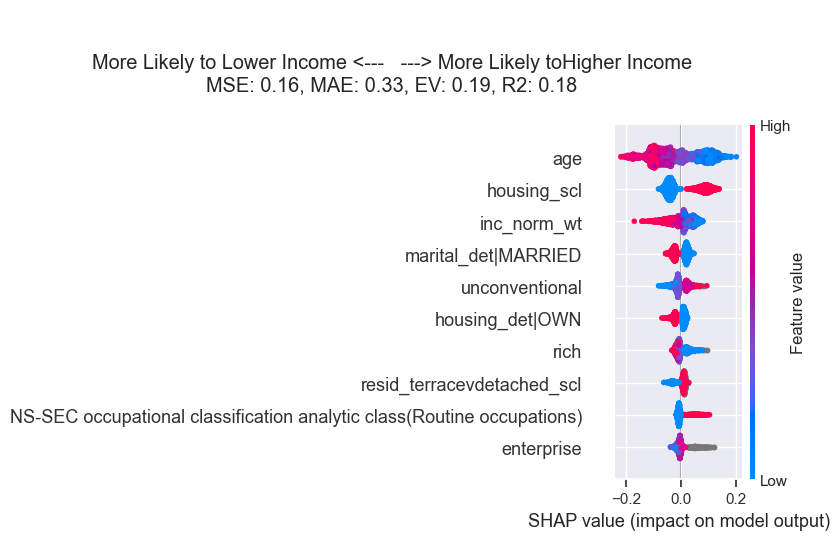

***************************
2017
***************************
MSE: 0.14, MAE: 0.30, EV: 0.19, R2: 0.17


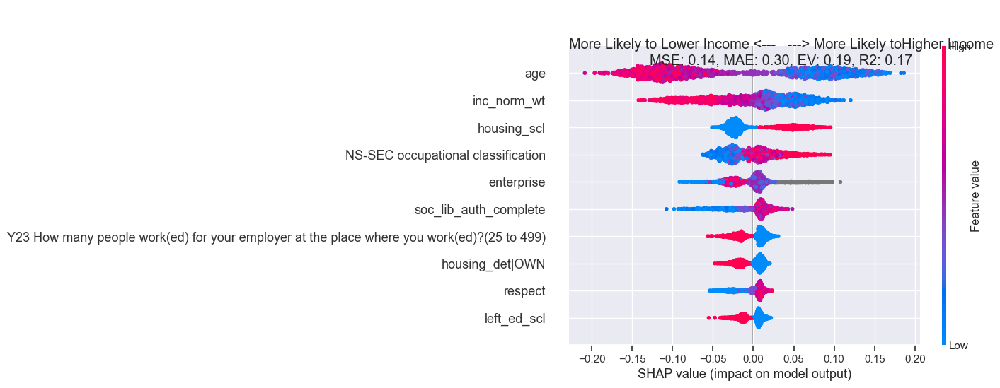

***************************
2019
***************************
MSE: 0.15, MAE: 0.32, EV: 0.12, R2: 0.07


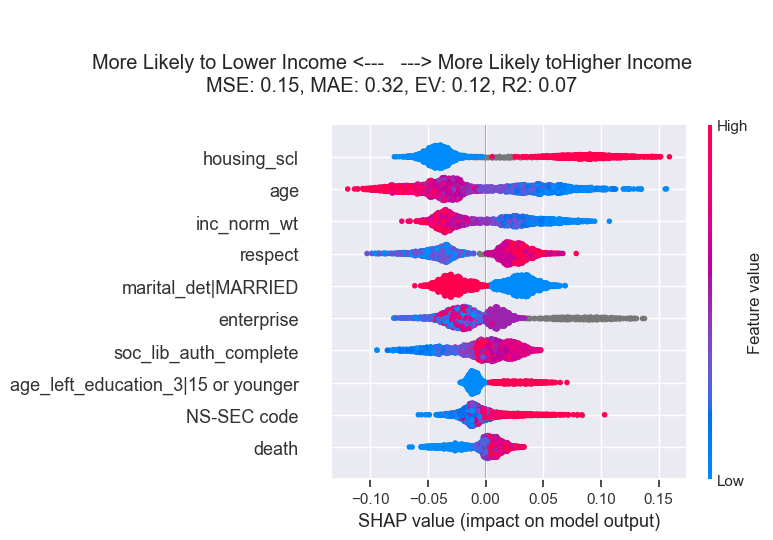

In [180]:
# generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

In [ ]:
 's01_1': 'Probability of voting for Conservatives',
 's01_2': 'Probability of voting for Labour',
 's01_3': 'Probability of voting for Liberal Democrats',
 's01_4': 'Probability of voting for UKIP',
 's01_5': 'Probability of voting for Greens',
 's01_6': 'Probability of voting for SNP',
 's01_7': 'Probability of voting for Plaid Cymru',
    
 'q11_cses_1': 'Like/dislike: Conservatives',
 'q11_cses_2': 'Like/dislike: Labour',
 'q11_cses_3': 'Like/dislike: Liberal Democrats',
 'q11_cses_4': 'Like/dislike: UKIP',
 'q11_cses_5': 'Like/dislike: Green',
 'q11_cses_6': 'Like/dislike: SNP',
 'q11_cses_7': 'Like/dislike: Plaid Cymru',
    
 'i01_1': 'Like leader: Sturgeon',
 'i01_2': 'Like leader: Wood',
 'i01_3': 'Like leader: Corbyn',
 'i01_4': 'Like leader: May',
 'i01_5': 'Like leader: Farron',
 'i01_6': 'Like leader: Lucas',
 'i01_7': 'Like leader: Nuttall',    

In [224]:
BES_df_list["2017"]["s01_1"]#.value_counts(dropna=False).sort_index()

0 very unlikely    627
1                  119
2                  137
3                  121
4                  104
5                  198
6                  130
7                  148
8                  163
9                  126
10 very likely     321
Name: s01_1, dtype: int64

In [227]:
BES_df_list["2017"]["q11_cses_1"].replace("Don't know",np.nan).value_counts(dropna=False).sort_index()

# BES_df_list["2017"]["like_conservatives"] = 
# BES_df_list["2017"]["q11_cses_1"].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan)#.value_counts(dropna=False)

In [233]:
ge = "2017"
f2f_harmonised["like_conservatives"] = np.nan
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"like_conservatives"] = \
    BES_df_list["2017"]["q11_cses_1"].replace("Don't know",np.nan).cat.codes.replace(-1,np.nan)
list_of_scale_harm_vars = list_of_scale_harm_vars+["like_conservatives"]

In [243]:
f2f_harmonised = f2f_harmonised.drop("like_conservatives",axis=1)
list_of_scale_harm_vars.remove("like_conservatives")

In [238]:
ge = "2017"
f2f_harmonised["ptv_conservatives"] = np.nan
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"ptv_conservatives"] = \
    BES_df_list["2017"]["s01_1"].cat.codes.replace(-1,np.nan)
list_of_scale_harm_vars = list_of_scale_harm_vars+["ptv_conservatives"]

In [249]:
mean_ptv = BES_df_list["2017"][["s01_1","s01_2","s01_3","s01_4","s01_5","s01_6","s01_7",]].apply(lambda x: x.cat.codes.replace(-1,np.nan)).mean(axis=1)
#.cat.codes.replace(-1,np.nan)
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"ptv_conservatives"]= \
    BES_df_list["2017"]["s01_1"].cat.codes.replace(-1,np.nan)-mean_ptv
#  's01_1': 'Probability of voting for Conservatives',
#  's01_2': 'Probability of voting for Labour',
#  's01_3': 'Probability of voting for Liberal Democrats',
#  's01_4': 'Probability of voting for UKIP',
#  's01_5': 'Probability of voting for Greens',
#  's01_6': 'Probability of voting for SNP',
#  's01_7': 'Probability of voting for Plaid Cymru',

In [295]:
from sklearn.decomposition import FactorAnalysis
# X, _ = load_digits(return_X_y=True)
transformer = FactorAnalysis(n_components=3, random_state=0)
X_transformed = transformer.fit_transform(
    BES_df_list["2017"][["s01_1","s01_2","s01_3","s01_4","s01_5",]]\
        .apply(lambda x: x.cat.codes.replace(-1,np.nan))
    )

f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"ptv_conservatives"] = pd.DataFrame( X_transformed )[0]
    

like_conservatives
***************************
2017
***************************
MSE: 7.16, MAE: 2.07, EV: 0.31, R2: 0.31


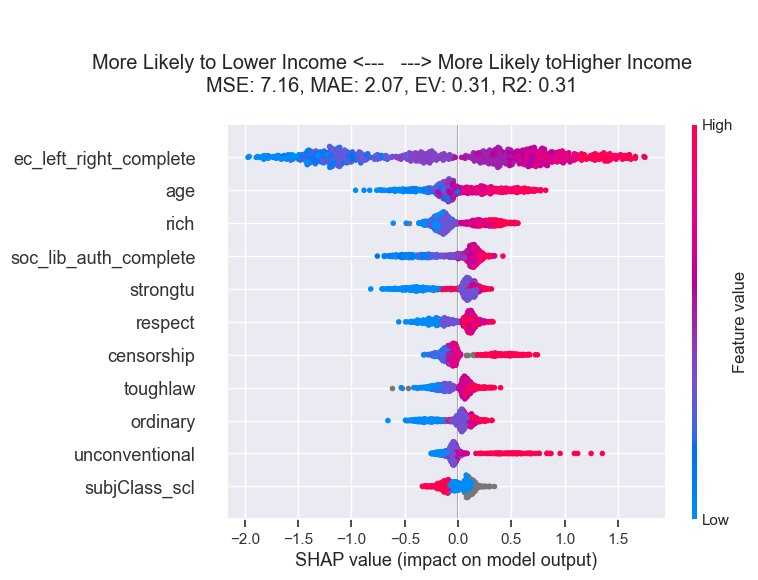

In [236]:
# generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["like_conservatives"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in ["2017"]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

ptv_conservatives
***************************
2017
***************************
MSE: 9.17, MAE: 2.46, EV: 0.36, R2: 0.36


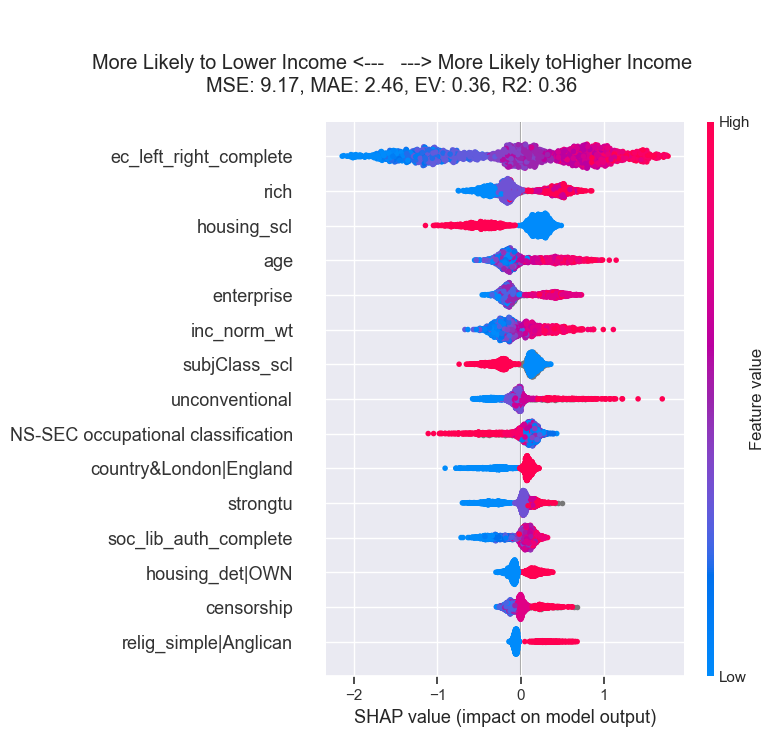

In [239]:
# generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["ptv_conservatives"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in ["2017"]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

ptv_conservatives
***************************
2017
***************************
MSE: 8.56, MAE: 2.32, EV: 0.39, R2: 0.39


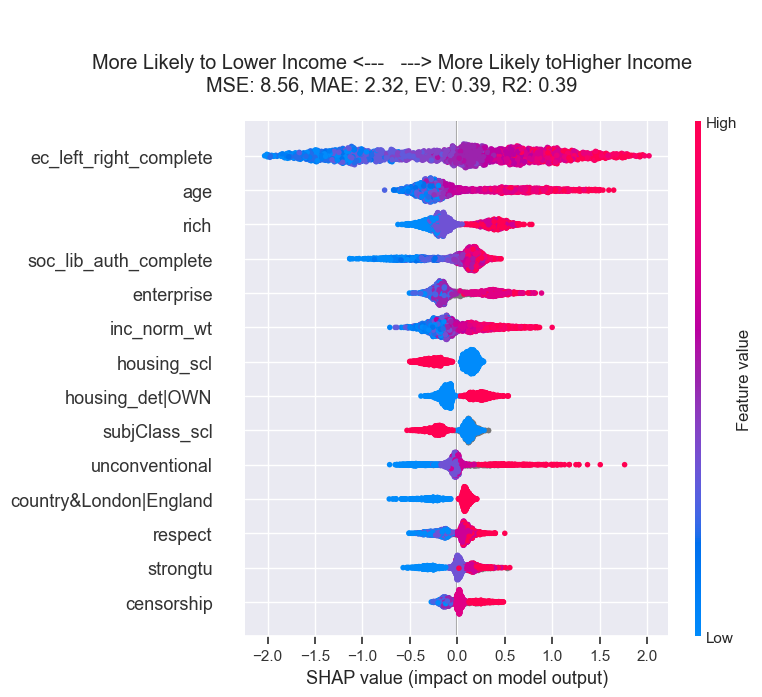

In [251]:
# generic_cols = f2f_harmonised.columns
drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["ptv_conservatives"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in ["2017"]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

ptv_conservatives
***************************
2017
***************************
MSE: 3.73, MAE: 1.37, EV: 0.00, R2: -0.02


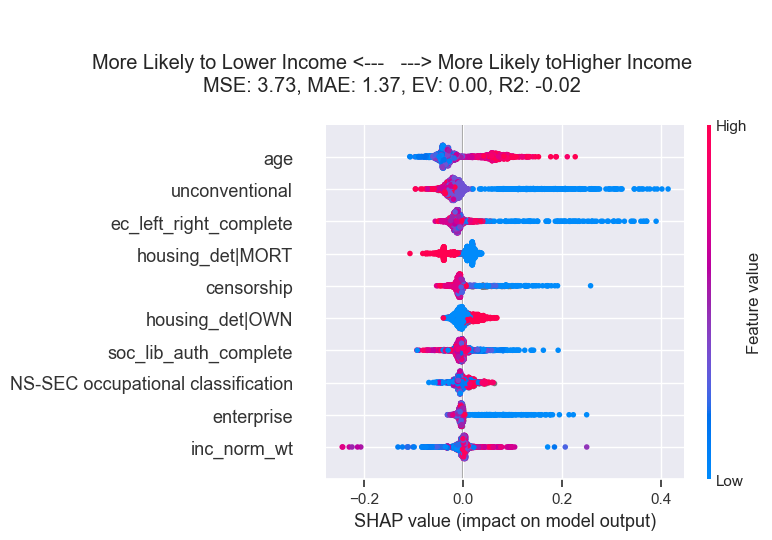

In [335]:
# generic_cols = f2f_harmonised.columns
from sklearn.decomposition import FactorAnalysis
# X, _ = load_digits(return_X_y=True)
# transformer = FactorAnalysis(n_components=2, random_state=0)
transformer = PCA(n_components=5, svd_solver="full")
X_transformed = transformer.fit_transform(
    BES_df_list["2017"][["s01_1","s01_2","s01_3","s01_4","s01_5",]]\
        .apply(lambda x: x.cat.codes.replace(-1,np.nan))
    ) 

f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"ptv_conservatives"] = pd.DataFrame( X_transformed )[0]

drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]
for target in ["ptv_conservatives"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in ["2017"]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars)

In [ ]:
## with FA, max is .42 with 1st component of two component model
## with pca, max is .4 with 1st component of any comp model

In [225]:
for target in ["AuthRight"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")

        run_ge_regression(ge,target,demo_var_only=True, drop_vars = drop_vars, harm_vars=harm_vars,
                         pre_mask = f2f_harmonised["reg_country"]=="England")

AuthRight
***************************
1959
***************************


ValueError: operands could not be broadcast together with shapes (2922,) (52731,) 

In [222]:
%debug

> e:\users\gamer\anaconda3\envs\test_tensorflow_install\lib\site-packages\pandas\core\indexes\base.py(3476)_can_reindex()
   3474         # trying to reindex on an axis with duplicates
   3475         if not self._index_as_unique and len(indexer):
-> 3476             raise ValueError("cannot reindex from a duplicate axis")
   3477 
   3478     def reindex(self, target, method=None, level=None, limit=None, tolerance=None):

ipdb> mask
*** NameError: name 'mask' is not defined
ipdb> up
> e:\users\gamer\anaconda3\envs\test_tensorflow_install\lib\site-packages\pandas\core\internals\managers.py(1301)reindex_indexer()
   1299         # some axes don't allow reindexing with dups
   1300         if not allow_dups:
-> 1301             self.axes[axis]._can_reindex(indexer)
   1302 
   1303         if axis >= self.ndim:

ipdb> up
> e:\users\gamer\anaconda3\envs\test_tensorflow_install\lib\site-packages\pandas\core\generic.py(4883)_reindex_with_indexers()
   4881                 fill_value=fill_va

In [223]:
# f2f_harmonised

,dataset,uid,housing_det,housing,inc,vote,year,wt,age,vote_simple,...,school_where_scl,ethnic_binary_scl,tumember_simple_scl,subjClass_scl,left_ed_scl,residence_type,resid_housevflat,resid_terracevdetached,resid_housevflat_scl,resid_terracevdetached_scl
index,,,,,,,,,,,,,,,,,,,,,
0,2019,2019|0,MORT,OWN,15.6-26k,DNV,2019,0.926940,34.0,DNV,...,NaN,0.0,1.0,1.0,1.0,semi-detached house,house,NaN,1.0,NaN
1,2019,2019|1,RENT-PR,RENT,NaN,DNV,2019,NaN,45.0,DNV,...,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019,2019|2,MORT,OWN,26-36.4k,LAB,2019,0.920836,33.0,LAB,...,NaN,0.0,1.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN
3,2019,2019|3,RENT-LA,RENT,0-15.6k,DNV,2019,1.197730,22.0,DNV,...,NaN,0.0,0.0,NaN,0.0,terraced house,house,terrace&tenement,1.0,1.0
4,2019,2019|4,RENT-LA,RENT,NaN,DNV,2019,1.979724,35.0,DNV,...,NaN,0.0,0.0,NaN,0.0,terraced house,house,terrace&tenement,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2917,1959,1959|2917,OWN-MORT,OWN,NaN,TY,1959,0.832877,14.0,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN
2918,1959,1959|2918,OWN-MORT,OWN,NaN,TY,1959,0.858108,19.0,NaN,...,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN
2919,1959,1959|2919,OWN-MORT,OWN,NaN,TY,1959,0.839163,13.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [195]:
# BES_df_list["1979"].apply(lambda x: re.search('detached|terrace|maisonette|flat|bedsit|bungalow',str(x).lower()) is not None).sum()

# https://www.thepinknews.com/2017/07/12/sir-john-major-i-learned-a-great-deal-about-gay-people-from-ian-mckellen/

1

In [203]:
residence_type = pd.read_pickle("E:\\BES_analysis_data\\Face_to_face\\residence_type.zip", compression='zip')
f2f_harmonised[residence_type.columns] = residence_type

In [207]:

BES_label_list["1970"]['v1155']

'59 VOTE OR PREF     1964'

In [208]:
{x:{k:v for k,v in BES_label_list[x].items() if re.search(
    "recall|vote-rev|direction of|turnover|first vote",v.lower()) } for x in BES_label_list.keys()}

{'2019': {'p01': 'EU referendum vote recalled'},
 '2017': {},
 '2015': {},
 '2010': {},
 '2005': {},
 '2001': {},
 '1997': {},
 '1992': {},
 '1987': {},
 '1983': {},
 '1979': {},
 '1974_feb': {},
 '1974_oct': {},
 '1970': {'v363': 'DIRECTION OF 1964 VOTE64',
  'v364': 'DIRECTION OF 1966 VOTE66',
  'v365': 'DIRECTION OF 1970 VOTE70',
  'v512': 'RECALL 66 TURNOUT   1970',
  'v513': 'RECALL 66 VOTE      1970',
  'v514': 'RECALL 66 PREFERENCE  70',
  'v515': 'RECALL 64 TURNOUT   1966',
  'v516': 'RECALL 64 TURNOUT   1970',
  'v517': 'RECALL 64 VOTE      1966',
  'v518': 'RECALL 64 VOTE      1970',
  'v519': 'RECALL 64 PREFERENCE  66',
  'v520': 'RECALL 64 PREFERENCE  70',
  'v521': 'RECALL 59 TURNOUT   1963',
  'v522': 'RECALL 59 TURNOUT   1964',
  'v523': 'RECALL 59 TURNOUT   1966',
  'v524': 'RECALL 59 VOTE      1963',
  'v525': 'RECALL 59 VOTE      1964',
  'v526': 'RECALL 59 VOTE      1966',
  'v527': 'RECALL 59 PREFERENCE  63',
  'v528': 'RECALL 59 PREFERENCE  64',
  'v537': 'FIRST VO

In [ ]:
{'v363': 'DIRECTION OF 1964 VOTE64',
  'v364': 'DIRECTION OF 1966 VOTE66',
  'v365': 'DIRECTION OF 1970 VOTE70',
 'v512': 'RECALL 66 TURNOUT   1970',
  'v513': 'RECALL 66 VOTE      1970',
  'v514': 'RECALL 66 PREFERENCE  70',
  'v515': 'RECALL 64 TURNOUT   1966',
  'v516': 'RECALL 64 TURNOUT   1970',
  'v517': 'RECALL 64 VOTE      1966',
  'v518': 'RECALL 64 VOTE      1970',
  'v519': 'RECALL 64 PREFERENCE  66',
  'v520': 'RECALL 64 PREFERENCE  70',
  'v521': 'RECALL 59 TURNOUT   1963',
  'v522': 'RECALL 59 TURNOUT   1964',
  'v523': 'RECALL 59 TURNOUT   1966',
  'v524': 'RECALL 59 VOTE      1963',
  'v525': 'RECALL 59 VOTE      1964',
  'v526': 'RECALL 59 VOTE      1966',
  'v527': 'RECALL 59 PREFERENCE  63',
  'v528': 'RECALL 59 PREFERENCE  64',
  'v1153': '59 VOTE-REVISED-MEAS  63',
  'v1154': '59 VOTE-REVISED       64',
  'v1156': '59 VOTE-REV MEAS 2  1966',
  'v1157': '64 VOTE-REVISED MEAS  64',
  'v1158': '64 VOTE-REVISED MEAS  66',
  'v1159': '64 VOTE-REVISED MEAS  70',
  'v1162': '66 VOTE-REVISED MEAS  66',
  'v1163': '66 VOTE-REVISED MEAS  70',
  'v1164': '70 VOTE-REVISED MEAS  70',
'v1168': '59-63 VOTE TURNOVER   63',
#   'v1169': 'TURNOVER59-64VOTE PREF64',
  'v1170': 'TURNOVER 59-64 VOTE 1964',
  'v1171': 'TURNOVER 63-64 VOTE 1964'

}}

In [211]:
vote_var_dict = {
    "2019":['b02','b01'],
    "2017":['b02','b01'],
    "2015":['b02','b01'],
    "2010":['bq12_2','bq12_1'],
    "2005":['vote05','bq12b'],    
    "2001":['bq8b'],
    "1997":['vote_bes'],
    "1992":['v9a'],
    "1987":['v8a'],
    "1983":['q9a'],
    "1979":['m115147'],
    "1974_oct":['oct115'],
    "1974_feb":['feb115'],
    "1970":['v1164','v365'],
    "1966":['v1162','v364','v1163','v512','v513',
            'v365',#direction of 1970
            'v364',#direction of 1966
           
           ],
    "1964":['v1157','v1158','v1159','v515','v516','v517','v518',
           'v364',#direction of 1966
            'v363',# direction of 1964
            'v1168',#'59-63 VOTE TURNOVER   63'
            'v1170',#'TURNOVER 59-64 VOTE 1964'  
            'v1171',# 'TURNOVER 63-64 VOTE 1964'            
           ],
    "1959":['v1170','v1169', 'v1168',  'v1153','v1154',  'v1155', 'v1156', 'v524', 'v525','v526',
            'v521','v522','v523',# recall 59 turnout 63/64/66
            'v363',# direction of 1964
            'v1168',#'59-63 VOTE TURNOVER   63'
            'v1170',#'TURNOVER 59-64 VOTE 1964'
            
           ],    
    
  
    
    
                }

## 1959-1970

# "first vote" variables
# v529-v542    
first_vote_list = ["v529","v530","v531","v532","v533","v534","v535","v536","v537","v538",
                  "v539","v540","v541","v542",]


past_vote_var_dict = {
    "2019":['u05'],
    "2017":['u05'],
    "2015":['u05'],
    "2010":['bq46_1','aq41_1'],
    "2005":['aq36'],    
    "2001":['vote97s','aq28a'],
    "1997":['vote92'],
    "1992":['v922'],
    "1987":['v65a','v65b'],
    "1983":['q11'],
    "1979":['m115153','m124a154','m125155'],
    "1974_oct":['oct125','oct124a'],
    "1974_feb":['feb125','feb126'],
    # haven't updated the ones beneath!
    "1970":['v1162','v364','v1157','v1169', 'v1168', 'v1170', 'v1155', 'v524', 'v1153', 'v525'],
    "1966":['v1157','v1169', 'v1168', 'v1170', 'v1155', 'v524', 'v1153', 'v525'],
    "1964":['v1169', 'v1168', 'v1170', 'v1155', 'v524', 'v1153', 'v525'],
    "1959":[],    
                }

AuthRight
***************************
1959
***************************
MSE: 0.07, MAE: 0.16, EV: 0.70, R2: 0.70


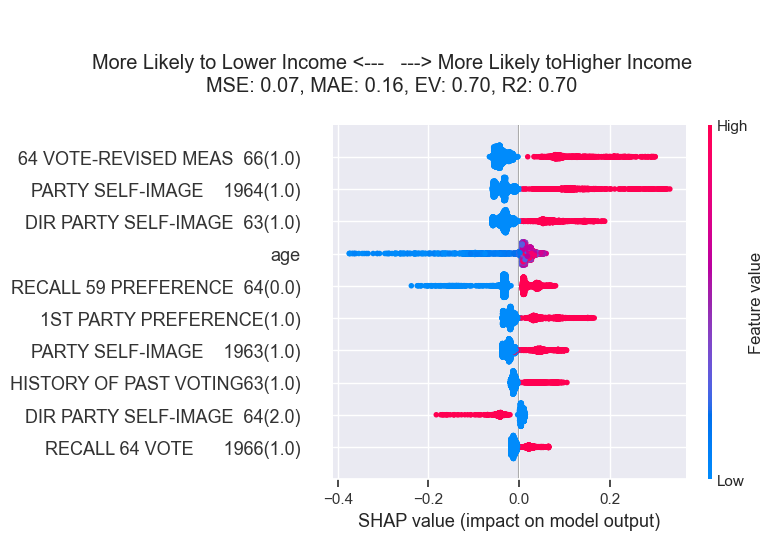

***************************
1964
***************************
MSE: 0.05, MAE: 0.12, EV: 0.79, R2: 0.79


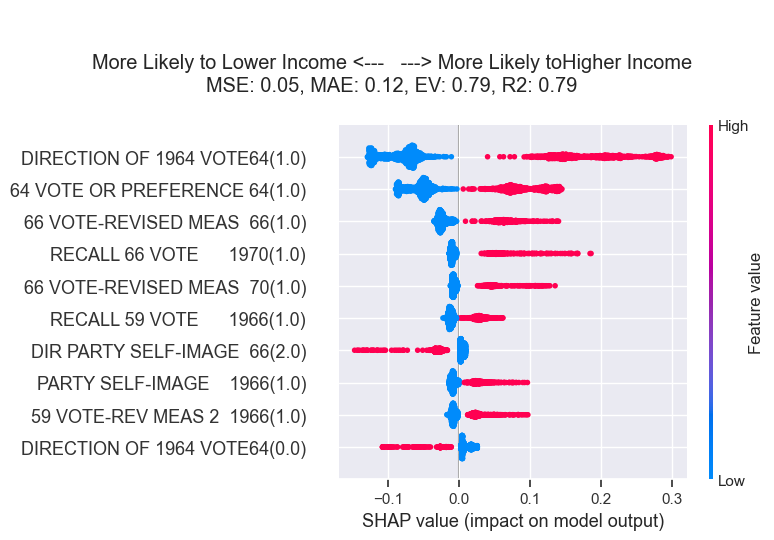

***************************
1966
***************************
MSE: 0.04, MAE: 0.10, EV: 0.82, R2: 0.82


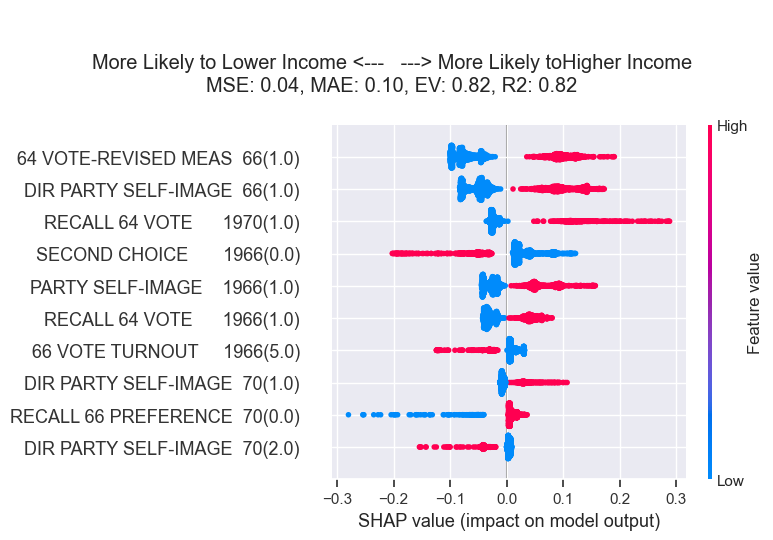

***************************
1970
***************************
MSE: 0.03, MAE: 0.09, EV: 0.87, R2: 0.87


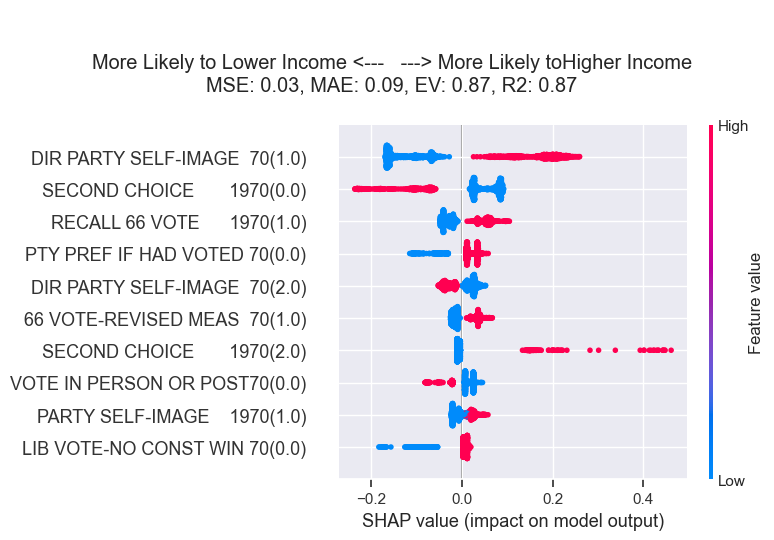

***************************
1974_oct
***************************
MSE: 0.02, MAE: 0.07, EV: 0.89, R2: 0.89


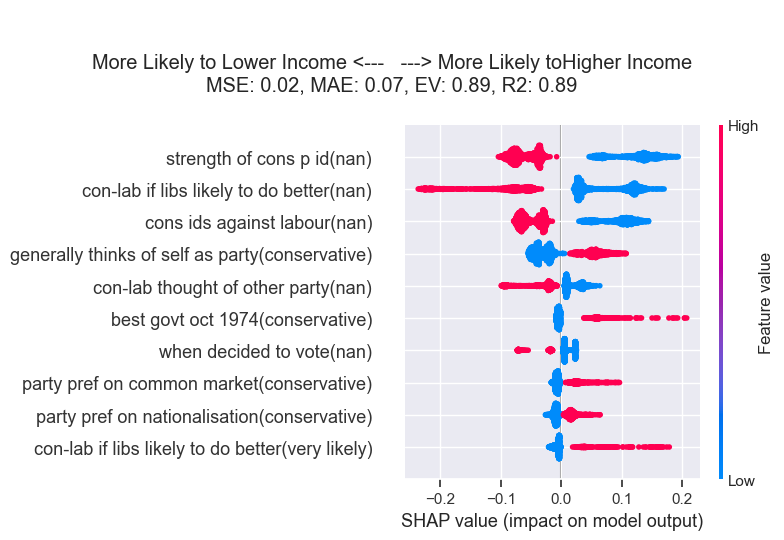

***************************
1974_feb
***************************
MSE: 0.03, MAE: 0.08, EV: 0.88, R2: 0.88


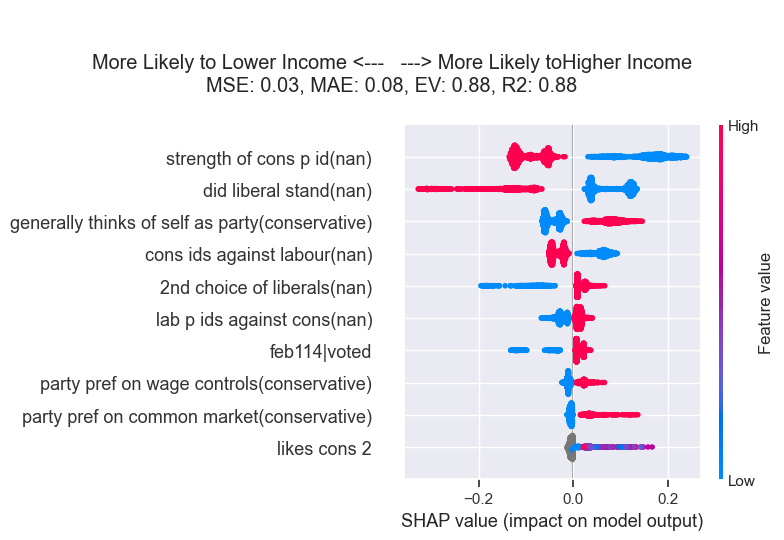

***************************
1979
***************************
MSE: 0.04, MAE: 0.10, EV: 0.83, R2: 0.83


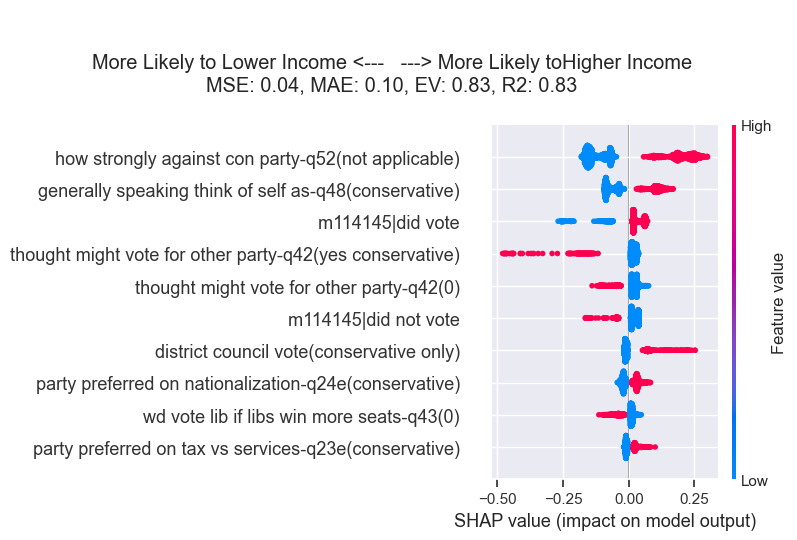

***************************
1983
***************************
MSE: 0.02, MAE: 0.06, EV: 0.92, R2: 0.92


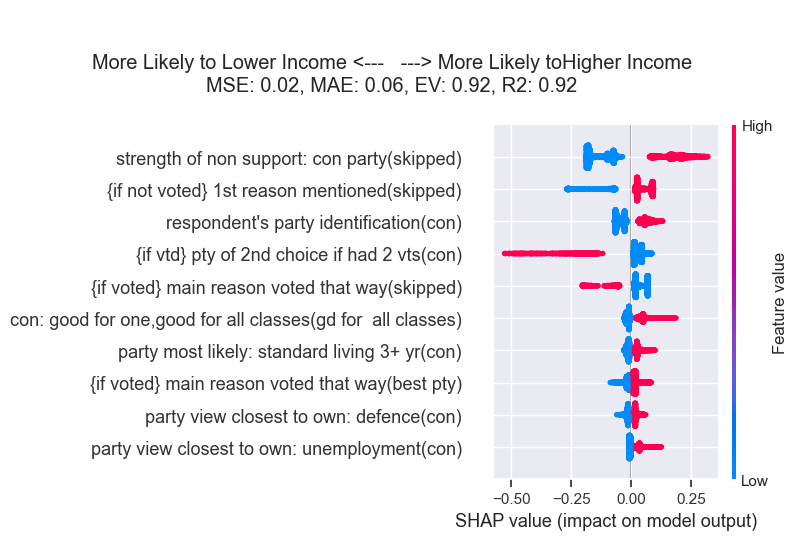

***************************
1987
***************************
MSE: 0.01, MAE: 0.03, EV: 0.97, R2: 0.97


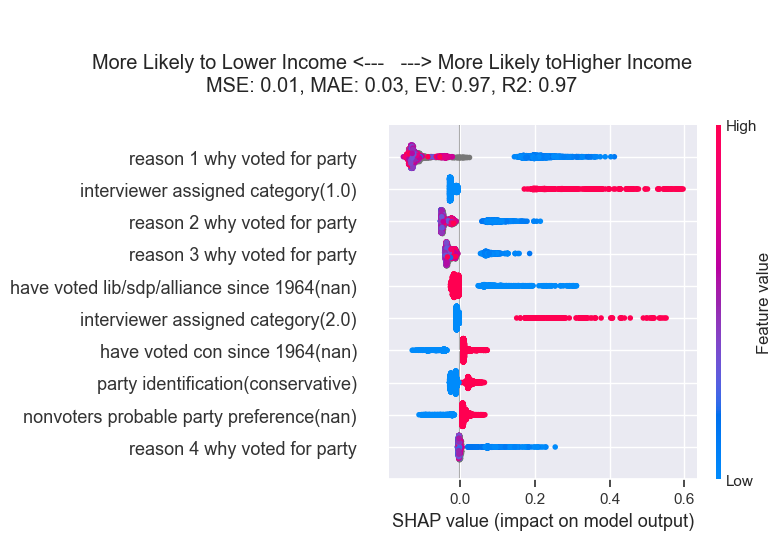

***************************
1992
***************************
MSE: 0.01, MAE: 0.06, EV: 0.94, R2: 0.94


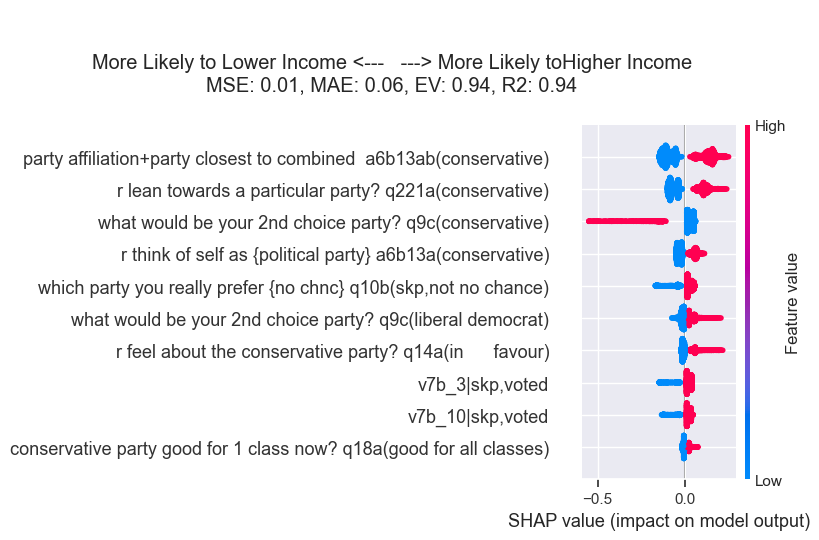

***************************
1997
***************************
MSE: 0.03, MAE: 0.08, EV: 0.85, R2: 0.85


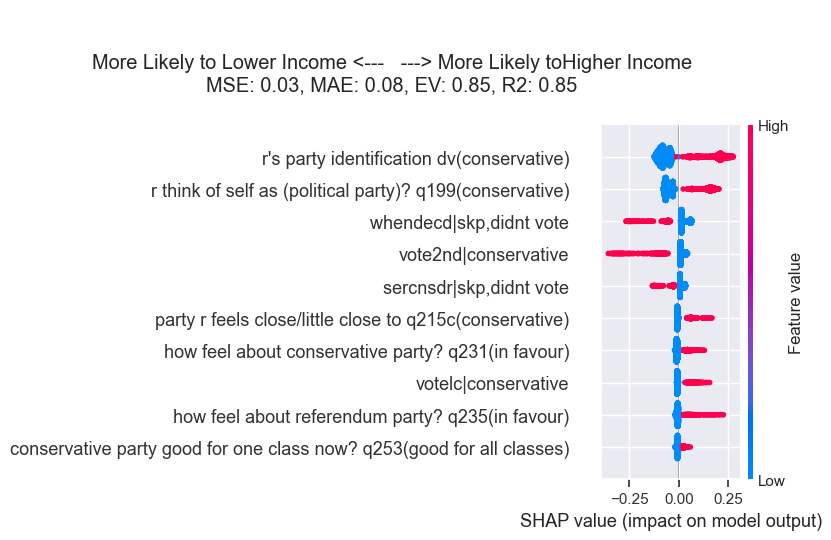

***************************
2001
***************************
MSE: 0.03, MAE: 0.08, EV: 0.80, R2: 0.80


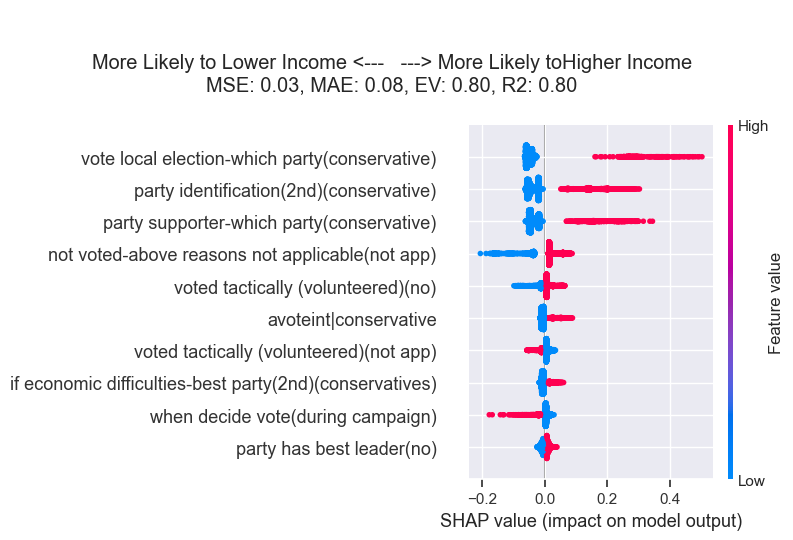

***************************
2005
***************************
MSE: 0.04, MAE: 0.09, EV: 0.78, R2: 0.78


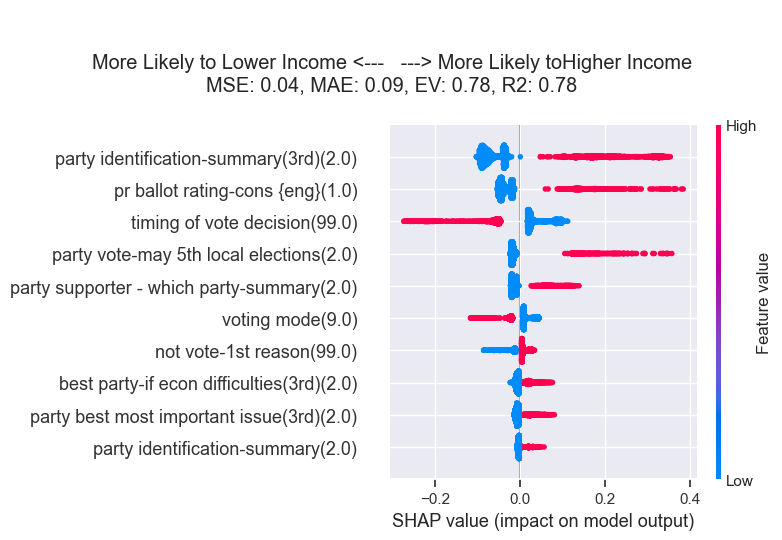

***************************
2010
***************************
MSE: 0.04, MAE: 0.10, EV: 0.81, R2: 0.81


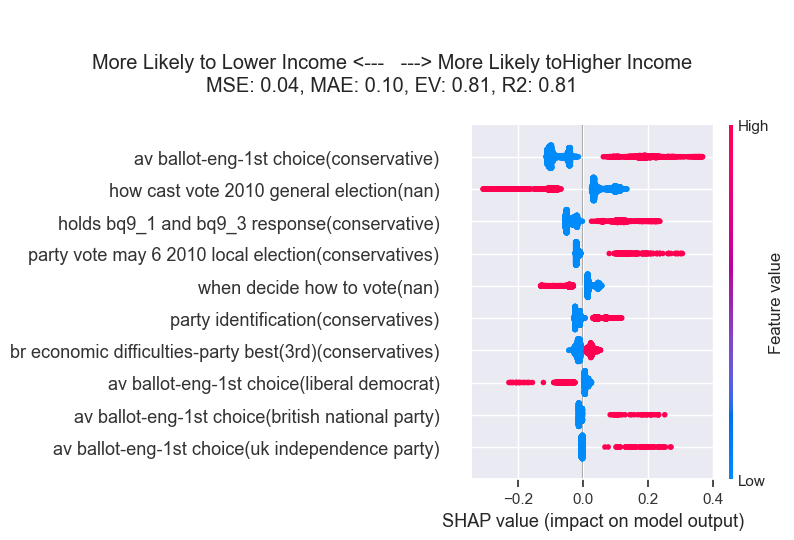

***************************
2015
***************************
MSE: 0.04, MAE: 0.12, EV: 0.81, R2: 0.81


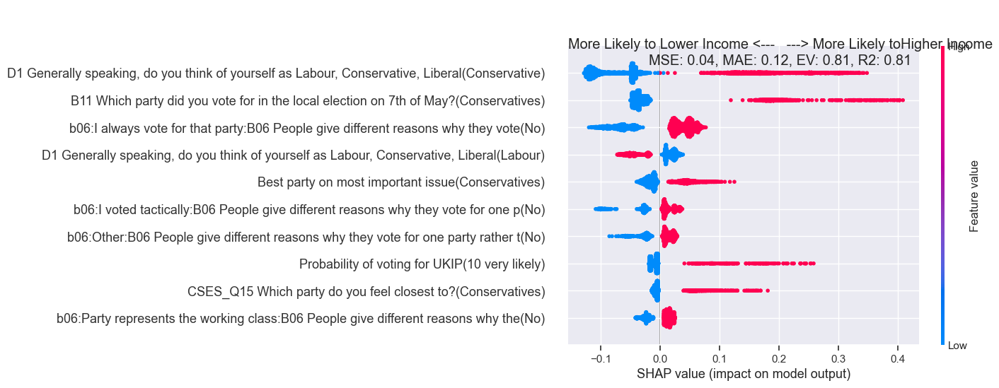

***************************
2017
***************************
MSE: 0.04, MAE: 0.10, EV: 0.81, R2: 0.81


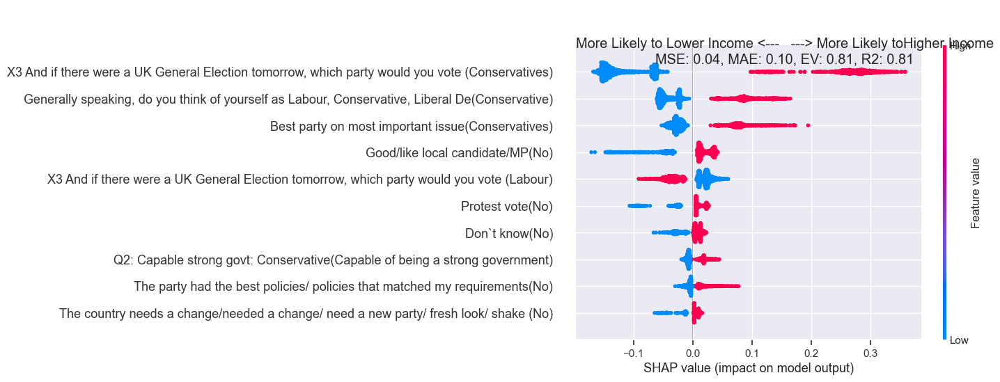

***************************
2019
***************************
MSE: 0.06, MAE: 0.14, EV: 0.76, R2: 0.76


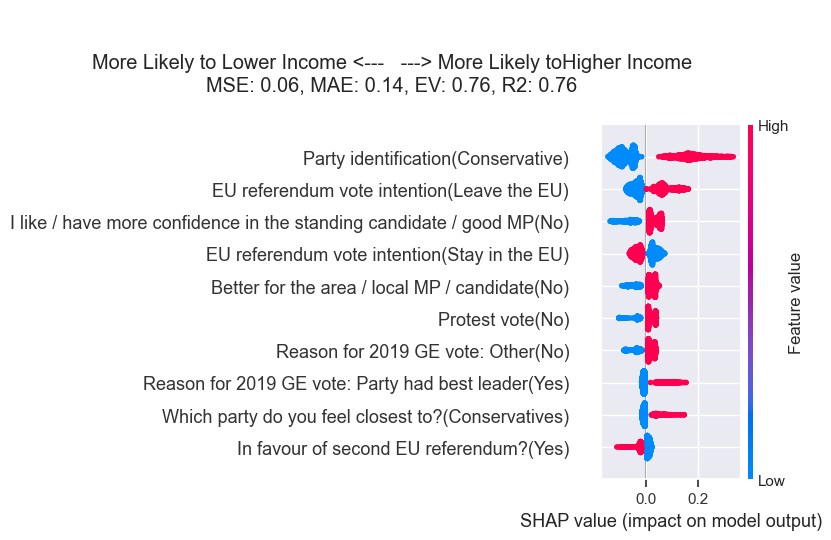

LibLeft
***************************
1959
***************************
MSE: 0.07, MAE: 0.18, EV: 0.69, R2: 0.69


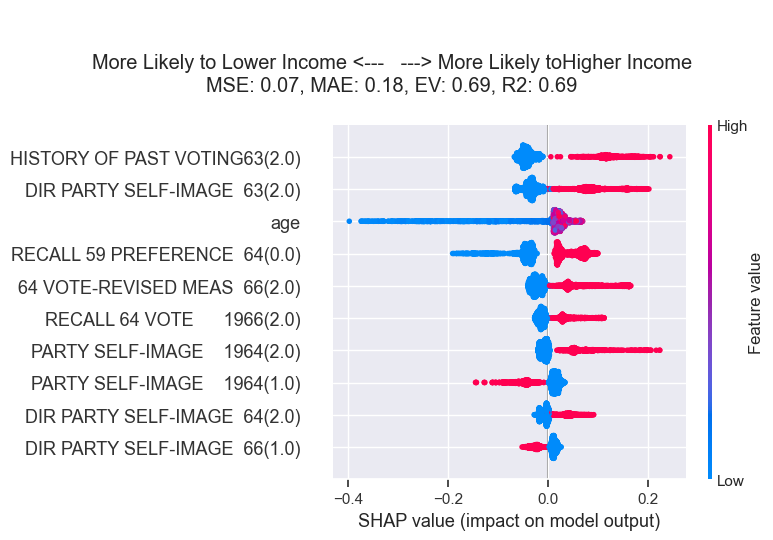

***************************
1964
***************************
MSE: 0.06, MAE: 0.13, EV: 0.76, R2: 0.76


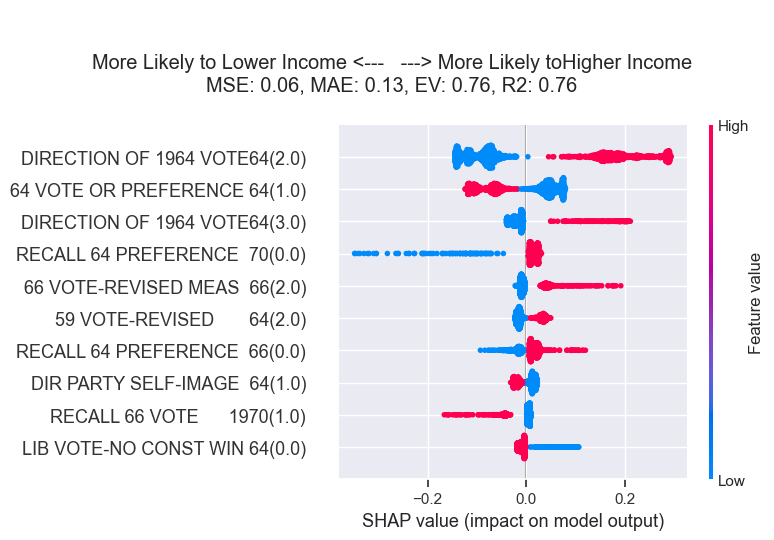

***************************
1966
***************************
MSE: 0.05, MAE: 0.12, EV: 0.80, R2: 0.80


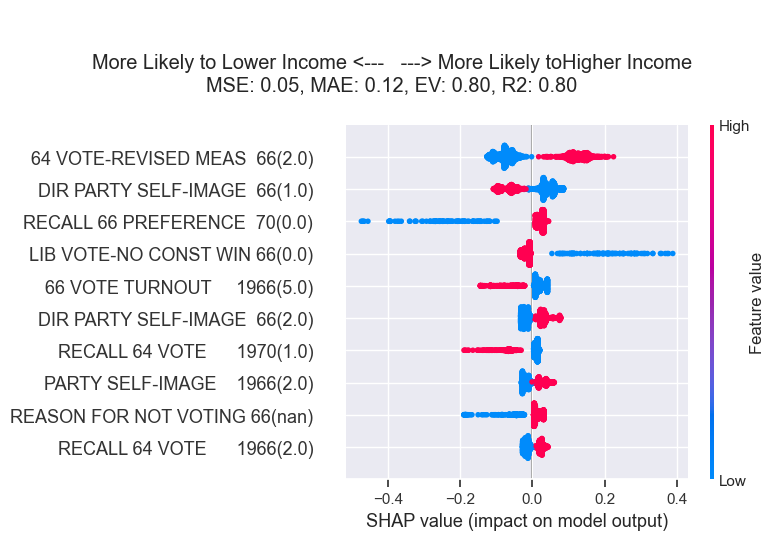

***************************
1970
***************************
MSE: 0.02, MAE: 0.07, EV: 0.91, R2: 0.91


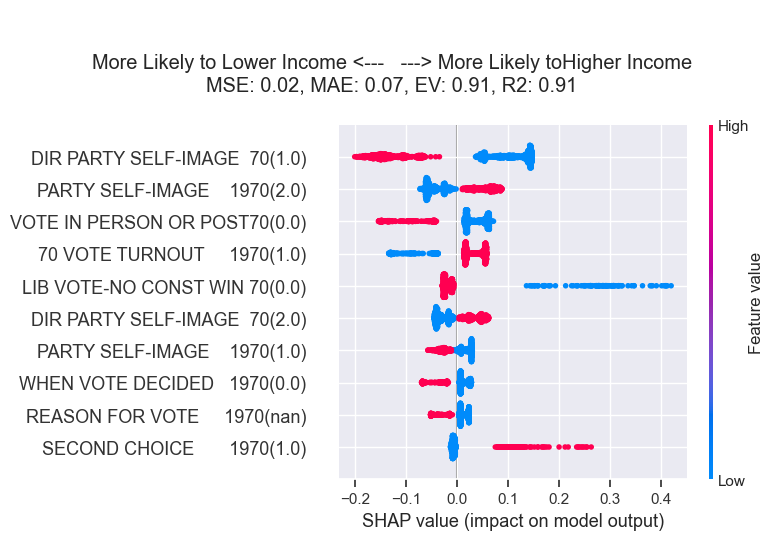

***************************
1974_oct
***************************
MSE: 0.03, MAE: 0.07, EV: 0.88, R2: 0.88


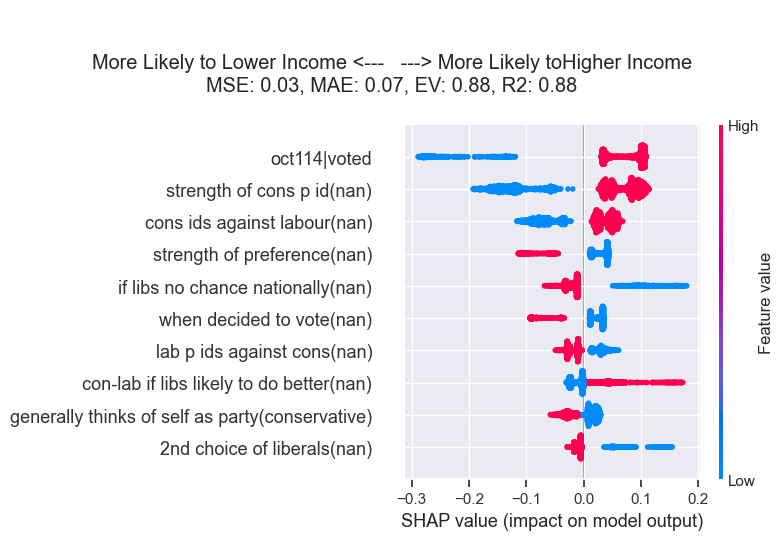

***************************
1974_feb
***************************
MSE: 0.02, MAE: 0.08, EV: 0.90, R2: 0.90


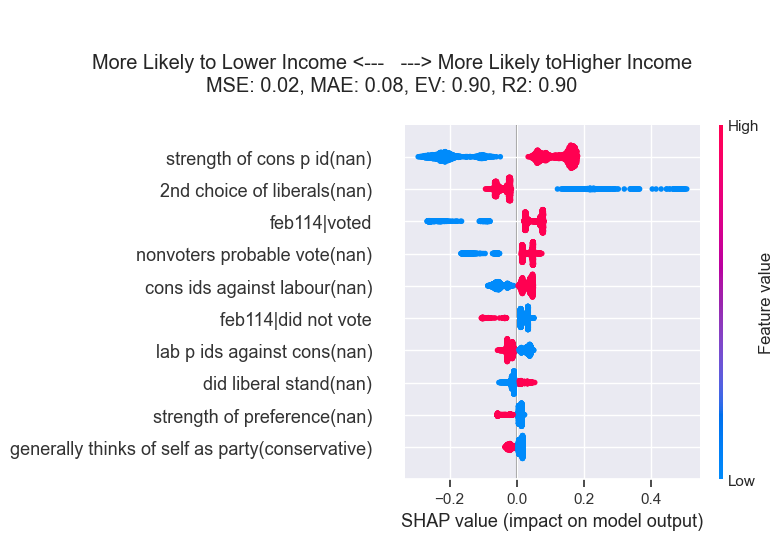

***************************
1979
***************************
MSE: 0.04, MAE: 0.10, EV: 0.86, R2: 0.86


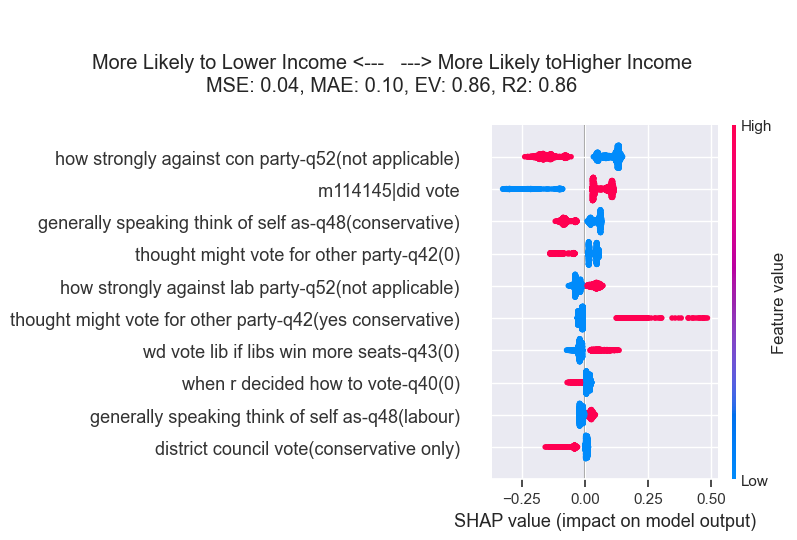

***************************
1983
***************************
MSE: 0.02, MAE: 0.06, EV: 0.93, R2: 0.93


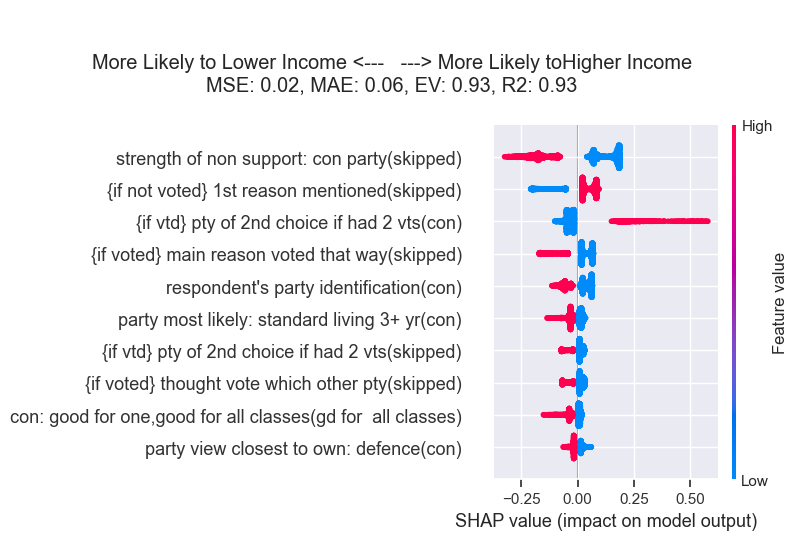

***************************
1987
***************************
MSE: 0.01, MAE: 0.04, EV: 0.96, R2: 0.96


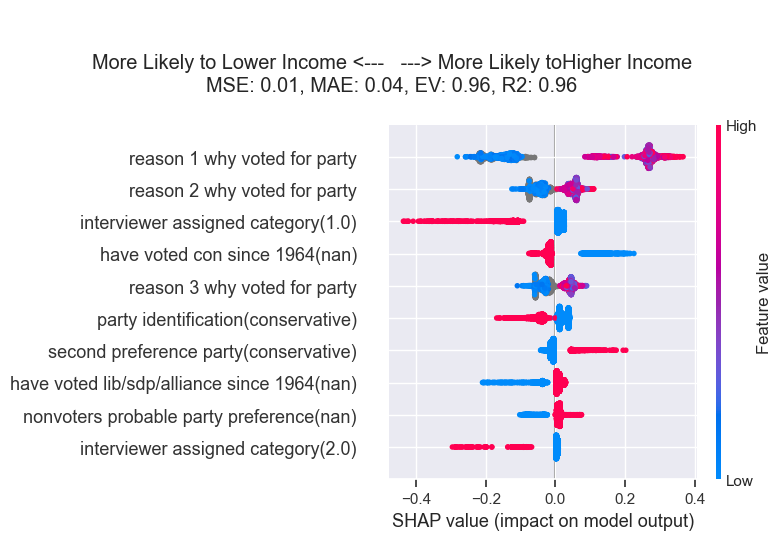

***************************
1992
***************************
MSE: 0.02, MAE: 0.06, EV: 0.92, R2: 0.92


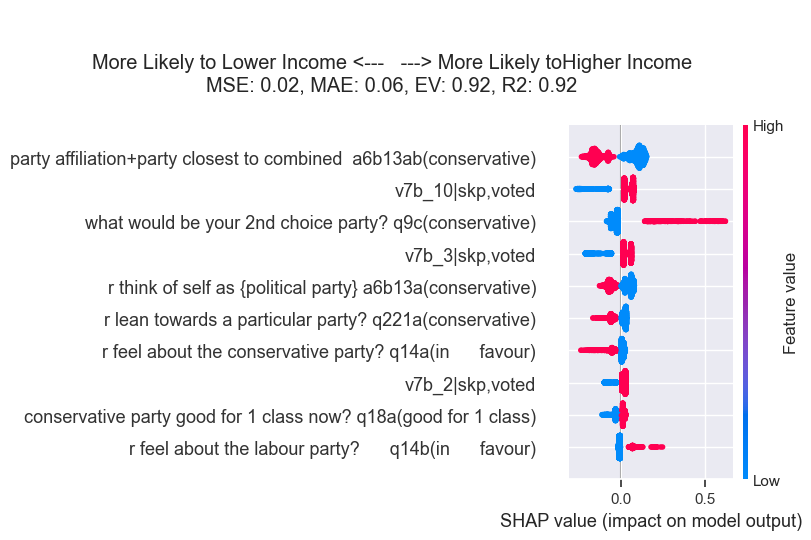

***************************
1997
***************************
MSE: 0.03, MAE: 0.08, EV: 0.86, R2: 0.86


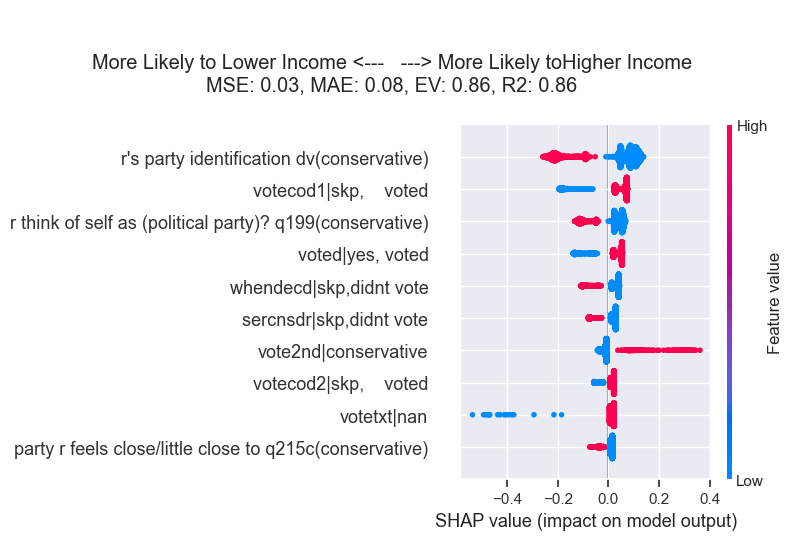

***************************
2001
***************************
MSE: 0.03, MAE: 0.08, EV: 0.87, R2: 0.87


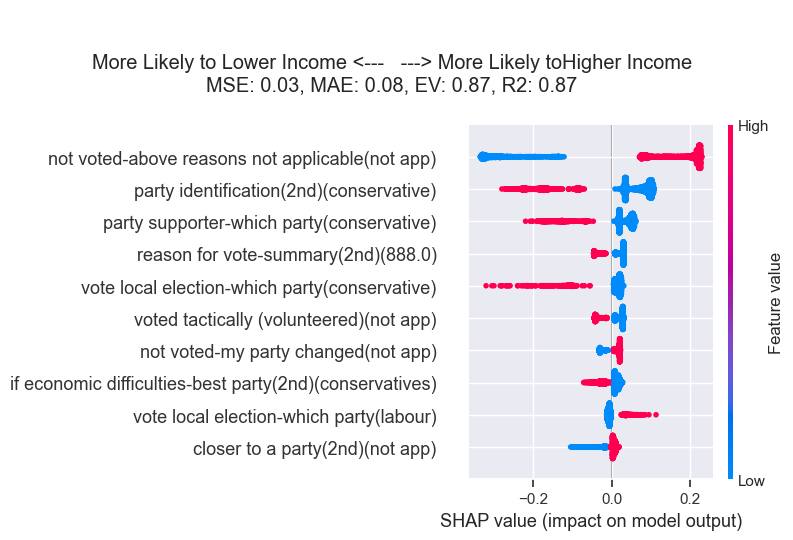

***************************
2005
***************************
MSE: 0.04, MAE: 0.10, EV: 0.84, R2: 0.84


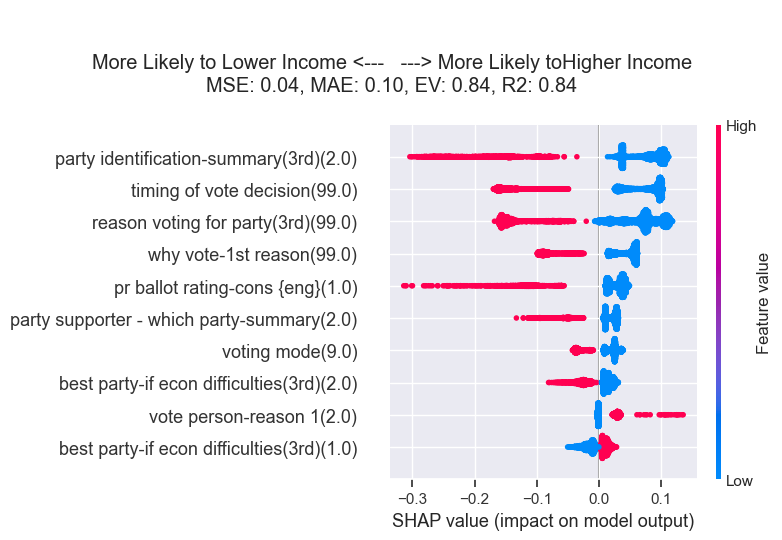

***************************
2010
***************************
MSE: 0.04, MAE: 0.10, EV: 0.84, R2: 0.84


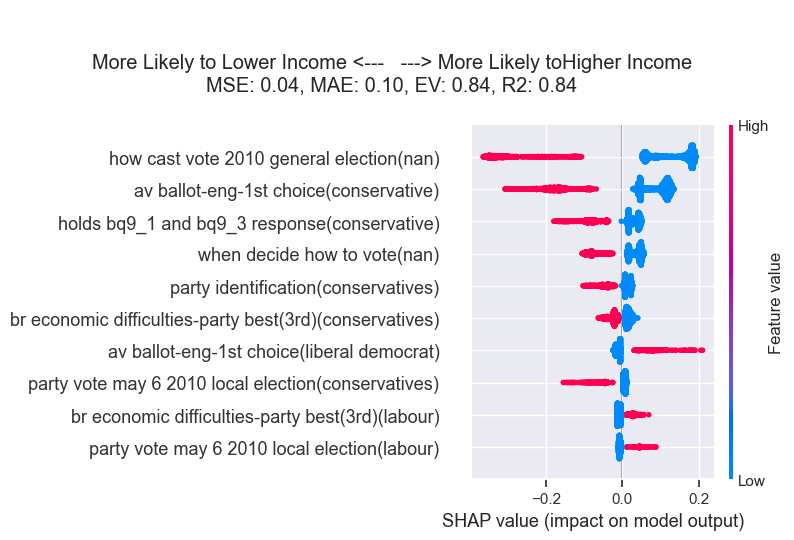

***************************
2015
***************************
MSE: 0.04, MAE: 0.12, EV: 0.81, R2: 0.81


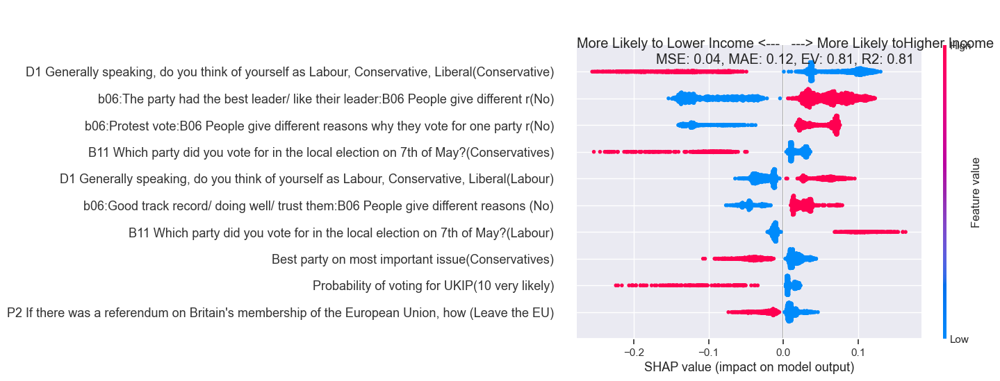

***************************
2017
***************************
MSE: 0.05, MAE: 0.11, EV: 0.82, R2: 0.82


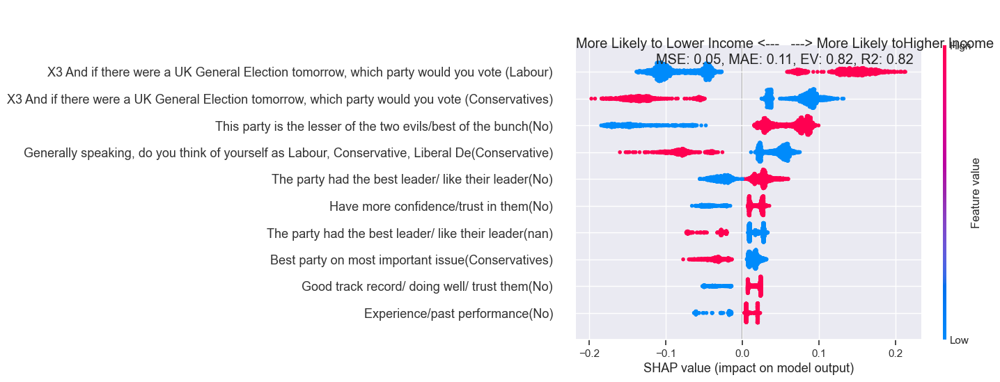

***************************
2019
***************************
MSE: 0.06, MAE: 0.14, EV: 0.75, R2: 0.75


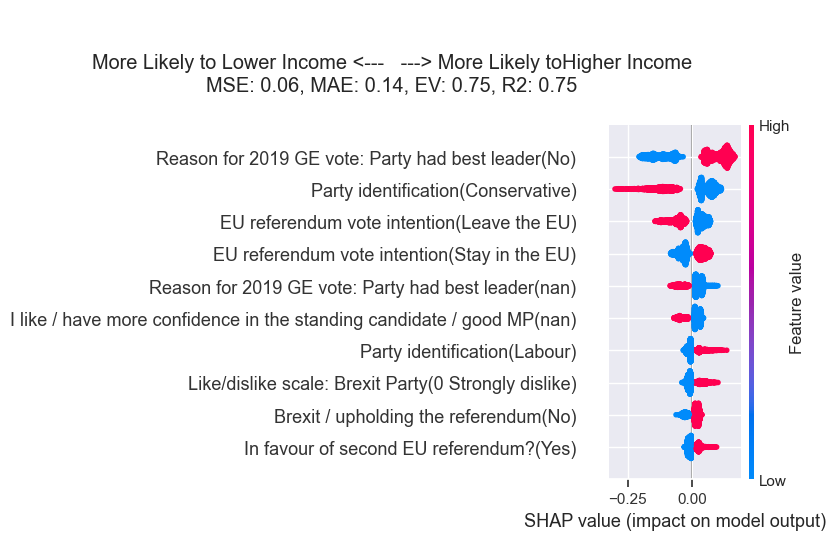

DNV
***************************
1959
***************************
MSE: 0.06, MAE: 0.14, EV: 0.51, R2: 0.50


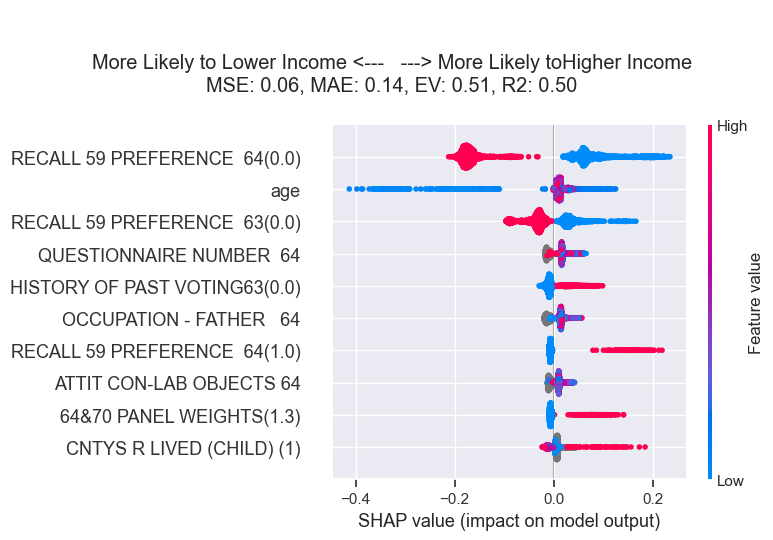

***************************
1964
***************************
MSE: 0.03, MAE: 0.08, EV: 0.68, R2: 0.68


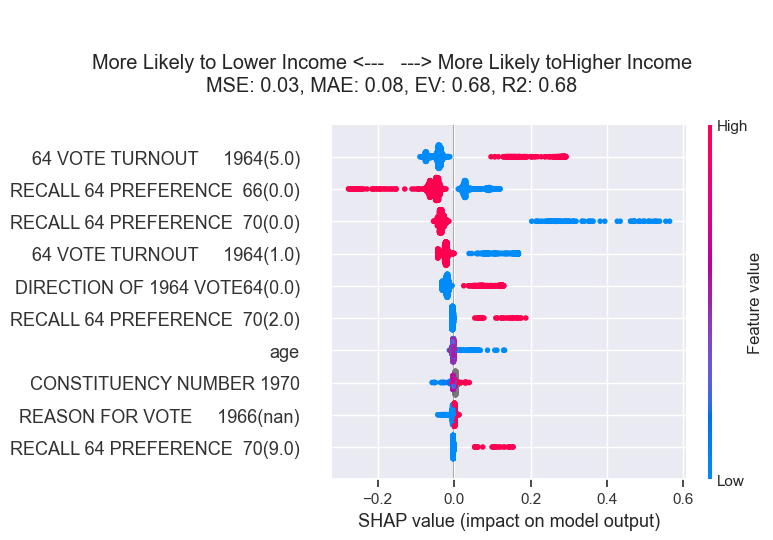

***************************
1966
***************************
MSE: 0.01, MAE: 0.04, EV: 0.89, R2: 0.89


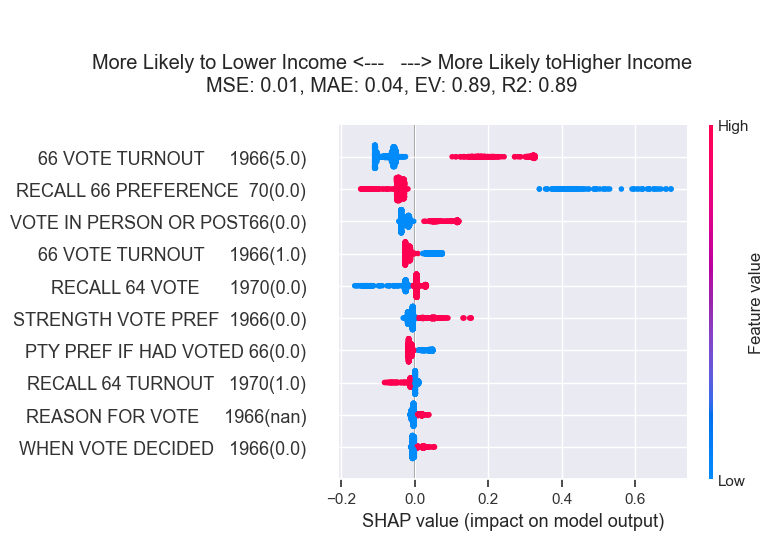

***************************
1970
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


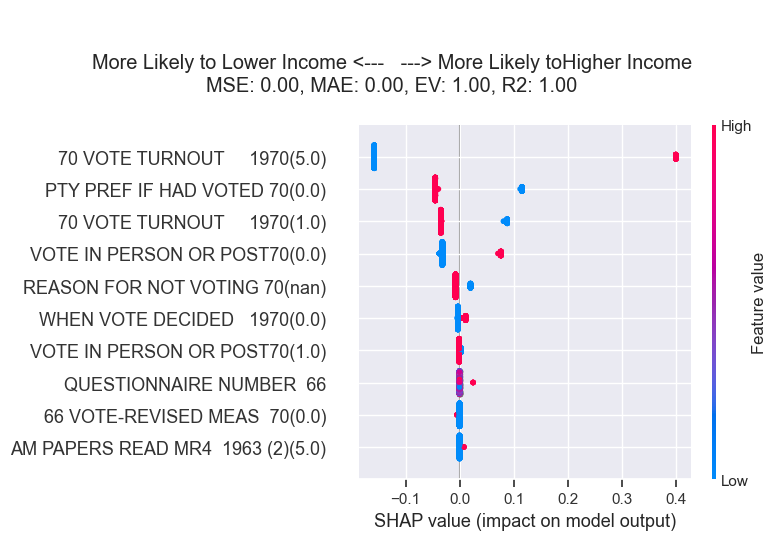

***************************
1974_oct
***************************
MSE: 0.00, MAE: 0.00, EV: 0.99, R2: 0.99


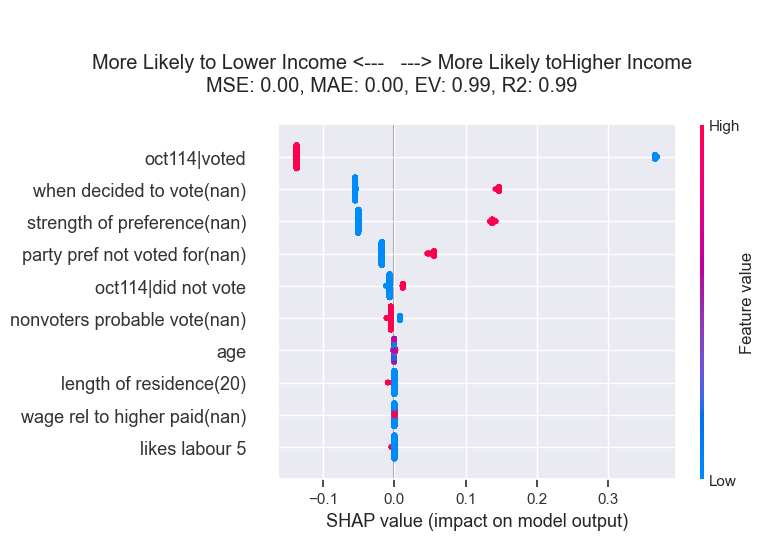

***************************
1974_feb
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


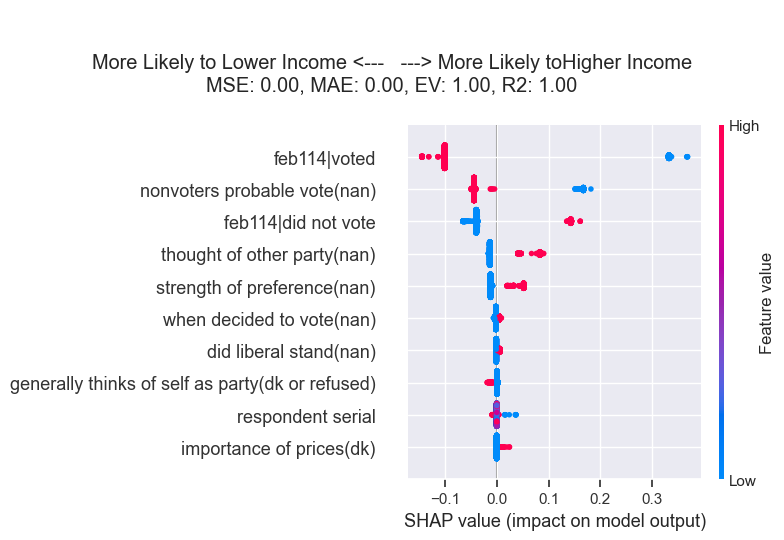

***************************
1979
***************************
MSE: 0.00, MAE: 0.01, EV: 0.99, R2: 0.99


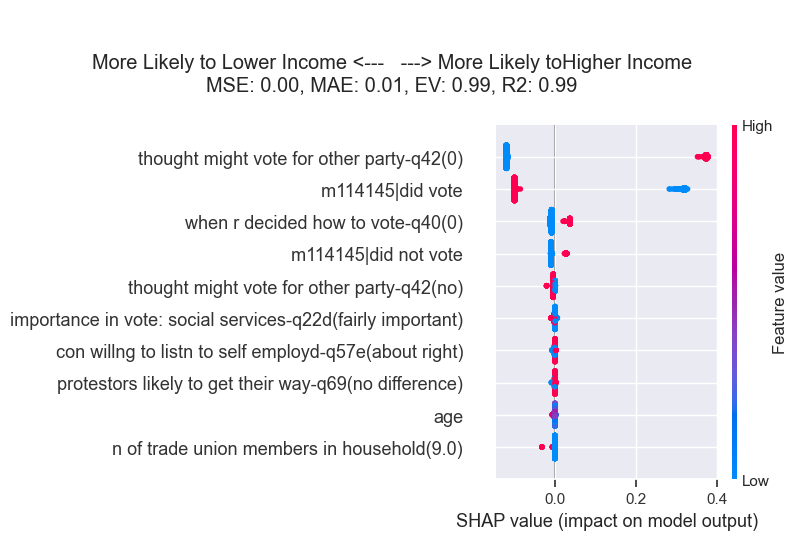

***************************
1983
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


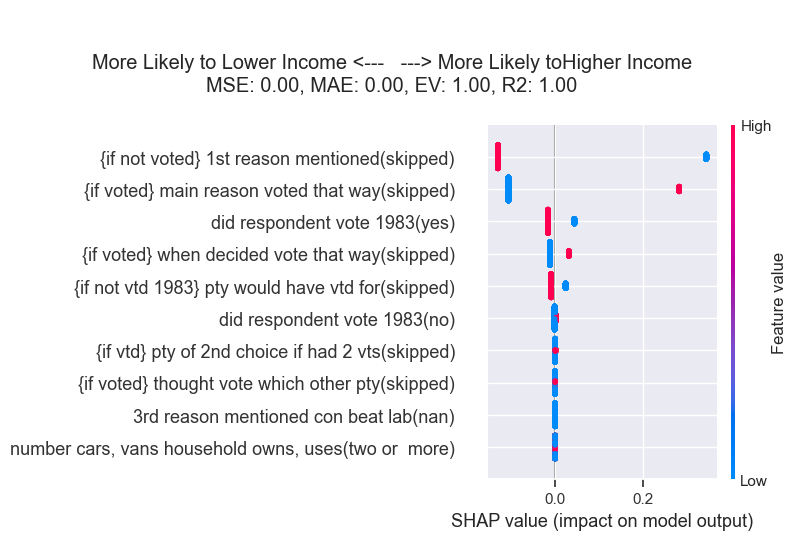

***************************
1987
***************************
MSE: 0.00, MAE: 0.01, EV: 0.98, R2: 0.98


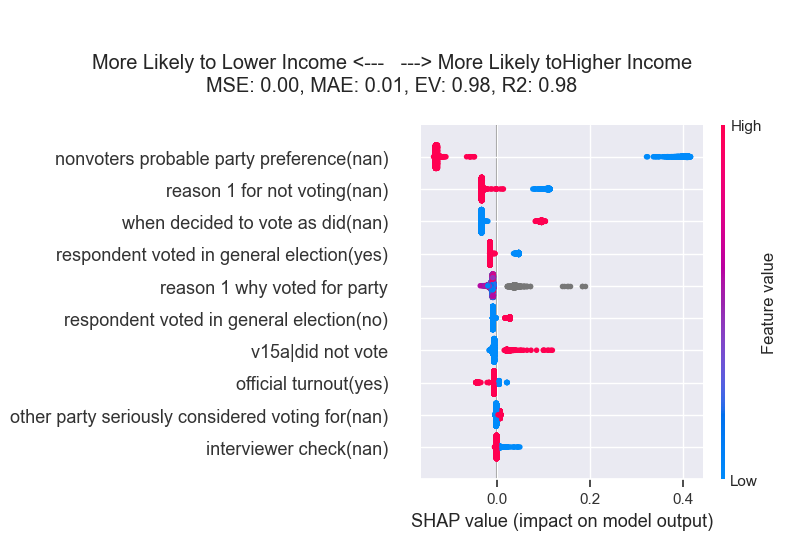

***************************
1992
***************************
MSE: 0.00, MAE: 0.01, EV: 0.99, R2: 0.99


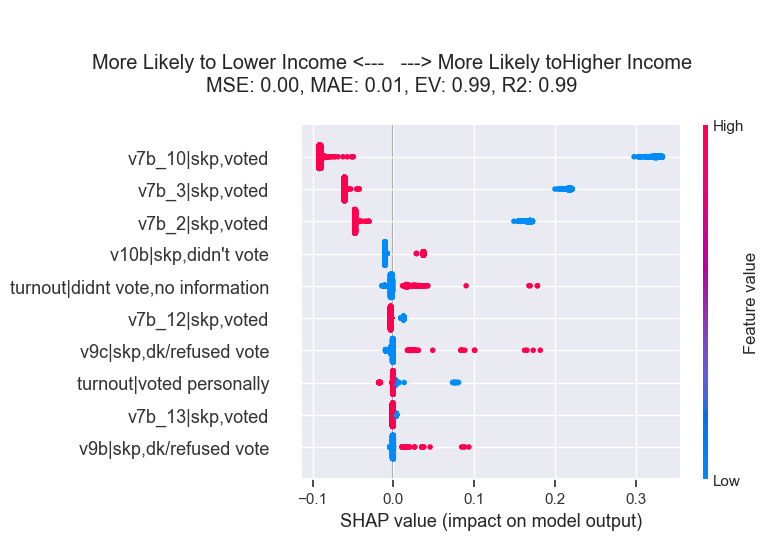

***************************
1997
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


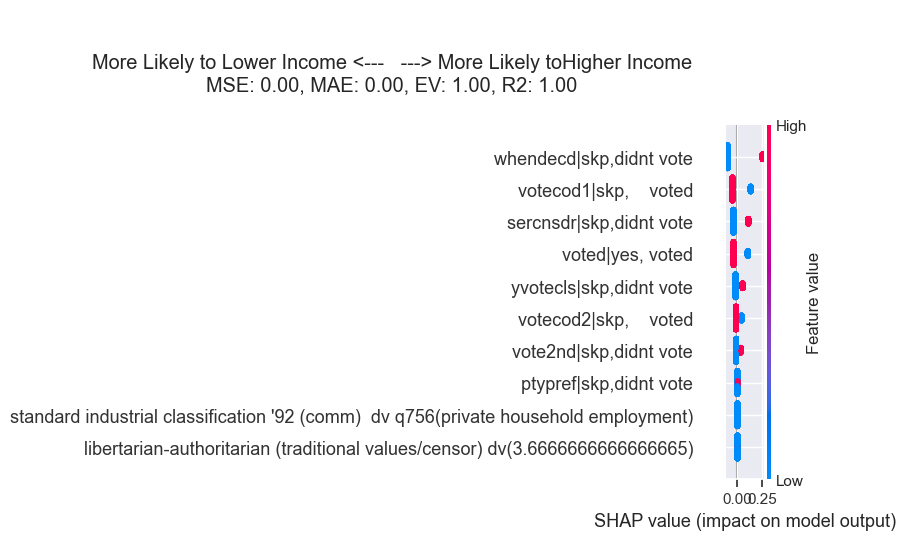

***************************
2001
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


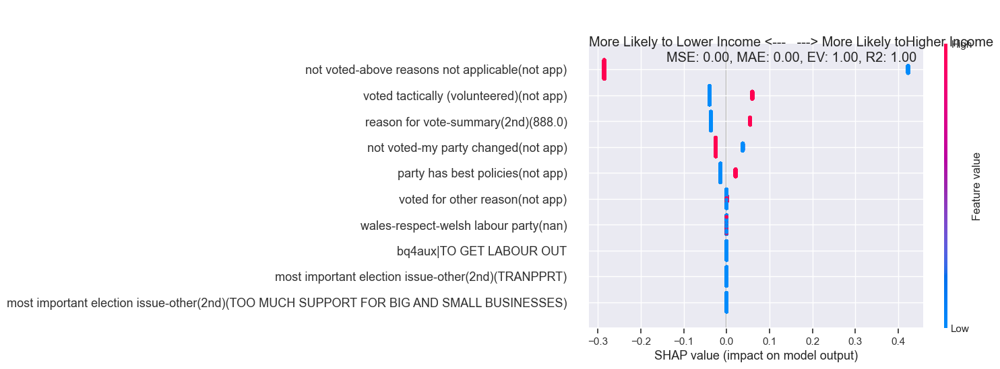

***************************
2005
***************************
MSE: 0.00, MAE: 0.01, EV: 1.00, R2: 1.00


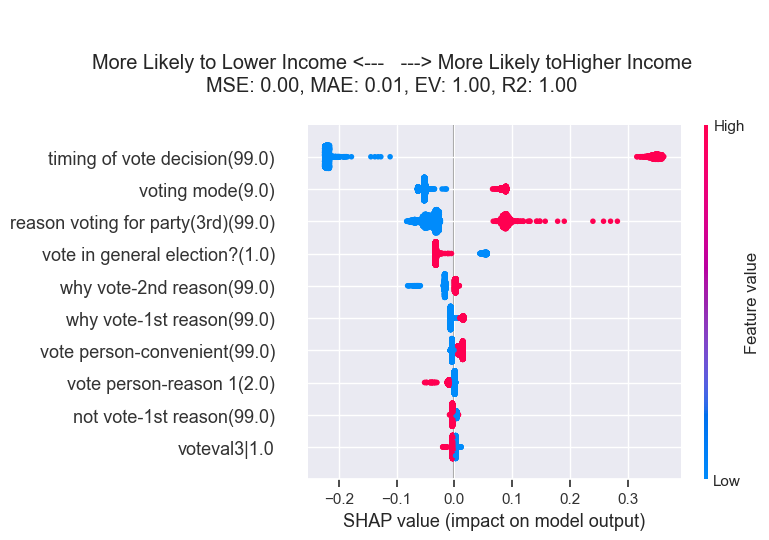

***************************
2010
***************************
MSE: 0.00, MAE: 0.01, EV: 1.00, R2: 1.00


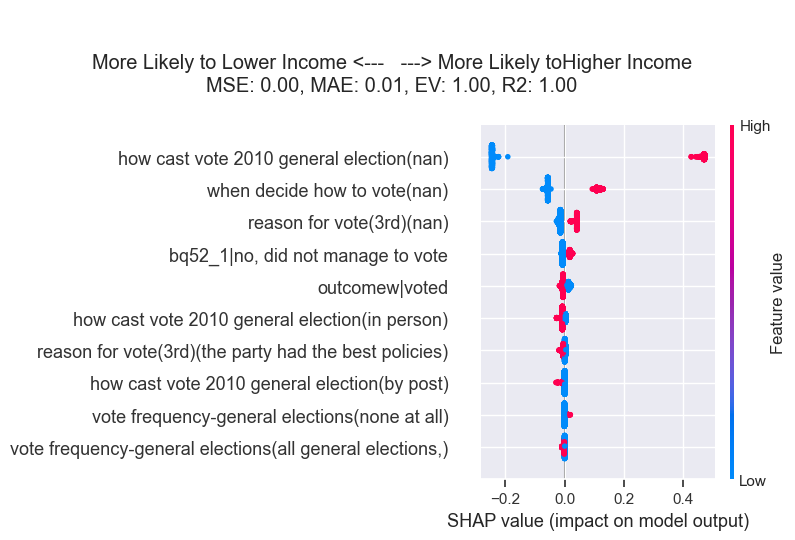

***************************
2015
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


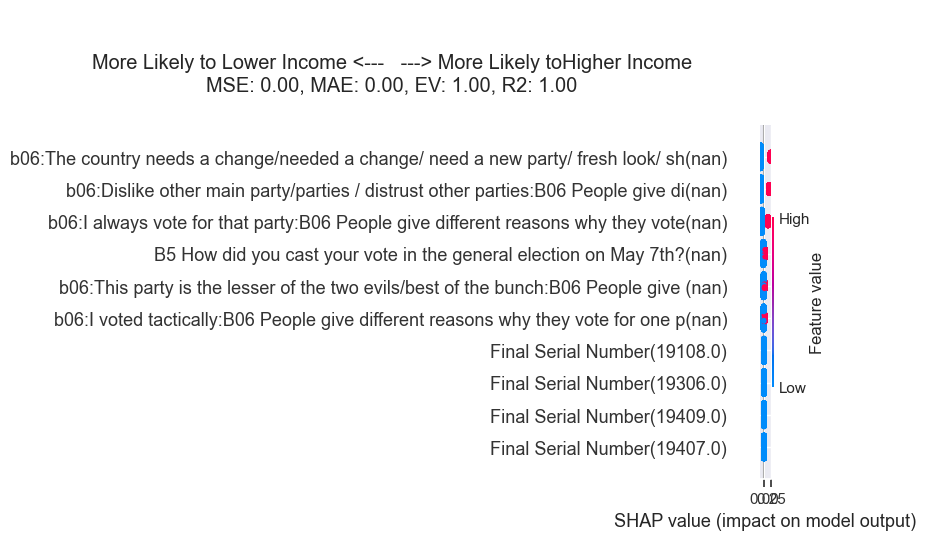

***************************
2017
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


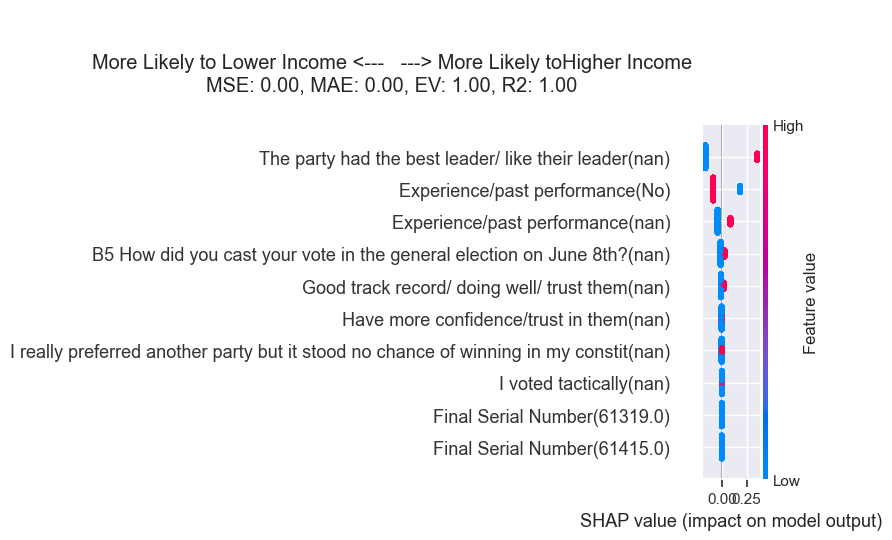

***************************
2019
***************************
MSE: 0.00, MAE: 0.00, EV: 1.00, R2: 1.00


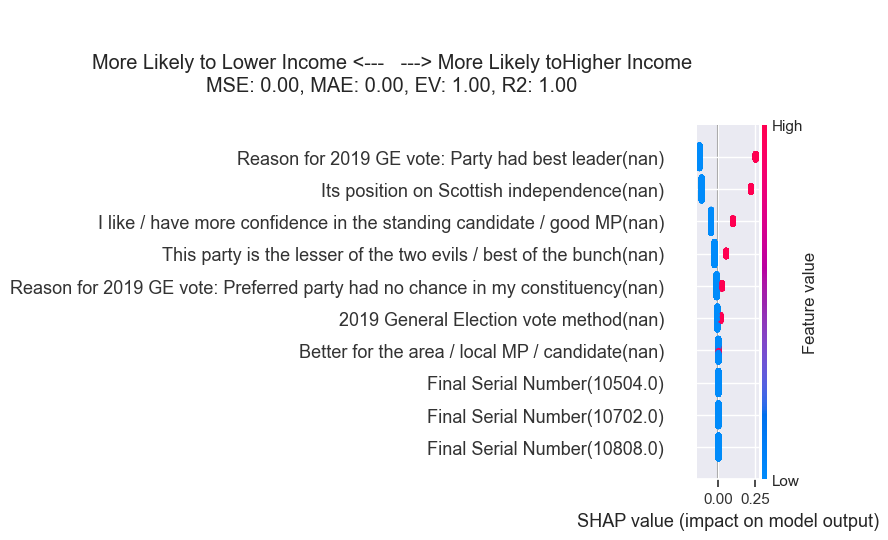

In [210]:
# generic_cols = f2f_harmonised.columns

vote_vars  = ['oct115','feb115','b02','vote_bes','q9a','m115147','v9a','v8a']

drop_vars = ['y45',
 'y46a',
 'Q24_CSES',
 'y45',
 'y45',
 'bq11a',
 'bq11b',
 'bq11c',
 'bq11d',
 'bq11e',
 'bq11',
 'tq77',
 'tq79a',
 'tq79b',
 'tq79c',
 'bq7',
 'elregon',
 'elregnot',
 'elregtxt','aq65_2',
 'bq93_2',
 'zq93_2',
 'aq50b',
 'bq79b',
 'tq79b',
 'owner91',
 'owner',
 'aq40b',
 'bq74b',
 'morts','aq65_1', 'aq50a', 'bq79a', 'tq79a', 'aq40a', 'bq74a', 'owns', 'v919b','y03','cgender',
'feb245','oct245',
'tenure2','q65e','m187a282','v915','v916','v917','v851','v852','m184239','feb184','oct184','v853','v854','q65c','m187a280',
'aq38','rage','v938','v939','v940','v941','v1212','v1213','v937','v1208','v1209','v1210','v1211','v942','v943','v944','v945',
'bgor','zgor','stregion','arfe','region','m071300','feb071','oct071','gor','pregion','agor','agorx','aregion','bregion','tregion','dq2','stregion',
'y26','aq64','bq90','zq90','aq49','bq78','tq78','aq39','bq73','marstat2','marstat','married','v906a','v51a','q54a','m200262','feb200','feb200','oct200','v933','v934','v935','v936'
'Q23_CSES','q24_cses','q25_cses',
'cesw','cage',
'm187a280','m187a281','feb187','feb188','oct187a','feb189','aq65_2','bq93_2','zq93_2','aq50b','bq79b','tq79b','aq40b','bq74b','morts', 
'v919e','v1215','v1216','v1217','v1218','education','trades','v53a','v919d','v919f','edlevel','y10_banded',
'hhincqui','hhinquis','hhinquie','[if ever worked] r member of trade union',
"y11","zq101","tq108","ethns","raceori2","v915a","v58a","q64a","m000317","v285","v284","v283", #ethnicity
'y06b','y06','zq106_2','tq83b','wreligs','religion','v916','v59a','q63a','m495234','oct495','v920','religsum','religs',#religion
'y07','tenure1','tenure2','q52c',
            ]

drop_vars = drop_vars+vote_vars

for target in ["AuthRight","LibLeft","DNV"]:
    print("=====================")
    print(target)
    print("=====================")
    for ge in f2f_harmonised["dataset"].unique()[::-1]:
#     ['1987','1992', '1997', '2001', '2005', '2010', '2015',           '2017', '2019']:
        print("***************************")
        print(ge)
        print("***************************")
        temp_drop = vote_var_dict[ge]+past_vote_var_dict[ge]
        run_ge_regression(ge,target,demo_var_only=False, drop_vars = drop_vars+temp_drop+first_vote_list, harm_vars=harm_vars,
                          )

In [206]:
temp_drop

['v1157',
 'v1158',
 'v1159',
 'v515',
 'v516',
 'v517',
 'v518',
 'v364',
 'v1168',
 'v1170',
 'v1171',
 'v1169',
 'v1168',
 'v1170',
 'v1155',
 'v524',
 'v1153',
 'v525']

In [ ]:
# vote variables
# change_of_vote variables
# past/recall vote variables
# second/third vote variables
# non-voting/reason for non-voting
# vote in person/post
# voted y/n
# considered voting for <other party Y>
# voted for party in <local election>
# if voted (party would have voted for/why voted that way)

# interviewer assigned category
# reason 1/2/3/4 why voted for party
# have voted X since 1964

# did X stand?

# con vs lab id
# party id
# think of self as party<>
# pref party on X
# like <party>



index
0       England
1       England
2       England
3       England
4       England
         ...   
2917        NaN
2918        NaN
2919        NaN
2920        NaN
2921        NaN
Name: reg_country, Length: 52731, dtype: object

In [236]:
corr_dict = {}
for ge in f2f_harmonised["dataset"].unique():
    mask = f2f_harmonised["dataset"]==ge
    corr_dict[ge] = pd.get_dummies(BES_df_list[ge]).corrwith(f2f_harmonised["AuthRight"][mask])

<AxesSubplot:>

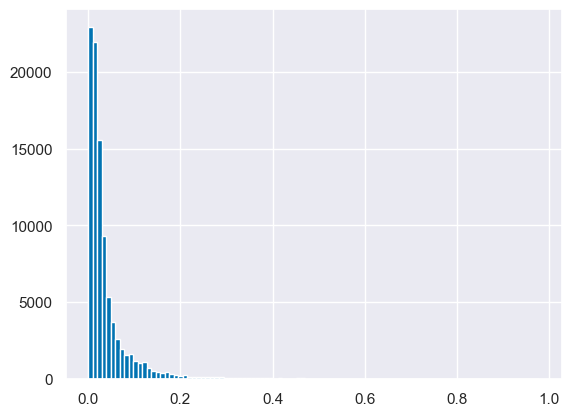

In [241]:
pd.DataFrame(corr_dict).abs().stack().hist(bins=100)

In [280]:
corr_vars = pd.DataFrame(corr_dict).index[pd.DataFrame(corr_dict).abs()[pd.DataFrame(corr_dict).abs()>.70].notnull().any(axis=1)]

In [281]:
pd.DataFrame(BES_label_list).loc[list(set(["_".join(x.split("_")[:-1]) if "_" in x else x for x in corr_vars]))].fillna(method='bfill',axis=1)["2019"]

party                          holds bq9_1 and bq9_3 response
oct115                                        party voted for
b02                                2019 General Election vote
vote_bes     which party did you vote for in g.election? q216
q9a                                [if voted] party voted for
m129156               generally speaking think of self as-q48
m000160                    how strongly against con party-q52
bq8b                                feelings afghan war-happy
m115147               party voted for in general election-q41
partyid                           r's party identification dv
q14a                       strength of non support: con party
v221a                r lean towards a particular party? q221a
v9a               which party did you vote for in g.elec? q9a
bq12_2                       party vote 2010 general election
x3          X3 And if there were a UK General Election tom...
v8a                       party voted for in general election
oct129  

In [ ]:
# vote vars:
# oct115,feb115,b02,vote_bes,q9a,m115147,v9a,v8a
# x3, v18fil

In [272]:
# bq12_2 past vote?, vote97s, v922, m125155

u05                                          2017 vote
oct115                                 party voted for
v1123                         ATTIT CON-LAB OBJECTS 66
oct124a                               vote in feb 1974
m000152                          district council vote
                              ...                     
vote97s                              vote 1997-summary
ptyaff     r think of self as <political party> a6b13a
v922         who did r vote for in 1987 gen.elec? q922
ptyidsc      party r feels close/little close to q215c
m125155                       party voted for 1970-q47
Name: 2019, Length: 115, dtype: object

In [ ]:
 's01_1': 'Probability of voting for Conservatives',
 's01_2': 'Probability of voting for Labour',
 's01_3': 'Probability of voting for Liberal Democrats',
 's01_4': 'Probability of voting for UKIP',
 's01_5': 'Probability of voting for Greens',
 's01_6': 'Probability of voting for SNP',
 's01_7': 'Probability of voting for Plaid Cymru',
    
 'q11_cses_1': 'Like/dislike: Conservatives',
 'q11_cses_2': 'Like/dislike: Labour',
 'q11_cses_3': 'Like/dislike: Liberal Democrats',
 'q11_cses_4': 'Like/dislike: UKIP',
 'q11_cses_5': 'Like/dislike: Green',
 'q11_cses_6': 'Like/dislike: SNP',
 'q11_cses_7': 'Like/dislike: Plaid Cymru',
    
 'i01_1': 'Like leader: Sturgeon',
 'i01_2': 'Like leader: Wood',
 'i01_3': 'Like leader: Corbyn',
 'i01_4': 'Like leader: May',
 'i01_5': 'Like leader: Farron',
 'i01_6': 'Like leader: Lucas',
 'i01_7': 'Like leader: Nuttall',    

In [212]:
BES_label_list["2017"]

{'finalserialno': 'Final Serial Number',
 'serial': 'Respondent Serial Number',
 'a01': 'A1: Most important issue',
 'a02': 'Best party on most important issue',
 'a03': 'Interest in politics',
 'm02_1': "Politicians don't care what people like me think",
 'm02_2': 'It is often difficult for me to understand what is going on in government and po',
 'm02_3': 'People like me have no say in what government does.',
 'm02_4': "The main political parties in Britain don't offer voters real choices in electio",
 'm02_5': 'Parties and politicians in the UK are more concerned with fighting each other th',
 'm02_6': 'Politicians ignore the issues I really care about',
 'b01': 'B1 Talking with people about the general election on June 8th, we have found tha',
 'b02': 'B2 Which party did you vote for in the general election?',
 'b04': 'B4 If you had voted, which party would you probably have voted for?',
 'b05': 'B5 How did you cast your vote in the general election on June 8th?',
 'b0601': 'The pa

In [33]:
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"]

index
0       LAB
1       CON
2       LAB
3       CON
4       LAB
       ... 
2917     TY
2918     TY
2919     TY
2920    LAB
2921     TY
Name: vote_complete, Length: 2922, dtype: object

In [60]:
all_vote_rel_stubs = [
                    # vote vars
                     "b02","bq12","vote05","bq8b","vote_bes","v9a","v8a","q9a","m115147",
                     "oct115","feb115","v364","v365","v525","v524","v1153","v1155","v1157",
                     "v1162","v1164","v1168","v1169",
                    # past vote
                     "u05","bq46","aq41","aq36","vote97s","aq28a","vote92","v922","v65a","q11",
                     "m115153","m124a154","oct125","oct124a","feb125","feb126",
                     
                     ]

In [67]:
re.match("|".join(all_vote_rel_stubs),"b02") is not None

True

In [68]:
for ge in f2f_harmonised["dataset"].unique():
    
    corr_df = pd.get_dummies(BES_df_list[ge].astype('category'))\
        .corrwith(f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_complete"]=="CON")
    
    temp = corr_df.sort_values().dropna().tail(20)
    temp = temp.append(corr_df.sort_values().dropna().head(5))
    
    temp = pd.DataFrame(temp)
    var_stubs = ["_".join(x.split("_")[:-1]) if "_" in x else x for x in temp.index ]
    temp['labels'] = [BES_label_list[ge][x] for x in var_stubs ]
    temp['var_stub'] = var_stubs
    
    
    print("******************",ge,"***********************")
    display(temp[temp['var_stub'].apply(lambda x: re.match("|".join(all_vote_rel_stubs),x) is None)])

****************** 2019 ***********************


,0,labels,var_stub
b0604_No,0.386181,Reason for 2019 GE vote: Tactical voting,b0604
b0613_No,0.386277,More trustworthy / confident they know what th...,b0613
b0608_No,0.387061,Party represents the working class,b0608
"b01_Yes, voted",0.387259,2019 General Election turnout,b01
b0615_No,0.387757,I wanted another referendum,b0615
b0616_No,0.388056,Influence of friends / family,b0616
b0618_No,0.388260,Protection of the planet / prefer the Green party,b0618
b0619_No,0.389459,Protest vote,b0619
b0617_No,0.389553,Its position on Scottish independence,b0617
b0607_No,0.390256,Better for the area / local MP / candidate,b0607


****************** 2017 ***********************


,0,labels,var_stub
b0610_No,0.353640,Dislike other main party/parties / distrust ot...,b0610
b0613_No,0.354031,This party will do a better job than others,b0613
q6_cses_Good job,0.354933,Q6_CSES. Now thinking about the performance of...,q6_cses
b0617_No,0.355341,Experience/past performance,b0617
b0607_No,0.356501,Influenced by relative/ spouse,b0607
b0612_No,0.356816,For historic reasons/tradition,b0612
"b01_Yes, voted",0.357239,B1 Talking with people about the general elect...,b01
b0606_No,0.358867,Protest vote,b0606
b0611_No,0.360665,The country needs a change/needed a change/ ne...,b0611
b0616_No,0.362132,Party represents the working class,b0616


****************** 2015 ***********************


,0,labels,var_stub
b06_12_No,0.383755,b06:For historic reasons/tradition:B06 People ...,b06_12
b06_14_No,0.384086,b06:Have more confidence/trust in them:B06 Peo...,b06_14
b06_20_No,0.384101,b06:Not stated:B06 People give different reaso...,b06_20
"b01_Yes, voted",0.384101,B1 Talking with people about the general elect...,b01
b06_17_No,0.384762,b06:Experience/past performance:B06 People giv...,b06_17
b06_19_No,0.385484,b06:Don't know:B06 People give different reaso...,b06_19
b06_05_No,0.385820,b06:I always vote for that party:B06 People gi...,b06_05
b06_11_No,0.386735,b06:The country needs a change/needed a change...,b06_11
b06_16_No,0.387076,b06:Party represents the working class:B06 Peo...,b06_16
b06_18_No,0.387085,b06:Other:B06 People give different reasons wh...,b06_18


****************** 2010 ***********************


,0,labels,var_stub
aq28_david cameron,0.377430,party leader best on economy,aq28
aq3_conservatives,0.388475,party best most important issue,aq3
aq25_conservatives,0.396618,br economic difficulties-party best,aq25
bq17_2_8,0.398974,feelings-conservative party(3rd),bq17_2
cq7_1_keeps its promises,0.404343,conservatives keep-break promises,cq7_1
aq57_2_conservatives,0.413863,party supporter-which party,aq57_2
cq5_1_in touch with ordinary people,0.417703,conservatives in or out of touch,cq5_1
aq11_3_conservatives,0.432925,decided-vote which party,aq11_3
aq10_1_conservatives,0.476904,party identificaiton,aq10_1
cq23_1_10-very likely,0.481901,likely ever vote conservative,cq23_1


****************** 2005 ***********************


,0,labels,var_stub
cq3a_2,0.420944,con-look interests working class,cq3a
bq63bx_2,0.454889,party supporter-which party(5th),bq63bx
bq63by_2,0.457612,party supporter-which party(4th),bq63by
bq9ax_2,0.465405,party identification(4th),bq9ax
cq6a_1,0.473265,con-keeps-breaks promises,cq6a
cq4a_1,0.481274,con-in-out touch,cq4a
aptysupw_2,0.488033,party supporter-party,aptysupw
bq9ay_2,0.498234,party identification(5th),bq9ay
aq10c_2,0.513235,decided-which party,aq10c
cq22a_10,0.522929,how likely vote conservative,cq22a


****************** 2001 ***********************


,0,labels,var_stub
cq10c_fairly well,0.297518,cons looks after-unemployed,cq10c
bq11b_8,0.306008,feel about conservative party(2nd),bq11b
bq15a_breaks promises,0.308226,labour-keeps/breaks promises,bq15a
bq19a_breaks promises,0.315146,tony blair-keeps/breaks promises(2nd),bq19a
cq10a_fairly well,0.334548,cons looks after-working class,cq10a
aq3_conservative,0.420046,party best on most important issue,aq3
aq22_conservative,0.438365,if economic difficulties-best party,aq22
cq32a_very likely,0.456552,prob vote-conservative,cq32a
bq5_conservative,0.484756,party best handle most important issue,bq5
aq7b_conservative,0.506650,if decided - party vote,aq7b


****************** 1997 ***********************


,0,labels,var_stub
priveduc_definitely should not,0.313449,government should get rid of private education...,priveduc
"wagemin_no,cost jobs",0.328322,should the law set a minimum wage? q211b,wagemin
labfeel_against,0.331859,how feel about labour party ? q232,labfeel
socchap2_shouldn't sign up,0.335917,should gb sign up to social chapter? q211a,socchap2
conintbe_fairly closely,0.341822,conservative party look after people on benefi...,conintbe
majpm_very good,0.362461,john major would do a good job as prime minist...,majpm
cand1pty_conservative candidate,0.367874,candidate 1 remembered: political party q218,cand1pty
confeel_strongly in favour,0.384669,how feel about conservative party? q231,confeel
conintun_fairly closely,0.387756,conservative party look after unemployed peopl...,conintun
conkpprm_keeps its promises,0.395698,r describe conservative as party keeps promise...,conkpprm


****************** 1992 ***********************


,0,labels,var_stub
v45a_more privatisation,0.360277,r's view on nationalisation/privatisation q45a,v45a
v9c_liberal democrat,0.360364,what would be your 2nd choice party? q9c,v9c
v24a_capable strong lead,0.368101,john major capable strong leader? q24a,v24a
v14b_strongly against,0.371200,r feel about the labour party? q14b,v14b
v16a_moderate,0.382258,are conservatives an extreme party? q16a,v16a
v19b_not capable,0.398985,labour party capable of strong government? q19b,v19b
v25a_caring,0.417369,describe john major as caring? q25a,v25a
v14a_strongly in favour,0.452985,r feel about the conservative party? q14a,v14a
vb13a_conservative,0.453444,r think of self as <political party> b13a,vb13a
v217_p1_conservative party,0.454143,political party 1st person supports q217.p1,v217_p1


****************** 1987 ***********************


,0,labels,var_stub
v123c_fairly closely,0.388981,how much con look after interests of: unemployed,v123c
v20g1_likeable,0.396229,thatcher: likeable,v20g1
v8c_sdp/lib alliance,0.418114,second preference party,v8c
v13a_2.0,0.429052,for or against conservative party,v13a
v122b1_conservative,0.438402,party id of person most discussed politics,v122b1
v36a_more privatisation,0.442068,more nationalisation/privatisation,v36a
v13a_1.0,0.444374,for or against conservative party,v13a
v123a_fairly closely,0.478632,how much con look after interests of: working ...,v123a
v20f1_unite nation,0.512573,thatcher: unite/divide nation,v20f1
v19f1_unite nation,0.517897,conservative party: unite/divide nation,v19f1


****************** 1983 ***********************


,0,labels,var_stub
q16e_thatcher,0.427441,party leader: get the most out of a team,q16e
q16c_thatcher,0.434707,party leader: improve brit status abroad,q16c
q16f_thatcher,0.439976,party leader: ordinary peoples problems,q16f
q29b_fairly well,0.446774,"con govt handled unemployt well,not well",q29b
q30c_disagree,0.456456,"agree,disagree: govt fault unemplyt high",q30c
q16d_thatcher,0.458348,party leader: all groups in society,q16d
q20d6_con,0.483192,party view closest to own: law & order,q20d6
q16a_thatcher,0.491773,party leader: best to unite the nation,q16a
q20d4_con,0.496824,party view closest to own: welfare servs,q20d4
q20d5_con,0.535352,party view closest to own: nationalsn,q20d5


****************** 1979 ***********************


,0,labels,var_stub
m000183_not willing enough,0.349659,lab willng to listn to business&ind-q57c,m000183
m000184_about right,0.355181,con willing to listen to trd unions-q57d,m000184
m026063_fairly well,0.369323,con wd have handled rising prices:-q16b,m026063
m073086_de-nationalize some,0.387524,r's view: nationalization-q24a,m073086
m000181_too willing to listn,0.391665,lab willing to listen to trd unions-q57a,m000181
m000107_conservative,0.403271,party preferred on stand on ec econ-q27e,m000107
m085080_conservative,0.438212,party preferred on social services-q22e,m085080
m000161_v strongly against,0.460090,how strongly against lab party-q52,m000161
m000200_conservative,0.520409,pty preferred on how wages settled-q66e,m000200
m000152_conservative only,0.527447,district council vote,m000152


****************** 1974_feb ***********************


,0,labels,var_stub
feb132_not very strong,0.380192,cons ids against labour,feb132
feb013_very good for all,0.396852,con good for classes,feb013
feb041_not at all,0.400060,miners strike blame mr heath,feb041
feb040_not at all,0.409030,miners strike blame con govt,feb040
feb030_not at all,0.413548,blame prices on con govt,feb030
feb025_fairly well,0.423564,con handled rising prices,feb025
feb131_very strong,0.441063,strength of cons p id,feb131
feb174_too close,0.444881,ties between labour and unions,feb174
feb111_usually,0.458398,trust conservatives,feb111
feb090_conservative,0.472822,party to deal with communists,feb090


****************** 1974_oct ***********************


,0,labels,var_stub
oct132_not very strong,0.352679,cons ids against labour,oct132
oct432_cons somewhat better,0.355309,parties handling of unemployment,oct432
oct111_usually,0.361455,trust conservatives,oct111
oct481_con and lib,0.379891,next best govt oct 1974,oct481
oct013_very good for all,0.392932,con good for classes,oct013
oct174_too close,0.418484,ties between labour and unions,oct174
oct131_very strong,0.420734,strength of cons p id,oct131
oct016a_very much for cntry,0.422197,con best for country,oct016a
oct085_conservative,0.462662,party pref on social services,oct085
oct131_fairly strong,0.474183,strength of cons p id,oct131


****************** 1970 ***********************


,0,labels,var_stub
v363_1.0,0.417810,DIRECTION OF 1964 VOTE64,v363
v445_1.0,0.423110,PARTY SELF-IMAGE 1964,v445
v1161_1.0,0.427267,64 VOTE OR PREFERENCE 64,v1161
v1143_1.0,0.427749,DIR PARTY SELF-IMAGE 64,v1143
v537_1.0,0.428153,FIRST VOTE 1963,v537
v551_1.0,0.446904,VOTING INTENTION 1963,v551
v517_1.0,0.451000,RECALL 64 VOTE 1966,v517
v1158_1.0,0.451000,64 VOTE-REVISED MEAS 66,v1158
v1151_1.0,0.456280,DIR CURRENT VOTE PREF 63,v1151
v490_1.0,0.472425,1ST PARTY PREFERENCE,v490


****************** 1966 ***********************


,0,labels,var_stub
v445_1.0,0.432613,PARTY SELF-IMAGE 1964,v445
v1143_1.0,0.434576,DIR PARTY SELF-IMAGE 64,v1143
v551_1.0,0.439513,VOTING INTENTION 1963,v551
v1170_1.0,0.443856,TURNOVER 59-64 VOTE 1964,v1170
v1159_1.0,0.445991,64 VOTE-REVISED MEAS 70,v1159
v518_1.0,0.445991,RECALL 64 VOTE 1970,v518
v1151_1.0,0.450203,DIR CURRENT VOTE PREF 63,v1151
v444_1.0,0.457721,PARTY SELF-IMAGE 1963,v444
v1142_1.0,0.465939,DIR PARTY SELF-IMAGE 63,v1142
v363_1.0,0.470363,DIRECTION OF 1964 VOTE64,v363


****************** 1964 ***********************


,0,labels,var_stub
v1151_1.0,0.548157,DIR CURRENT VOTE PREF 63,v1151
v445_1.0,0.556001,PARTY SELF-IMAGE 1964,v445
v1143_1.0,0.557527,DIR PARTY SELF-IMAGE 64,v1143
v444_1.0,0.561869,PARTY SELF-IMAGE 1963,v444
v526_1.0,0.562660,RECALL 59 VOTE 1966,v526
v1156_1.0,0.562690,59 VOTE-REV MEAS 2 1966,v1156
v1142_1.0,0.566563,DIR PARTY SELF-IMAGE 63,v1142
v1170_1.0,0.574808,TURNOVER 59-64 VOTE 1964,v1170
v446_1.0,0.579706,PARTY SELF-IMAGE 1966,v446
v1161_1.0,0.583834,64 VOTE OR PREFERENCE 64,v1161


****************** 1959 ***********************


,0,labels,var_stub
v530_1.0,0.515161,VOTE-CONSTANT VOTERS 63,v530
v1167_1.0,0.516834,HISTORY OF PAST VOTING63,v1167
v1151_1.0,0.522364,DIR CURRENT VOTE PREF 63,v1151
v1143_1.0,0.525872,DIR PARTY SELF-IMAGE 64,v1143
v445_1.0,0.527395,PARTY SELF-IMAGE 1964,v445
v1158_1.0,0.539129,64 VOTE-REVISED MEAS 66,v1158
v517_1.0,0.539129,RECALL 64 VOTE 1966,v517
v1142_1.0,0.558319,DIR PARTY SELF-IMAGE 63,v1142
v444_1.0,0.558387,PARTY SELF-IMAGE 1963,v444
v537_1.0,0.582703,FIRST VOTE 1963,v537


In [63]:
# 2019
#### reasons for vote
b06(04-19) # reasons for voting
#### traits of party
q01 # Keeps promises
b12 # party looks after interests of working 
#### party id/closeness
Q8_CSES # which party represents your views best
Q17_CSES # which party do you feel closest to
d01 # party identification

# 2017
#### reasons for vote
b06(06-17) # reasons for voting
#### traits of party
q6_cses # Performance of <party> good job???
q02 # Capable strong govt <party>
#### PTV/feel/like
s01 # probability of voting for <party>
#### party id/closeness
q8_cses # Which party represents your views best?
q18_cses # which party do you feel closest to?
d01 # Generally speakiung, do you think of yourself as a ...
#### best party on mii
a02 # best party on mii
#### future vote
x3 # And if there were a UK GE tomorrow ... ## "VI" category/future vote

# 2015
#### reasons for vote
b06_ # reasons for vote
#### traits of party
q01 # Keeps promises <party>
q02 # Capable of strong govt <party>
#### PTV/feel/like
s01 # Prob of voting for <party>
#### party id/closeness
cses_q15 # Which party do you feel closest to?
d01 # Generally speaking, do you think of yourself as a 
#### best party on mii
a02 # best party on mii
#### non-GE election vote
b11 # local election vote

# 2010 (messy)
#### traits of party
cq7 # keeps its promises <party>
cq5 # in touch with ordinary people <party>
#### PTV/feel/like
bq17 # feelings <party>
cq23 # likely ever vote party
#### party id/closeness
party # holds bq9_1 and bq9_3 response - party identification
bq9_1,bq9_3 # party id
aq10 # party identification
aq57 # party supporter <party>
bq61 # party supporter <party>
#### best party on mii
aq3 # party best mii
bq2 # party best mii
#### future vote
aq11_3 # decided-vote which party
#### non-GE election vote
bq52 # vote in 2010 local election

# 2005
#### traits of party
cq3a # party look after interests working class
cq6a # keeps promises
cq4a # in touch
#### PTV/feel/like
cq22 # how like to vote <party>
#### party id/closeness
bq63b # party supporter
aptysupw # party supporter
bptysupw # party supporter summary
bq9ax # party identification
bq9ay # party identification
apartyid # party identification summary
bpartyid # party identification summary
#### best party on mii/economy?
bq2b # party best on mii
bq27 # best partf if econ difficulties
#### future vote
aq10c # decided which party
#### non-GE election vote
bq48b # vote in local elections
# cprecon_1	0.605997	pr ballot rating-cons [eng]	cprecon ????

# 2001
#### traits of party
cq10a # cons look after working
cq10a # cons look after unemployed
bq15a # party breaks/keeps promises
bq19a # leader breaks/keeps promises
#### PTV/feel/like
bq11b # feel about <party>
cq32a # prob vote conservative
#### party id/closeness
aq37b,bq67b # party supporter
aq5a,bq2a # party id
#### best party on mii/economy?
aq3,bq5 # party best on mii
aq22,bq30 # if ec diff best party
#### future vote
aq7b # if decided, party vote
avoteint # vote intention
#### non-GE election vote
bq69b # local election vote

# 1997
#### traits of party
conintbe # con party look after people on benefits
conintun # con party look after unemployed ppl
conintwc # con party look after working class
conkpprm # con party keep/break promises
conclass # con party good for one class?
#### PTV/feel/like
labfeel,confeel # how feel about labour/con party
#### party id/closeness
ptyidsc # party r feels close/little close to q215c
partyid # r's party identification dv
ptythnk # r think of self as (political party)? q199
#### non-GE election vote
votelc # local election vote
#### best pm
majpm # john major would do a good job as pm
bestpm # who would make best pm
cand1pty # candidate 1 remembered: political party q218 ?????

# 1992
#### traits of party
v16a # are conservatives an extreme party? q16a
v19b # labour party capable of strong government? q19b
v25a # describe john major as caring? q25a
v20a # conservatives are a caring party? q20a
v18a # conservative party good for 1 class now? q18a
#### PTV/feel/like
v14a,b # r feel about the labour/con party? q14b
#### party id/closeness
vb13a # r think of self as <political party> b13a
va6a # r think of self as <political party>? a6a
v221a # r lean towards a particular party? q221a
ptyaff # r think of self as <political party> a6b13a
partyid # party affiliation+party closest to combined a
#### 2nd choice party
v9c # what would be your 2nd choice party? q9c
#### leader evaluations
v24a # john major capable strong leader? q24a
v23a # john major looks after one class? q23a

# 1987
#### traits of party
v123c # how much con look after interests of: unemployed
v123a # how much con look after interests of: working ...
v19f1 # conservative party: unite/divide nation
v19e1 # conservative party: caring/uncaring
v19c1 # conservative party: good for one/all classes
#### PTV/feel/like
v13a # for or against conservative party
#### party id/closeness
v12a # party identification
v68 # does any party represent respondent's views
# v122b1 # party id of person most discussed politics
#### 2nd choice party
v8c # second preference party
## leader traits/like
v20g1 # thatcher: likeable
v20f1 # thatcher: unite/divide nation
v20e1 # thatcher: caring/uncaring
v20c1 # thatcher: looks after one/all classes
# v18fil_1.0	0.602651	interviewer assigned category	v18fil ????

# 1983
## leader traits/like
q16 # party leader: <feature>
#### traits of party
q29b # con govt handled unemployt well,not well
q30c # agree,disagree: govt fault unemplyt high
q18c1 # con: good for one,good for all classes
#### party id/closeness
q13a # respondent's party identification
q14a # strength of non support: con party
#### best party on mii/economy?
q20d(1-5) # party view closest to own: <specific policy area>
q33 # party most likely: standard living 3+/10 yr

# 1979
#### traits of party
m000181 # lab willing to listen to trd unions-q57a
m000184 # con willing to listen to trd unions-q57d
#### PTV/feel/like
m000160,m000161 # how strongly against con/lab party-q52
#### party id/closeness
m129156 # generally speaking think of self as-q48
#### best party on mii/economy?
m000085 # party preferred on tax vs services-q23e
m078090 # party preferred on nationalization-q24e
m000205 # pty preferrd on law to regulate tus-q67e
m000094 # party preferred on creation of jobs-q25d
m000200 # pty preferred on how wages settled-q66e
m085080 # party preferred on social services-q22e
m000107 # party preferred on stand on ec econ-q27e
#### non-GE election vote
m000152 # local election vote

# 1974_oct
oct129_conservative	0.721762	generally thinks of self as party	oct129
oct129_labour	-0.515969	generally thinks of self as party	oct129
oct132_not very strong	0.352679	cons ids against labour	oct132
oct132_very strong	0.551490	cons ids against labour	oct132
oct131_very strong	0.420734	strength of cons p id	oct131
oct131_fairly strong	0.474183	strength of cons p id	oct131

oct432_cons somewhat better	0.355309	parties handling of unemployment	oct432
oct111_usually	0.361455	trust conservatives	oct111
oct481_con and lib	0.379891	next best govt oct 1974	oct481
oct480_conservative	0.537689	best govt oct 1974	oct480

oct013_very good for all	0.392932	con good for classes	oct013
oct016a_very much for cntry	0.422197	con best for country	oct016a

oct174_too close	0.418484	ties between labour and unions	oct174

oct085_conservative	0.462662	party pref on social services	oct085
oct103_conservative	0.548598	party pref on wage controls	oct103
oct064_conservative	0.550593	party pref on common market	oct064
oct445_conservative	0.477632	party pref on n sea oil	oct445
oct078_conservative	0.558855	party pref on nationalisation	oct078
oct103_labour	-0.418415	party pref on wage controls	oct103

oct276_98.0	-0.446620	likes cons 1	oct276

# 1974_feb




# 1970






b0604_No                      True
b0613_No                      True
b0608_No                      True
b01_Yes, voted                True
b0615_No                      True
b0616_No                      True
b0618_No                      True
b0619_No                      True
b0617_No                      True
b0607_No                      True
b0605_No                      True
b0614_No                      True
b12_5_Fairly closely          True
Q8_CSES_Conservatives         True
p01_Leave the EU              True
Q17_CSES_Conservatives        True
p02_Leave the EU              True
u05_Conservative             False
d01_Conservative              True
b02_Conservative Party       False
p02_Stay in the EU            True
b02_Labour Party             False
p03b_Yes                      True
b01_No, did not vote          True
q01_2_Breaks its promises     True
Name: var_stub, dtype: bool

In [32]:
# ge vote, past vote(s), local election vote, party id, party closest, prob to vote, party best on mii, which party rep your views best
# did you vote
# party supporter?
# reason for vote

# v363, v1161, v524, v517, v1158, v1153, v364, v1162, 

In [ ]:
#  vote vars
# 2019: b02
# 2017: b02
# 2015: b02
# 2010: bq12_2 (bq12_1 did you vote)
# 2005: vote05, bq12b
# 2001: bq8b
# 1997: vote_bes
# 1992: v9a
# 1987: v8a
# 1983: q9a
# 1979: m115147
# 1974_oct: oct115
# 1974_feb: feb115
# 1970: v1164 (direction v365)
# 1966: v1162 (direction v364)
# 1964: v1157
# 1959: v1169, v1168, v1170, v1155, v524, v1153, v525

# x3 2017 "and if there was a general election tomorrow" ???

# v18fil v18fil_1.0	0.602651	interviewer assigned category (1987) ???


In [ ]:
# past vote vars
# 2019: u05
# 2017: u05
# 2015: u05
# 2010: bq46_1,aq41_1
# 2005: aq36
# 2001: vote97s, aq28a
# 1997: vote92, 
# 1992: v922
# 1987: v65a, v65b
# 1983: q11
# 1979: m115153, m124a154, m125155 (party voted for 74_oct,74_feb,70)
# 1974_oct: oct125, oct124a, 
# 1974_feb: feb125, feb126
# 1970: 
# 1966: (v1170, v1159, v518, v1157, v363, v517, v1158),
# 1964: v1153, v526, v1156, v1170
# 1959: X


# u05                                          2017 vote
# oct115                                 party voted for
# v1123                         ATTIT CON-LAB OBJECTS 66
# oct124a                               vote in feb 1974
# m000152                          district council vote
#                               ...                     
# vote97s                              vote 1997-summary
# ptyaff     r think of self as <political party> a6b13a
# v922         who did r vote for in 1987 gen.elec? q922
# ptyidsc      party r feels close/little close to q215c
# m125155                       party voted for 1970-q47

In [183]:
# past GE vote
f2f_harmonised["vote_past(1 GE ago)"] = np.nan

ge="2019"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

ge="2017"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

ge="2015"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['bq46_1']

ge="2005"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['aq36']

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['vote97s']

ge="1997"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['vote92']

ge="1992"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['v922']

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['v65a']

ge="1983"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['q11']

ge="1979"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['m115153']

ge="1974_oct"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['oct125']

ge="1974_feb"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['feb125']

ge="1970"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1966","vote_complete"]

ge="1966"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"]

ge="1964"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1959"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

In [186]:
# past GE vote (2 GEs ago)
f2f_harmonised["vote_past(2 GEs ago)"] = np.nan

# ge="2019"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

# ge="2017"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

# ge="2015"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

ge="2010"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq41_1']

# ge="2005"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq36']

ge="2001"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq28a']

# ge="1997"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['vote92']

# ge="1992"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['v922']

ge="1987"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['v65b']

# ge="1983"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['q11']

ge="1979"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['m124a154']

ge="1974_oct"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['oct124a']

ge="1974_feb"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['feb126']

ge="1970"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1964","vote_complete"]

ge="1966"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1964"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1959"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

In [187]:
# past GE vote (3 GEs ago)
f2f_harmonised["vote_past(3 GEs ago)"] = np.nan

# ge="2019"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

# ge="2017"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

# ge="2015"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['u05']

# ge="2010"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq41']

# ge="2005"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq36']

# ge="2001"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['aq28a']

# ge="1997"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['vote92']

# ge="1992"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['v922']

# ge="1987"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['v65b']

# ge="1983"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['q11']

ge="1979"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['m125155']

# ge="1974_oct"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['oct124a']

# ge="1974_feb"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = BES_df_list[ge]['feb126']

ge="1970"
f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1966"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1964"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(2 GEs ago)"] = f2f_harmonised.loc[f2f_harmonised["dataset"]=="1959","vote_complete"]

# ge="1959"
# f2f_harmonised.loc[f2f_harmonised["dataset"]==ge,"vote_past(1 GE ago)"] = BES_df_list[ge]['u05']

{'2019': {'p01': 'EU referendum vote recalled'},
 '2017': {},
 '2015': {},
 '2010': {},
 '2005': {},
 '2001': {},
 '1997': {},
 '1992': {},
 '1987': {},
 '1983': {},
 '1979': {},
 '1974_feb': {},
 '1974_oct': {},
 '1970': {'v512': 'RECALL 66 TURNOUT   1970',
  'v513': 'RECALL 66 VOTE      1970',
  'v514': 'RECALL 66 PREFERENCE  70',
  'v515': 'RECALL 64 TURNOUT   1966',
  'v516': 'RECALL 64 TURNOUT   1970',
  'v517': 'RECALL 64 VOTE      1966',
  'v518': 'RECALL 64 VOTE      1970',
  'v519': 'RECALL 64 PREFERENCE  66',
  'v520': 'RECALL 64 PREFERENCE  70',
  'v521': 'RECALL 59 TURNOUT   1963',
  'v522': 'RECALL 59 TURNOUT   1964',
  'v523': 'RECALL 59 TURNOUT   1966',
  'v524': 'RECALL 59 VOTE      1963',
  'v525': 'RECALL 59 VOTE      1964',
  'v526': 'RECALL 59 VOTE      1966',
  'v527': 'RECALL 59 PREFERENCE  63',
  'v528': 'RECALL 59 PREFERENCE  64',
  'v1153': '59 VOTE-REVISED-MEAS  63',
  'v1154': '59 VOTE-REVISED       64',
  'v1156': '59 VOTE-REV MEAS 2  1966',
  'v1157': '64 V

In [ ]:
RECALL 59 VOTE 1966	v526
v1156_1.0	0.562690	59 VOTE-REV MEAS 2 1966	v1156
v1154_1.0	0.731841	59 VOTE-REVISED 64	v1154
{'v512': 'RECALL 66 TURNOUT   1970',
  'v513': 'RECALL 66 VOTE      1970',
  'v514': 'RECALL 66 PREFERENCE  70',
  'v515': 'RECALL 64 TURNOUT   1966',
  'v516': 'RECALL 64 TURNOUT   1970',
  'v517': 'RECALL 64 VOTE      1966',
  'v518': 'RECALL 64 VOTE      1970',
  'v519': 'RECALL 64 PREFERENCE  66',
  'v520': 'RECALL 64 PREFERENCE  70',
  'v521': 'RECALL 59 TURNOUT   1963',
  'v522': 'RECALL 59 TURNOUT   1964',
  'v523': 'RECALL 59 TURNOUT   1966',
  'v524': 'RECALL 59 VOTE      1963',
  'v525': 'RECALL 59 VOTE      1964',
  'v526': 'RECALL 59 VOTE      1966',
  'v527': 'RECALL 59 PREFERENCE  63',
  'v528': 'RECALL 59 PREFERENCE  64',
  'v1153': '59 VOTE-REVISED-MEAS  63',
  'v1154': '59 VOTE-REVISED       64',
  'v1156': '59 VOTE-REV MEAS 2  1966',
  'v1157': '64 VOTE-REVISED MEAS  64',
  'v1158': '64 VOTE-REVISED MEAS  66',
  'v1159': '64 VOTE-REVISED MEAS  70',
  'v1162': '66 VOTE-REVISED MEAS  66',
  'v1163': '66 VOTE-REVISED MEAS  70',
  'v1164': '70 VOTE-REVISED MEAS  70'}}

In [167]:


def full_form_birth_year(x):
    if pd.isnull(x):
        return np.nan
    elif x>60:
        return 1800 + x
    else:
        return 1900 + x
    
def rep_char(x):
    return x.replace('[', '{').replace(']', '}').replace('<', '{').replace('>', '}')

list_of_scale_harm_vars = ["Age","kind_of_scool","year_past_min_sch_leave_age"]

# def replace_var_names(labels):
    # varname_replace_dict = {}
    # replace_char_dict = {"[":"{","]":"}"}
    # for col in df_simp.columns:
        # if np.any([x in col for x in generic_cols]) or (col in list_of_scale_harm_vars):
            # # 'age' is a problem as a common word component
            # varname_replace_dict[col] = rep_char(col)
            
        # elif "|" not in col:
            # varname_replace_dict[col] = rep_char(labels[col])
        # elif len(col.split("|"))==2:
            # varname_replace_dict[col] = rep_char(labels[col.split("|")[0]])\
                # +"("+ rep_char(col.split("|")[1]) +")"
        # if varname_replace_dict[col]=="":
            # varname_replace_dict[col] = rep_char(col)
    # return varname_replace_dict

def rep_char(x):
    return x.replace('[', '{').replace(']', '}').replace('<', '{').replace('>', '}')

def replace_var_names(labels,df_simp):
    varname_replace_dict = {}
    replace_char_dict = {"[":"{","]":"}"}
    for col in df_simp.columns:
        if np.any([x in col for x in generic_cols]) or (col in list_of_scale_harm_vars):
            # 'age' is a problem as a common word component
            varname_replace_dict[col] = rep_char(col)
            
        elif "|" not in col:
            varname_replace_dict[col] = rep_char(labels[col])
        elif len(col.split("|"))==2:
            varname_replace_dict[col] = rep_char(labels[col.split("|")[0]])\
                +"("+ rep_char(col.split("|")[1]) +")"
        if varname_replace_dict[col]=="":
            varname_replace_dict[col] = rep_char(col)
    return varname_replace_dict

global BES_label_list, BES_df_list

def prep_df_only(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,
       drop_vars = [],demo_var_only=True,
        multi_class_target=False,dummy_na=True,specific_vars = False, drop_after_dummying = [],
                harmonised_only=False):

    if demo_var_only:
        demo_vars = demo_var_dict[ge]
    elif harmonised_only:
        demo_vars = []
    elif specific_vars:
        demo_vars = specific_vars
    else:
        demo_vars = list(BES_label_list[ge].keys())

#     labels = BES_label_list[ge]

    df = pd.concat([f2f_harmonised[f2f_harmonised["dataset"]==ge][harm_vars],BES_df_list[ge]
                           ],axis=1)
    old_demo_vars = demo_vars.copy()
    demo_vars = demo_vars+harm_vars
    demo_vars = list(set(demo_vars).intersection(df.columns))
    if drop_vars:
        demo_vars = [x for x in demo_vars if x not in drop_vars]
        old_demo_vars = [x for x in old_demo_vars if x not in drop_vars]    

    df_simp = df[demo_vars].copy()

    df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)
    # prep nominal and ordinal as categorical to be dummied
    old_demo_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["nominal","ordinal"]]
    scale_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["scale"]]
        
    if not multi_class_target:
        df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)    
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp = pd.get_dummies(df_simp,prefix_sep='|',dummy_na=dummy_na).drop(target_var_drop_list,axis=1)
        if target_var+"|nan" in df_simp.columns:
            df_simp.loc[df_simp[target_var+"|nan"]==1,var_stub]=np.nan
            df_simp.drop(target_var+"|nan",axis=1,inplace=True,)
    else:
        old_demo_vars = [x for x in old_demo_vars if x !=target_var]
        scale_vars = [x for x in scale_vars if x !=target_var]   
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')        
        df_simp[target_var] = df_simp[target_var].astype('category')
        target_var_drop_list = [x for x in target_var_drop_list if x in df_simp[target_var].cat.categories]
        df_simp[target_var] = df_simp[target_var].cat.remove_categories(target_var_drop_list)        
        all_but_target = [x for x in df_simp.columns if x !=target_var]
        target_temp = df_simp[target_var].copy()
        df_simp = pd.get_dummies(df_simp[all_but_target],prefix_sep='|',dummy_na=dummy_na)
        df_simp[target_temp.name] = target_temp
        
    #raise Exception
    df_simp = df_simp.rename(columns = replace_var_names( BES_label_list[ge] , df_simp ))  
    
    df_simp = df_simp.drop(drop_after_dummying , axis=1)

    Treatment = var_stub+"_"+ge

    var_list = [var_stub]
    var_stub_list = [var_stub,]
    if not multi_class_target:
        df_simp = df_simp.select_dtypes('number')
        df_simp = df_simp.astype('float')
#     mask = df_simp[var_stub].notnull() & df_simp["wt"].notnull()
    return df_simp

def prep_df(ge,target_var,target_var_replace_dict,target_var_drop_list,target_var_title_pair,
       var_stub,harm_vars,min_features,dependence_plots=False,drop_vars = [],demo_var_only=True,alg=None,
           multi_class_target=False,dummy_na=True, specific_vars = False, drop_after_dummying = [],
           wt_col = "wt", harmonised_only=False):

    # drop drop_var variables from demo_var list
    if demo_var_only:
        demo_vars = demo_var_dict[ge]
    elif harmonised_only:
        demo_vars = []
    elif specific_vars:
        demo_vars = specific_vars
    else:
        demo_vars = list(BES_label_list[ge].keys())
        

#     labels = BES_label_list[ge]
    df = pd.concat([f2f_harmonised[f2f_harmonised["dataset"]==ge][harm_vars],BES_df_list[ge]                            
                           ],axis=1)

    
    old_demo_vars = demo_vars.copy()
    demo_vars = demo_vars+harm_vars
    demo_vars = list(set(demo_vars).intersection(df.columns))
    # drop vars after adding harm/dropping ones not present
    if drop_vars:
        demo_vars = [x for x in demo_vars if x not in drop_vars]    
        old_demo_vars = [x for x in old_demo_vars if x not in drop_vars]    

    df_simp = df[demo_vars].copy()



    # prep nominal and ordinal as categorical to be dummied
    old_demo_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["nominal","ordinal"]]
    scale_vars = [x for x in old_demo_vars if var_type_dict_nonans[ge][x] in ["scale"]]
    
    if not multi_class_target:
        df_simp[target_var] = df_simp[target_var].replace(target_var_replace_dict)    
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp = pd.get_dummies(df_simp,prefix_sep='|',dummy_na=dummy_na).drop(target_var_drop_list,axis=1)
        if target_var+"|nan" in df_simp.columns:
            df_simp.loc[df_simp[target_var+"|nan"]==1,var_stub]=np.nan
            df_simp.drop(target_var+"|nan",axis=1,inplace=True,)
        eval_metric='rmse'
    else:
        old_demo_vars = [x for x in old_demo_vars if x !=target_var]
        scale_vars = [x for x in scale_vars if x !=target_var]
        df_simp[old_demo_vars] = df_simp[old_demo_vars].astype('category')    
        df_simp[scale_vars] = df_simp[scale_vars].astype('float')
        df_simp[target_var] = df_simp[target_var].astype('category')
        target_var_drop_list = [x for x in target_var_drop_list if x in df_simp[target_var].cat.categories]
        df_simp[target_var] = df_simp[target_var].cat.remove_categories(target_var_drop_list)
        all_but_target = [x for x in df_simp.columns if x !=target_var]
        target_temp = df_simp[target_var].copy()
        df_simp = pd.get_dummies(df_simp[all_but_target],prefix_sep='|',dummy_na=dummy_na)
        df_simp[target_temp.name] = target_temp
        eval_metric='mlogloss'



    df_simp = df_simp.rename(columns = replace_var_names( BES_label_list[ge] , df_simp ))  
    
    df_simp = df_simp.drop(drop_after_dummying , axis=1)
    
    Treatment = var_stub+"_"+ge

    var_list = [var_stub]
    var_stub_list = [var_stub,]
    
    if not multi_class_target:
        df_simp = df_simp.select_dtypes('number')
        df_simp = df_simp.astype('float')
        

    colname = var_stub
    if target_var_title_pair is not None:
        title = "\n\nMore Likely to "+target_var_title_pair[0]+" <---   ---> More Likely to"+target_var_title_pair[1]
    else:
        title = ""
        
    if wt_col =="wt":
        wt_cols = ["wt"]
        wt_ser = df_simp["wt"]
    else:
        wt_cols = ["wt",wt_col]
        wt_ser = df_simp[wt_col]        
    mask = df_simp[var_stub].notnull() & df_simp[wt_col].notnull()
    
    (explainer, shap_values, train_columns, train_index, alg,output_subfolder,metrics)=\
        xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
                var_list=var_list,var_stub_list=var_stub_list,
                use_specific_weights=wt_ser[mask],
                min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                title = title)
    
    return (explainer, shap_values, train_columns, train_index, alg,output_subfolder)
    
    
    
    
##### autoencoder

import tensorflow as tf
from tensorflow.python.keras.layers import Dense
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.callbacks import EarlyStopping
import time
# from keras.utils.np_utils import to_categorical
from tensorflow.python.keras.utils.np_utils import to_categorical
# from tensorflow.python.keras.utils import to_categorical

import shap
from tensorflow.python.ops import gradients_impl as tf_gradients_impl
tf_gradients_impl._IsBackpropagatable=True

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf

from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import train_test_split
from tensorflow.python.keras import layers, losses
from tensorflow.python.keras.datasets import fashion_mnist
from tensorflow.python.keras.models import Model

from tensorflow.python.keras.layers import Input, Dense
from tensorflow.python.keras.models import Model
from tensorflow.python.keras import regularizers
from tensorflow.python.keras.datasets import mnist
from tensorflow.python.keras import backend as K
import numpy as np
import matplotlib.pyplot as plt
import pickle

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import OrdinalEncoder
from tensorflow.python.keras.layers import InputLayer
from sklearn.preprocessing import OneHotEncoder

from tensorflow.python.keras.models import Model, load_model
from tensorflow.python.keras.layers import Input, Dense, Layer, InputSpec
from tensorflow.python.keras.callbacks import ModelCheckpoint, TensorBoard
from tensorflow.python.keras import regularizers, activations, initializers, constraints, Sequential
from tensorflow.python.keras import backend as K
from tensorflow.python.keras.constraints import UnitNorm, Constraint

class DenseTied(Layer):
    def __init__(self, units,
                 activation=None,
                 use_bias=True,
                 kernel_initializer='glorot_uniform',
                 bias_initializer='zeros',
                 kernel_regularizer=None,
                 bias_regularizer=None,
                 activity_regularizer=None,
                 kernel_constraint=None,
                 bias_constraint=None,
                 tied_to=None,
                 **kwargs):
        self.tied_to = tied_to
        if 'input_shape' not in kwargs and 'input_dim' in kwargs:
            kwargs['input_shape'] = (kwargs.pop('input_dim'),)
        super().__init__(**kwargs)
        self.units = units
        self.activation = activations.get(activation)
        self.use_bias = use_bias
        self.kernel_initializer = initializers.get(kernel_initializer)
        self.bias_initializer = initializers.get(bias_initializer)
        self.kernel_regularizer = regularizers.get(kernel_regularizer)
        self.bias_regularizer = regularizers.get(bias_regularizer)
        self.activity_regularizer = regularizers.get(activity_regularizer)
        self.kernel_constraint = constraints.get(kernel_constraint)
        self.bias_constraint = constraints.get(bias_constraint)
        self.input_spec = InputSpec(min_ndim=2)
        self.supports_masking = True
                
    def build(self, input_shape):
        assert len(input_shape) >= 2
        input_dim = input_shape[-1]

        if self.tied_to is not None:
            self.kernel = K.transpose(self.tied_to.kernel)
            self._non_trainable_weights.append(self.kernel)
        else:
            self.kernel = self.add_weight(shape=(input_dim, self.units),
                                          initializer=self.kernel_initializer,
                                          name='kernel',
                                          regularizer=self.kernel_regularizer,
                                          constraint=self.kernel_constraint)
        if self.use_bias:
            self.bias = self.add_weight(shape=(self.units,),
                                        initializer=self.bias_initializer,
                                        name='bias',
                                        regularizer=self.bias_regularizer,
                                        constraint=self.bias_constraint)
        else:
            self.bias = None
        self.input_spec = InputSpec(min_ndim=2, axes={-1: input_dim})
        self.built = True

    def compute_output_shape(self, input_shape):
        assert input_shape and len(input_shape) >= 2
        output_shape = list(input_shape)
        output_shape[-1] = self.units
        return tuple(output_shape)

    def call(self, inputs):
        output = K.dot(inputs, self.kernel)
        if self.use_bias:
            output = K.bias_add(output, self.bias, data_format='channels_last')
        if self.activation is not None:
            output = self.activation(output)
        return output

class WeightsOrthogonalityConstraint (Constraint):
    def __init__(self, encoding_dim, weightage = 1.0, axis = 0):
        self.encoding_dim = encoding_dim
        self.weightage = weightage
        self.axis = axis
        
    def weights_orthogonality(self, w):
        if(self.axis==1):
            w = K.transpose(w)
        if(self.encoding_dim > 1):
            m = K.dot(K.transpose(w), w) - K.eye(self.encoding_dim)
            return self.weightage * K.sqrt(K.sum(K.square(m)))
        else:
            m = K.sum(w ** 2) - 1.
            return m

    def __call__(self, w):
        return self.weights_orthogonality(w)
    
class UncorrelatedFeaturesConstraint(Constraint):
    
    def __init__(self, encoding_dim, weightage = 1.0):
        self.encoding_dim = encoding_dim
        self.weightage = weightage
    
    def get_covariance(self, x):
        x_centered_list = []

        for i in range(self.encoding_dim):
            x_centered_list.append(x[:, i] - K.mean(x[:, i]))
        
        x_centered = tf.stack(x_centered_list)
        covariance = K.dot(x_centered, K.transpose(x_centered)) / tf.cast(x_centered.get_shape()[0], tf.float32)
        
        return covariance
            
    # Constraint penalty
    def uncorrelated_feature(self, x):
        if(self.encoding_dim <= 1):
            return 0.0
        else:
#             output = K.sum(K.square(
#                 self.covariance - tf.matmul(self.covariance, K.eye(self.encoding_dim))))
            output = tf.reduce_sum(tf.square(
                self.covariance - tf.matmul(self.covariance, tf.eye(self.encoding_dim))))            
            
            # FIXED ???
         # still don't know what the problem is here!
# https://stackoverflow.com/questions/57836849/tensorflow-keras-custom-constraint-not-working        
# https://stackoverflow.com/questions/53751024/tying-autoencoder-weights-in-a-dense-keras-layer        
        
            # tf.math.multiply
            return output

    def __call__(self, x):
        self.covariance = self.get_covariance(x)
        return self.weightage * self.uncorrelated_feature(x)   
    
def extract_layers(main_model, starting_layer_ix, ending_layer_ix, input_shape):
  # create an empty model
    new_model = Sequential()
    first_layer =True
    for ix in range(starting_layer_ix, ending_layer_ix + 1):
        curr_layer = main_model.get_layer(index=ix)
        # copy this layer over to the new model
        if first_layer:
            new_model.add(input_shape)
            first_layer=False
        new_model.add(curr_layer)
    return new_model    
    
import keras.backend as K
def matthews_correlation(y_true, y_pred):
    y_pred_pos = K.round(K.clip(y_pred, 0, 1))
    y_pred_neg = 1 - y_pred_pos

    y_pos = K.round(K.clip(y_true, 0, 1))
    y_neg = 1 - y_pos

    tp = K.sum(y_pos * y_pred_pos)
    tn = K.sum(y_neg * y_pred_neg)

    fp = K.sum(y_neg * y_pred_pos)
    fn = K.sum(y_pos * y_pred_neg)

    numerator = (tp * tn - fp * fn)
    denominator = K.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))

    return numerator / (denominator + K.epsilon())

def dice_loss(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.math.sigmoid(y_pred)
    numerator = 2 * tf.reduce_sum(y_true * y_pred)
    denominator = tf.reduce_sum(y_true + y_pred)

    return 1 - numerator / denominator

def balanced_cross_entropy(y_true, y_pred):
    
    beta = beta = tf.reduce_mean(1 - y_true)
    weight_a = beta * tf.cast(y_true, tf.float32)
    weight_b = (1 - beta) * tf.cast(1 - y_true, tf.float32)

    o = (tf.math.log1p(tf.exp(-tf.abs(y_pred))) + tf.nn.relu(-y_pred)) * (weight_a + weight_b) + y_pred * weight_b
    return tf.reduce_mean(o)
    
# all layers
def get_kernel_regularizer(orthogonality_constraint,dimension,axis,weight=10e-7,weightage=1.0):
    if orthogonality_constraint:
        return WeightsOrthogonalityConstraint(dimension, weightage=weightage, axis=axis)
    else:
        return regularizers.l2(weight)

# just encoding layer (all of them or just final? Just final surely?)
def get_activity_regularizer(uncorrelated_features,encoding_dim, weightage = 1.):
    if uncorrelated_features:
        return UncorrelatedFeaturesConstraint(encoding_dim, weightage = 1.)
    else:
        return None

# all layers: kernel_constraint=get_kernel_constraint(unit_norm, axis)
def get_kernel_constraint(unit_norm, axis):
    if unit_norm:
        return UnitNorm(axis=axis)
    else:
        return None    

def run_autoencoder(encoding_dim=32,hidden_size=100,verbose=2,
                    loss='mean_squared_error',metrics=['accuracy','mse'],optimizer='adam',
                    penultimate_act = 'relu',ultimate_act = 'linear',max_epochs=100,
                    no_hidden_layers=1,
                    tied_layers = False, orthogonality_constraint = False,uncorrelated_features=False,unit_norm=False,
                    regularizer_weight=10e-7):

    # get rough intermediate sizes for hidden layers
    x = pow(X.shape[1]/encoding_dim,1/ (no_hidden_layers+1) )
    if no_hidden_layers!=1:
        hidden_layer_size = [int(encoding_dim*pow(x,y)) for y in range(1,no_hidden_layers+1)]
    else:
        hidden_layer_size = [hidden_size]
    
     
    
    # Single fully-connected neural layer as encoder and decoder
    use_regularizer = True
#     my_regularizer = None
#     my_epochs = 50
    features_path = 'simple_autoe_features.pickle'
    labels_path = 'simple_autoe_labels.pickle'

    early_stopping_monitor = EarlyStopping(patience=3)

    if use_regularizer:
        # add a sparsity constraint on the encoded representations
        # note use of 10e-5 leads to blurred results
    #     my_regularizer = regularizers.l1(10e-8)
        # and a larger number of epochs as the added regularization the model
        # is less likely to overfit and can be trained longer
#         my_epochs = 100
        features_path = 'sparse_autoe_features.pickle'
        labels_path = 'sparse_autoe_labels.pickle'

    # this is the size of our encoded representations
    # encoding_dim = encoding_dim   # 32 floats -> compression factor 24.5, assuming the input is 784 floats
    # hidden_size = hidden_size

# encoder = Dense(encoding_dim, activation="linear", input_shape=(input_dim,), use_bias=True,
#                 kernel_regularizer=WeightsOrthogonalityConstraint(encoding_dim, weightage=1., axis=0)) 
# decoder = Dense(input_dim, activation="linear", use_bias = True,
#                 kernel_regularizer=WeightsOrthogonalityConstraint(encoding_dim, weightage=1., axis=1))    


    

    # this is our input placeholder; 784 = 28 x 28
    # input_img = Input(shape=(784, ))

    input_img = Input(shape=(X.shape[1], ))

    encoder_list = []
    
    # "encoded" is the encoded representation of the inputs
    hidden_encoder = input_img
    for hidden_layer_number in range(no_hidden_layers-1,-1,-1):       
        
        d = Dense(hidden_layer_size[hidden_layer_number], activation = penultimate_act,
                          kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                                                    hidden_layer_size[hidden_layer_number],
                                                                    axis=0, weight=regularizer_weight),
                          kernel_constraint=get_kernel_constraint(unit_norm, axis=0)
                 )
        
        hidden_encoder = d(hidden_encoder)
        encoder_list.append(d)
    
    d = Dense(encoding_dim, activation=penultimate_act,
                          kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                                encoding_dim,
                                                axis=0, weight=regularizer_weight),
                          activity_regularizer= get_activity_regularizer(uncorrelated_features,encoding_dim, weightage = 1.),
                          kernel_constraint=get_kernel_constraint(unit_norm, axis=0)
             )
    
    encoded = d(hidden_encoder)
    encoder_list.append(d)
    # encoded = Dense(encoding_dim, activation='relu', activity_regularizer=my_regularizer)(input_img)


    # "decoded" is the lossy reconstruction of the input
    # decoded = Dense(X.shape[1], activation='sigmoid')(encoded)
    
    
#     decoder = DenseTied(input_dim, activation="linear", tied_to=encoder, use_bias = True)   
    
    hidden_decoder = encoded
    for hidden_layer_number in range(0,no_hidden_layers):
        if tied_layers:
            hidden_decoder = DenseTied(hidden_layer_size[hidden_layer_number], activation = penultimate_act,
                                      tied_to=encoder_list[no_hidden_layers-hidden_layer_number],
                                      kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                                                    ([encoding_dim]+hidden_layer_size)[hidden_layer_number],
                                                                    axis=1, weight=regularizer_weight),  
                                      kernel_constraint=get_kernel_constraint(unit_norm, axis=1),
                                      )(hidden_decoder)
            
        else:
            hidden_decoder = Dense(hidden_layer_size[hidden_layer_number], activation = penultimate_act,
                                      kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                                ([encoding_dim]+hidden_layer_size)[hidden_layer_number],
                                                 axis=1, weight=regularizer_weight),   
                                      kernel_constraint=get_kernel_constraint(unit_norm, axis=1)
                                      )(hidden_decoder)
            
    if tied_layers:
        decoded = DenseTied(X.shape[1], activation=ultimate_act,
                          tied_to=encoder_list[0],
                          kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                    ([encoding_dim]+hidden_layer_size)[no_hidden_layers],
                                     axis=1, weight=regularizer_weight),   
                                     kernel_constraint=get_kernel_constraint(unit_norm, axis=1)
                           )(hidden_decoder)

    else:            
        decoded = Dense(X.shape[1], activation=ultimate_act,
                          kernel_regularizer=get_kernel_regularizer(orthogonality_constraint,
                                    ([encoding_dim]+hidden_layer_size)[no_hidden_layers],
                                     axis=1, weight=regularizer_weight),  
                          kernel_constraint=get_kernel_constraint(unit_norm, axis=1)
                       )(hidden_decoder)
    # decoded = Dense(X.shape[1], activation='linear')(encoded)
    # decoded = Dense(X.shape[1], activation='softmax')(encoded)

    # this model maps an input to its reconstruction
    autoencoder = Model(input_img, decoded)

    # Separate Encoder model

    # this model maps an input to its encoded representation
    encoder = Model(input_img, encoded)

    # Separate Decoder model

    # create a placeholder for an encoded (32-dimensional) input
#     encoded_input = Input(shape=(encoding_dim,))
    # hidden_layer_input = Input(shape=(hidden_size,))
    # retrieve the last layer of the autoencoder model
    ## changed to -2 after adding hidden layer!
    # decoder_layer = autoencoder.layers[-1]
    # create the decoder model
    # decoder = Model(encoded_input, decoder_layer(hidden_layer_input))
    encoded_input_layer = InputLayer(input_shape=(encoding_dim,))
    # decoder = Model(encoded_input, decoder_layer(encoded_input))

    decoder = extract_layers(autoencoder, -1-no_hidden_layers, -1, encoded_input_layer)

    # Train to reconstruct MNIST digits

    # configure model to use a per-pixel binary crossentropy loss, and the Adadelta optimizer
    # autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy')

    # autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy')

    autoencoder.compile( optimizer = optimizer,
    #                loss = 'categorical_crossentropy',
    #                loss = 'categorical_crossentropy',
                   loss = loss,     
                   metrics=metrics)


    # # prepare input data
    # (x_train, _), (x_test, y_test) = mnist.load_data()

    # # normalize all values between 0 and 1 and flatten the 28x28 images into vectors of size 784
    # x_train = x_train.astype('float32') / 255.
    # x_test = x_test.astype('float32') / 255.
    # x_train = x_train.reshape((len(x_train), np.prod(x_train.shape[1:])))
    # x_test = x_test.reshape((len(x_test), np.prod(x_test.shape[1:])))
    # print(x_train.shape)
    # print(x_test.shape)

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.33, random_state=42)

    # Train autoencoder for 50 epochs

    if isinstance(X_test, pd.DataFrame):
        X_test_values = X_test.values
        X_train_values = X_train.values
    else:
        X_test_values = X_test
        X_train_values = X_train
    
    autoencoder.fit(X_train_values, X_train_values, epochs=max_epochs, batch_size=512,
                    shuffle=True, validation_data=(X_test_values, X_test_values),
                    verbose=verbose, callbacks=[early_stopping_monitor])

    # after 50/100 epochs the autoencoder seems to reach a stable train/test lost value

    # Visualize the reconstructed encoded representations

    # encode and decode some digits
    # note that we take them from the *test* set
    encoded_imgs = encoder.predict(X_test_values)
    decoded_imgs = decoder.predict(encoded_imgs)

    # save latent space features 32-d vector
    pickle.dump(encoded_imgs, open(features_path, 'wb'))
    pickle.dump(y_test, open(labels_path, 'wb'))

    # n = 10  # how many digits we will display
    # plt.figure(figsize=(10, 2), dpi=100)
    # for i in range(n):
    #     # display original
    #     ax = plt.subplot(2, n, i + 1)
    #     plt.imshow(x_test[i].reshape(28, 28))
    #     plt.gray()
    #     ax.set_axis_off()

    #     # display reconstruction
    #     ax = plt.subplot(2, n, i + n + 1)
    #     plt.imshow(decoded_imgs[i].reshape(28, 28))
    #     plt.gray()
    #     ax.set_axis_off()kernel_constrain

    # plt.show()
    
    return decoded_imgs,X_test,encoded_imgs,autoencoder,encoder,decoder
    
def get_top_corr(x,n):
    return x[x.abs().sort_values(ascending=False).head(n).index]